## Cats and Dogs Classifier

This project employs multiple classifiers to distinguish between cats and dogs using features like ears, eyes, and the gap between ears. This notebook provides a detailed, step-by-step guide through the entire process, including preprocessing, feature engineering and selection, model training, model evaluation, clustering, and more.

In [1]:
# Data manipulation
import numpy as np
import pandas as pd

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm

# Preprocessing
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Model selection and evaluation
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_val_predict
from sklearn.metrics import (
    accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, 
    precision_recall_fscore_support, roc_curve, roc_auc_score, ConfusionMatrixDisplay, 
    classification_report, silhouette_score, adjusted_rand_score
)

# Supervised learning classifiers
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression, Lasso, ElasticNet, LassoCV
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

# Unsupervised learning
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Other statistical tools
from scipy.stats import spearmanr

# XGBoost
import xgboost as xgb

# TensorFlow and Keras
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input


## Section 1. Studying the Data

In this section, we study the data that we have, check for mislabeling, missing values etc.

In [2]:
# Load the Cats and Dogs dataset
data_path = 'CATSnDOGS.csv'
labels_path = 'Labels.csv'

data_df = pd.read_csv(data_path, header= None, low_memory=False)  
labels_df = pd.read_csv(labels_path, header= None, low_memory=False)
data_df.head()

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V4087,V4088,V4089,V4090,V4091,V4092,V4093,V4094,V4095,V4096
1,23,116,227,149,49,131,31,31,86,86,...,59,116,102,78,102,102,116,139,152,166
2,247,247,245,245,245,245,245,235,235,223,...,110,100,100,70,66,70,70,70,70,78
3,77,77,77,87,87,94,94,94,105,87,...,116,125,128,128,128,128,125,125,116,116
4,32,28,28,28,28,28,28,28,28,28,...,73,73,73,79,108,131,148,148,148,131


In [3]:
labels_df.head()

,0
0,x
1,0
2,0
3,1
4,1


### 1.1 Removing second rows

In [4]:
# skipping the second row (index 1) as it's unnecessary
data_df = pd.read_csv(data_path, header=None, skiprows=1)  # skip second row in data
labels_df = pd.read_csv(labels_path, header=None, skiprows=1) # skip second row in labels

# Extracting values from dataframes
X = data_df.values
y = labels_df.values

# Printing the shape of X
print("X", X.shape)  # Should print (198, 4096) indicating 198 samples and 4096 features
data_df.head()


X (198, 4096)


,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,23,116,227,149,49,131,31,31,86,86,...,59,116,102,78,102,102,116,139,152,166
1,247,247,245,245,245,245,245,235,235,223,...,110,100,100,70,66,70,70,70,70,78
2,77,77,77,87,87,94,94,94,105,87,...,116,125,128,128,128,128,125,125,116,116
3,32,28,28,28,28,28,28,28,28,28,...,73,73,73,79,108,131,148,148,148,131
4,3,44,112,136,120,120,125,122,129,133,...,186,184,181,180,179,173,170,192,119,14


In [5]:
print("y", y.shape) # 198

y (198, 1)


In [6]:
# Reshape labels array from (198, 1) to (198,) one-dimensional array
y = y.reshape(-1)
print("y", y.shape)  # Should print (198,) indicating 198 labels

labels_df.head()

y (198,)


,0
0,0
1,0
2,1
3,1
4,1


### 1.2 Rotating the Images

Here we rotate each 64x64 image in X by 90 degrees clockwise and then update X with the rotated images. This is done since the images are initially misaligned, and rotating them can correct their orientation, making the data consistent.

In [7]:
image_size = 64
rotated_images = []
for image in X:
    # Reshape flat array to 64x64 matrix, rotate 90 degrees clockwise, and flatten back
    reshaped_image = image.reshape(image_size, image_size)
    rotated_image = np.rot90(reshaped_image, 3)  # Rotate 90 degrees clockwise
    rotated_images.append(rotated_image.flatten())

data_df = pd.DataFrame(rotated_images)
X = data_df.values
print("X", X.shape) # Should print (198, 4096) indicating 198 samples and 4096 features
data_df.head()

X (198, 4096)


,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,123,116,123,139,139,139,123,107,64,102,...,166,131,102,131,107,123,123,78,73,73
1,106,158,158,138,158,185,196,218,235,245,...,158,151,147,138,128,147,151,174,196,201
2,87,87,77,77,94,79,94,87,94,87,...,164,164,164,125,125,128,128,128,139,139
3,47,47,69,69,92,96,108,108,96,73,...,179,187,187,187,187,179,172,155,131,113
4,183,235,248,244,239,231,220,215,212,203,...,146,141,146,152,135,96,45,9,1,0


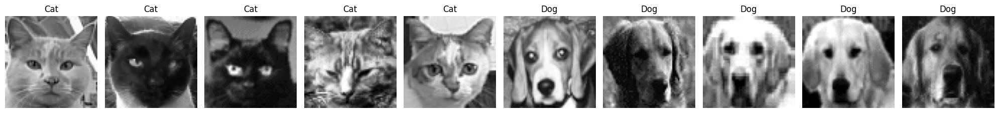

In [8]:
CATSnDOGS = data_df.to_numpy()
Labels = labels_df.to_numpy().flatten()

ssc = np.random.choice(np.where(Labels == 0)[0], 5, replace=False)  # Select 5 samples of label 0 (cat)
ssd = np.random.choice(np.where(Labels == 1)[0], 5, replace=False)  # Select 5 samples of label 1 (dog)

fig, axs = plt.subplots(1, 10, figsize=(20, 6))  # Create a 1x10 grid for displaying images

for i, idx in enumerate(np.concatenate([ssc, ssd])):
    img_matrix = CATSnDOGS[idx, :].reshape(64, 64)  # Reshape flat array to 64x64 matrix
    axs[i].imshow(img_matrix, cmap='gray')  # Directly display the reshaped image
    label = "Dog" if Labels[idx] == 1 else "Cat"
    axs[i].set_title(label)
    axs[i].axis('off')

plt.tight_layout()
plt.show()

### 1.3 Checking for Mislabeling in the Data

There seems to be mislabeled data so we print all the images along with their labels and then correct the mislabeled ones.

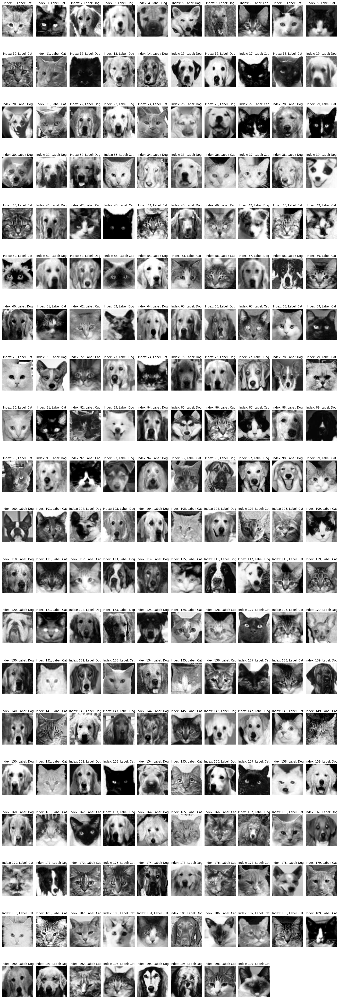

In [9]:
num_images = len(CATSnDOGS)
num_cols = 10  # Set the number of columns per row
num_rows = (num_images + num_cols - 1) // num_cols  # Calculate the required number of rows

# Create a figure with the required number of subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 3 * num_rows))

# Iterate over all images and plot them
for i in range(num_images):
    row = i // num_cols
    col = i % num_cols

    # Get the corresponding subplot
    ax = axs[row, col] if num_rows > 1 else axs[col]

    # Reshape the flat array to a 64x64 matrix
    img_matrix = CATSnDOGS[i, :].reshape(64, 64)

    # Display the image
    ax.imshow(img_matrix, cmap='gray')

    # Set the title as the label ("Dog" or "Cat") and the index
    label = "Dog" if Labels[i] == 1 else "Cat"
    ax.set_title(f"Index: {i}, Label: {label}")

    # Remove the axis ticks
    ax.axis('off')

# Remove any empty subplots if the total number of images is not a perfect multiple of num_cols
if num_images % num_cols != 0:
    for j in range(num_images, num_rows * num_cols):
        fig.delaxes(axs.flatten()[j])

# Adjust the layout and display the figure
plt.tight_layout()
plt.show()


In [10]:
#number of cats and dogs
num_zeros = len(y) - np.count_nonzero(y)
print(f"Number of cats is: {num_zeros}\nNumber of dogs is: {np.count_nonzero(y)}")

Number of cats is: 99
Number of dogs is: 99


### 1.4 Scaling the Data

* Support Vector Machines (SVM) and k-nearest neighbors (KNN) can perform poorly if the features are not scaled because they rely on distances between data points.

* Logistic regression often uses gradient descent or other optimization algorithms to find the best parameters (weights) for the model. When features are on different scales, the gradient descent path can become skewed, making it harder and potentially slower for the optimization algorithm to converge to the minimum loss.

In [11]:
# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

## Section 2.
### 2.1 Hyperparameter Tuning

The models used for classification of cats and dogs: 
* kNN
* Logistic Regression
* SVM
* Random Forest
* xgBoost

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Parameter grids for GridSearchCV
param_grid = {
    "KNN": {'n_neighbors': [3, 5, 7, 9,11], 'weights': ['uniform', 'distance']},
    "Logistic Regression": {'C': np.logspace(-3, 3, 7), 'solver': ['liblinear', 'lbfgs']},
    "SVM": {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']},
    "Random Forest": {'n_estimators': [10, 50, 100, 200], 'max_depth': [None, 10, 20, 30], 'min_samples_split': [2, 5, 10]},
    "Xgb": {'n_estimators': [10, 50, 100, 200],'max_depth': [0, 5, 10, 15]}
}

# Initialize classifiers
classifiers = {
    "KNN": KNeighborsClassifier(),
    "Logistic Regression": LogisticRegression(),
    "SVM": SVC(),
    "Random Forest": RandomForestClassifier(),
    "Xgb": xgb.XGBClassifier(eval_metric = 'logloss')
}

best_estimators = {}
# Conduct GridSearchCV
for name, clf in classifiers.items():
    grid_search = GridSearchCV(clf, param_grid[name], cv=5, scoring='accuracy', n_jobs=-1)
    grid_search.fit(X_train, y_train)
    best_estimators[name] = grid_search.best_estimator_
    print(f"Best parameters for {name}: {grid_search.best_params_}")


Best parameters for KNN: {'n_neighbors': 3, 'weights': 'uniform'}
Best parameters for Logistic Regression: {'C': 0.001, 'solver': 'liblinear'}
Best parameters for SVM: {'C': 10, 'kernel': 'rbf'}
Best parameters for Random Forest: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 100}
Best parameters for Xgb: {'max_depth': 0, 'n_estimators': 100}


### 2.2 Test Accuracy Performance - Default Hyperparameters

In [13]:
# Train and evaluate the classifiers with default parameters
default_accuracies = {}
for name, clf in classifiers.items():
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    default_accuracies[name] = accuracy_score(y_test, y_pred)
    print(f"Default accuracy for {name}: {default_accuracies[name]}")

Default accuracy for KNN: 0.8
Default accuracy for Logistic Regression: 0.825
Default accuracy for SVM: 0.85
Default accuracy for Random Forest: 0.85
Default accuracy for Xgb: 0.825


### 2.3 Test Accuracy Performance - After Hyperparameter Tuning

In [14]:
# Train and evaluate the classifiers with the best parameters from GridSearchCV
tuned_accuracies = {}
for name, clf in best_estimators.items():
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    tuned_accuracies[name] = accuracy_score(y_test, y_pred)
    print(f"Tuned accuracy for {name}: {tuned_accuracies[name]}")

Tuned accuracy for KNN: 0.775
Tuned accuracy for Logistic Regression: 0.8
Tuned accuracy for SVM: 0.875
Tuned accuracy for Random Forest: 0.825
Tuned accuracy for Xgb: 0.825


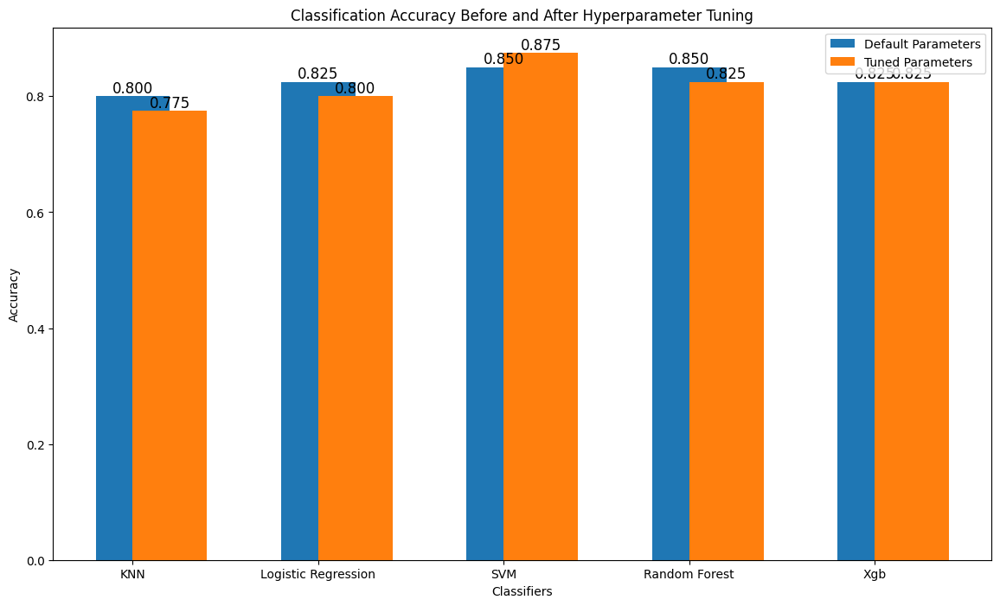

In [15]:
# Plotting the accuracies before and after tuning
labels = list(default_accuracies.keys())
default_values = list(default_accuracies.values())
tuned_values = list(tuned_accuracies.values())

x = range(len(labels))

plt.figure(figsize=(14, 8))
bars1 = plt.bar(x, default_values, width=0.4, label='Default Parameters', align='center')
bars2 = plt.bar(x, tuned_values, width=0.4, label='Tuned Parameters', align='edge')
plt.xlabel('Classifiers')
plt.ylabel('Accuracy')
plt.title('Classification Accuracy Before and After Hyperparameter Tuning')
plt.xticks(x, labels)
plt.legend()

# Adding the accuracy values on top of the bars
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.3f}', ha='center', va='bottom', fontsize=12)

for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.3f}', ha='center', va='bottom', fontsize=12)

plt.show()

##### Comparison of Test Accuracy Performance

* KNN:
The tuning process did decrease the accuracy which could indicate that the default parameter are already well-suited to the data or that the tuned parameters over-fitted the training data.

* Logistic Regression:
Similar to KNN, tune parameters slightly decreased the accuracy. LR is typically a robust model with default parameters, and the changes could have introduced slight over-fitting.

* SVM
The tuning process did tend to improve the accuracy of the model. SVM benefits from careful tuning

* Random Forest:
Tuning process decreased accuracy, possibly over-fitting during tuning process.

* XGBoost:
Tuning process didn't change accuracy, suggesting that the default parameters were already well-suited for the data, or the parameter grid used for tuning was not broad enough.


**General Observation:**
The accuracies were consistently high across the models, illustrating that the classes are reasonably well-separated in the dataset.

### 2.4 Images Consistently Misclassified

Evaluating KNN...


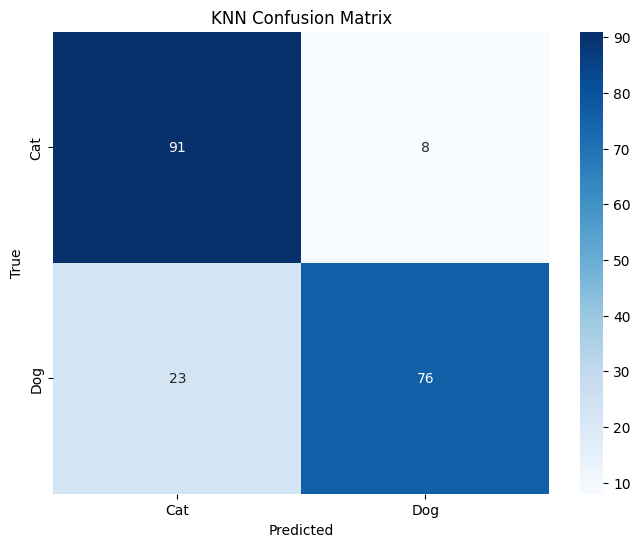

KNN class-wise errors: [ 8 23]
KNN consistently mislabeled images: [20, 25, 34, 35, 39, 47, 53, 57, 61, 63, 67, 69, 71, 77, 78, 85, 89, 102, 103, 107, 125, 113, 129, 145, 147, 158, 169, 171, 178, 185, 186]
KNN Number of misclassified cats: 8
KNN Number of misclassified dogs: 23
KNN Precision: 0.85
KNN Recall: 0.84
KNN F1 Score: 0.84

Evaluating Logistic Regression...


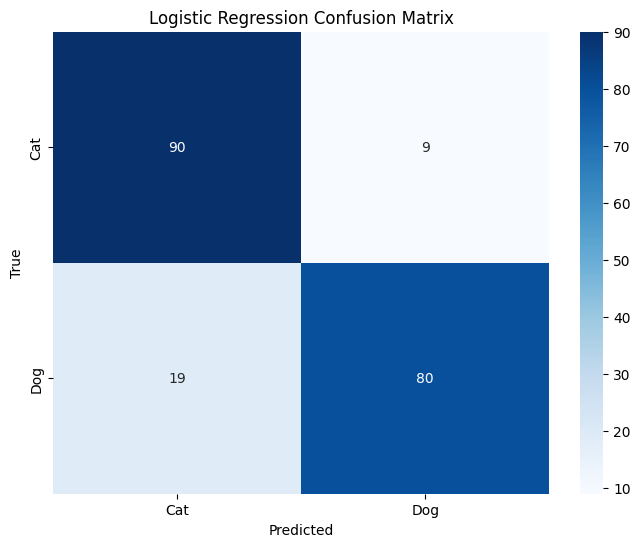

Logistic Regression class-wise errors: [ 9 19]
Logistic Regression consistently mislabeled images: [12, 14, 21, 26, 29, 34, 47, 58, 69, 71, 78, 85, 88, 90, 93, 98, 113, 124, 129, 133, 139, 168, 158, 170, 171, 174, 180, 197]
Logistic Regression Number of misclassified cats: 9
Logistic Regression Number of misclassified dogs: 19
Logistic Regression Precision: 0.86
Logistic Regression Recall: 0.86
Logistic Regression F1 Score: 0.86

Evaluating SVM...


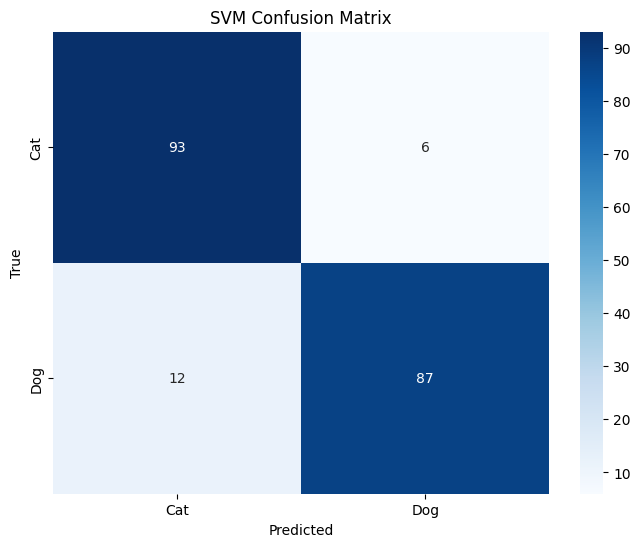

SVM class-wise errors: [ 6 12]
SVM consistently mislabeled images: [47, 58, 63, 69, 71, 81, 78, 85, 90, 93, 98, 103, 107, 113, 158, 170, 171, 197]
SVM Number of misclassified cats: 6
SVM Number of misclassified dogs: 12
SVM Precision: 0.91
SVM Recall: 0.91
SVM F1 Score: 0.91

Evaluating Random Forest...


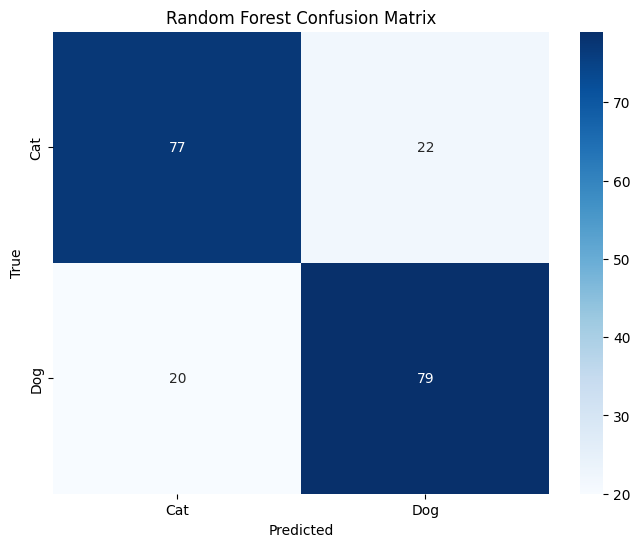

Random Forest class-wise errors: [22 20]
Random Forest consistently mislabeled images: [12, 21, 33, 39, 50, 53, 58, 69, 79, 80, 78, 85, 89, 90, 93, 98, 107, 108, 127, 113, 116, 122, 124, 130, 132, 136, 137, 139, 140, 143, 144, 155, 161, 162, 165, 168, 158, 170, 171, 176, 183, 192]
Random Forest Number of misclassified cats: 22
Random Forest Number of misclassified dogs: 20
Random Forest Precision: 0.79
Random Forest Recall: 0.79
Random Forest F1 Score: 0.79

Evaluating XGBoost...


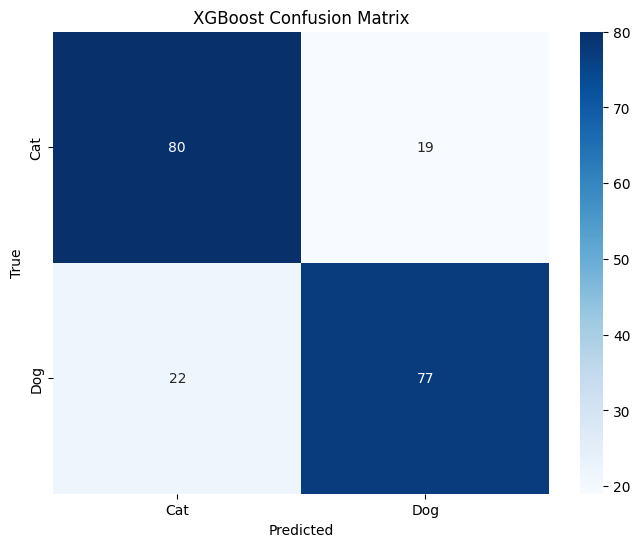

XGBoost class-wise errors: [19 22]
XGBoost consistently mislabeled images: [12, 14, 33, 39, 50, 53, 58, 71, 73, 79, 78, 85, 90, 93, 98, 100, 102, 103, 107, 127, 113, 124, 130, 131, 132, 133, 137, 139, 140, 143, 151, 155, 165, 168, 158, 170, 171, 179, 183, 192, 197]
XGBoost Number of misclassified cats: 19
XGBoost Number of misclassified dogs: 22
XGBoost Precision: 0.79
XGBoost Recall: 0.79
XGBoost F1 Score: 0.79



In [16]:
from sklearn.model_selection import StratifiedKFold
from collections import defaultdict

# Define your classifiers
classifiers = {
    "KNN": KNeighborsClassifier(n_neighbors=3, weights='uniform'),
    "Logistic Regression": LogisticRegression(C=0.001, solver='liblinear'),
    "SVM": SVC(kernel='rbf', C=10),
    "Random Forest": RandomForestClassifier(n_estimators=50, max_depth=None, min_samples_split=10, random_state=42, n_jobs=-1),
    "XGBoost": xgb.XGBClassifier(n_estimators=100, max_depth=5, eval_metric='logloss', random_state=42, n_jobs=-1)
}

def evaluate_classifier(name, clf, X, y):
    skf = StratifiedKFold(n_splits=5)
    misclassified_indices = defaultdict(int)
    y_true_all = np.array([])
    y_pred_all = np.array([])

    for train_index, test_index in skf.split(X, y):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        
        clf.fit(X_train, y_train)
        y_pred = clf.predict(X_test)

        y_true_all = np.append(y_true_all, y_test)
        y_pred_all = np.append(y_pred_all, y_pred)

        fold_misclassified = test_index[y_test != y_pred]
        for idx in fold_misclassified:
            misclassified_indices[idx] += 1

    cm = confusion_matrix(y_true_all, y_pred_all)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Cat', 'Dog'], yticklabels=['Cat', 'Dog'])
    plt.title(f'{name} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()
    
    # Count errors
    class_errors = cm.sum(axis=1) - np.diag(cm)
    
    # Count misclassified cats and dogs
    misclassified_cats = sum((y[list(misclassified_indices.keys())] == 0))
    misclassified_dogs = sum((y[list(misclassified_indices.keys())] == 1))
    
    # Calculate precision, recall, and F1 score
    precision = precision_score(y_true_all, y_pred_all, average='weighted')
    recall = recall_score(y_true_all, y_pred_all, average='weighted')
    f1 = f1_score(y_true_all, y_pred_all, average='weighted')
    
    results = {
        "class_errors": class_errors,
        "misclassified_indices": list(misclassified_indices.keys()),
        "misclassified_cats": misclassified_cats,
        "misclassified_dogs": misclassified_dogs,
        "precision": precision,
        "recall": recall,
        "f1": f1
    }
    
    return results

# Perform evaluation for each classifier
evaluation_results = {}
for name, clf in classifiers.items():
    print(f"Evaluating {name}...")
    results = evaluate_classifier(name, clf, X, y)
    evaluation_results[name] = results
    print(f"{name} class-wise errors: {results['class_errors']}")
    print(f"{name} consistently mislabeled images: {results['misclassified_indices']}")
    print(f"{name} Number of misclassified cats: {results['misclassified_cats']}")
    print(f"{name} Number of misclassified dogs: {results['misclassified_dogs']}")
    print(f"{name} Precision: {results['precision']:.2f}")
    print(f"{name} Recall: {results['recall']:.2f}")
    print(f"{name} F1 Score: {results['f1']:.2f}\n")

#### 2.4.1 Summary of Metrics Across the Models

The performance metrics across all the models show variation, and some classifiers perform better for certain classes than others. Here are the aggregated metrics for each classifier:

**KNN:**
- **Overall:**
  - Precision: 0.85
  - Recall: 0.84
  - F1-Score: 0.84
- **Class-wise Errors:** [8, 23]

**LR (Logistic Regression):**
- **Overall:**
  - Precision: 0.86
  - Recall: 0.86
  - F1-Score: 0.86
- **Class-wise Errors:** [9, 19]

**SVM (Support Vector Machine):**
- **Overall:**
  - Precision: 0.91
  - Recall: 0.91
  - F1-Score: 0.91
- **Class-wise Errors:** [6, 12]

**RF (Random Forest):**
- **Overall:**
  - Precision: 0.79
  - Recall: 0.79
  - F1-Score: 0.79
- **Class-wise Errors:** [22, 20]

**XGB (XGBoost):**
- **Overall:**
  - Precision: 0.79
  - Recall: 0.79
  - F1-Score: 0.79
- **Class-wise Errors:** [19, 22]

- **Precision:** SVM shows the highest precision, suggesting a lower false positive rate overall.
- **Recall:** SVM also shows the highest recall, indicating a lower false negative rate overall.
- **F1-Score:** SVM has the highest F1-Score, suggesting a better balance between precision and recall.


Different models show varied abilities in classifying the classes. For example:
- **SVM** tends to perform better overall with the highest precision, recall, and F1-score.
- **KNN** and **Logistic Regression** show good performance but are slightly lower than SVM.
- **RF** and **XGB** show balanced performance but are lower than KNN, Logistic Regression, and SVM.

This analysis suggests that the choice of classifier can significantly impact the performance outcomes, particularly in handling false positives and negatives across different classes.

#### 2.4.2 Understanding Differences in Classifier Performance

The performance of machine learning models like KNN, SVM, RandomForest, XGBoost, and Logistic Regression can vary due to several factors related to the models' characteristics and the data they are trained on. Here's an analysis of potential reasons why these differences might occur:

##### 1. Model Complexity and Type
- **SVM (Support Vector Machine)**: SVMs are effective in high-dimensional spaces and when the classes are clearly separable by a margin. Its higher performance (precision, recall, F1) suggests that the feature space allows for clear margins between cats and dogs.
- **Random Forest and XGBoost**: These ensemble models that use decision trees can handle non-linear data well. However, if the data contains a lot of noise, or if these models are not adequately tuned (e.g., tree depth, number of trees), their performance might lag behind more robust classifiers like SVM. XGBoost, showing the lowest scores, might also suffer from overfitting if the hyperparameters are not set correctly.
- **KNN (K-Nearest Neighbors)**: KNN's effectiveness heavily depends on the choice of 'k' and the distance metric used. Its relatively balanced performance could be affected by noise in the dataset, as KNN can be sensitive to outliers in the training data.
- **Logistic Regression**: This model performs well when the decision boundary between classes is linear. Its performance suggests that while the boundary might not be perfectly linear (as indicated by higher performance in SVM), it's still a viable model for this classification task.

##### 2. Data Quality and Quantity
- **Imbalance in Data**: If there are significantly more examples of one class in the training data, models might develop a bias toward that class, resulting in higher misclassifications of the minority class. The variation in misclassification between cats and dogs across models could indicate such imbalances.
- **Feature Relevance**: The effectiveness of features in distinguishing between classes greatly affects model performance. Poor feature selection can lead to lower performance metrics, as seen with XGBoost and Random Forest in this scenario.
- **Noise and Outliers**: Models like KNN and sometimes decision tree-based models (like RandomForest and XGBoost) can be sensitive to noise and outliers. Their performance can degrade if the data quality isn't managed properly.

##### 3. Model Tuning and Training Techniques
- **Hyperparameter Tuning**: The extent of tuning model parameters such as learning rate, number of neighbors (KNN), depth of trees (RandomForest, XGBoost), or regularization strength (Logistic Regression) can result in significant performance differences.
- **Training Procedures**: Techniques like cross-validation, feature scaling (particularly important for SVM and KNN), and proper splitting of training and test data also play critical roles in the effectiveness of a model.

##### 4. Model Specific Strengths and Weaknesses
- **SVM** is known for its robustness in finding the optimal hyperplane and handling high-dimensional data, which might explain its superior performance.
- **Ensemble Methods (Random Forest, XGBoost)** generally perform well on complex datasets by reducing variance and bias but require careful tuning to prevent overfitting.
- **KNN** is simple and effective but often does not perform well when the dataset is large or contains a lot of noise.
- **Logistic Regression** is easy to implement and interpret but can be limited by its assumption of linearity between the dependent variable and the independent variables.

##### Conclusion
The choice of model depends not only on the model’s mathematical foundations but also significantly on the characteristics of the data, the preprocessing steps undertaken, and how well the model's parameters are tuned to the specific case. Understanding these aspects can help in choosing the right model and tuning it for optimal performance.


#### 2.4.3 Visualizing the Misclassified Images

In [17]:
import matplotlib.pyplot as plt

def plot_misclassified_images(indices, title):
    num_images = len(indices)
    num_cols = 5
    num_rows = (num_images // num_cols) + (num_images % num_cols > 0)
    
    plt.figure(figsize=(15, 3 * num_rows))
    for i, idx in enumerate(indices):
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(X[idx].reshape(64, 64), cmap='gray')
        plt.axis('off')
        plt.title(f'Index: {idx}')
    plt.suptitle(title)
    plt.show()

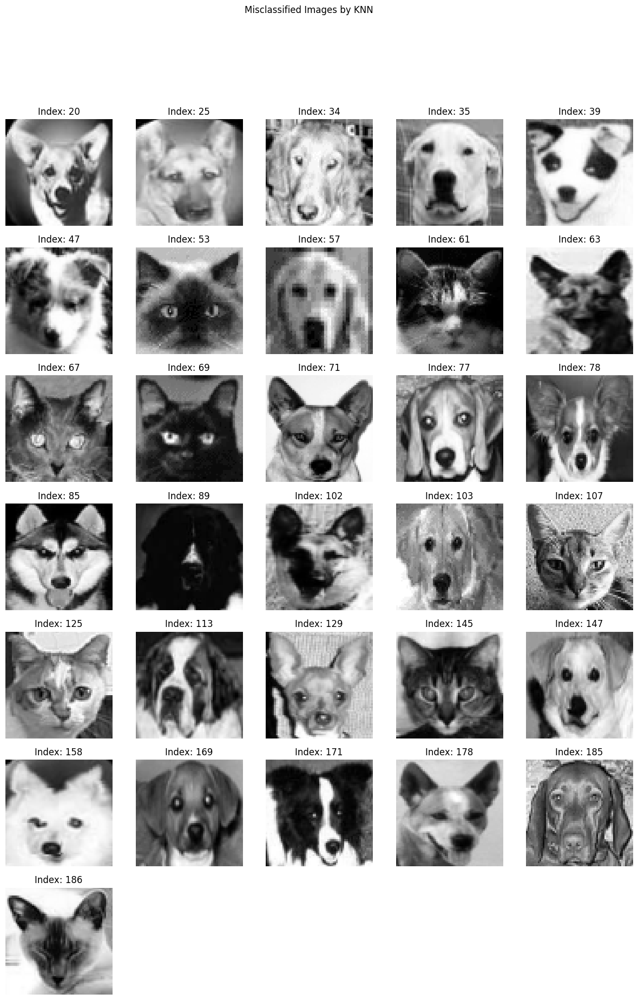

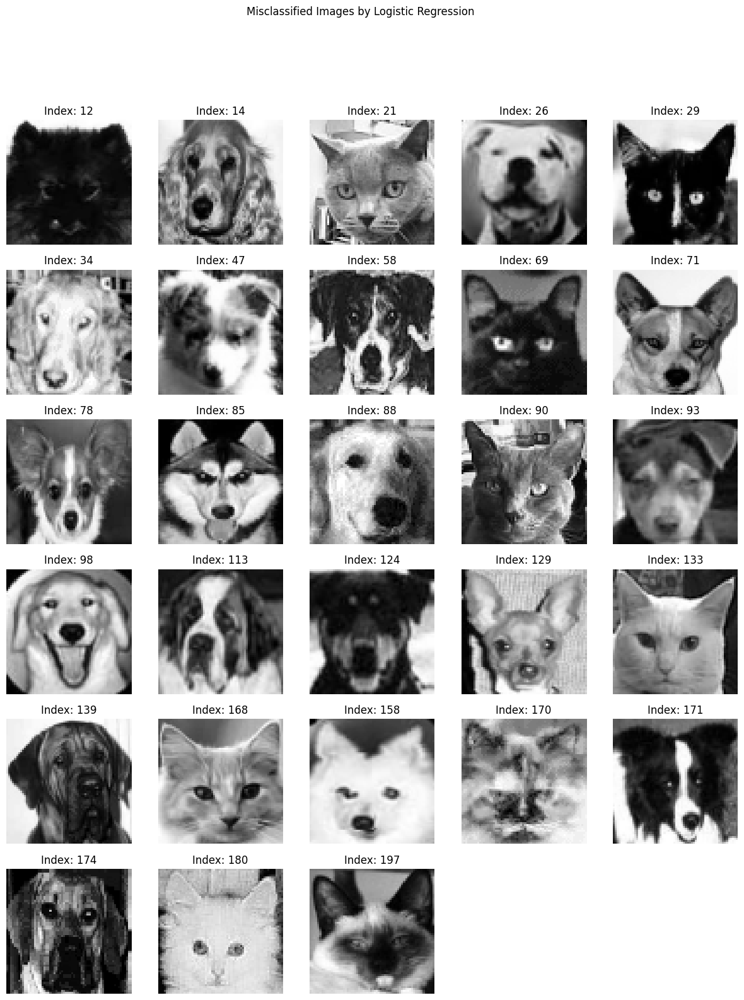

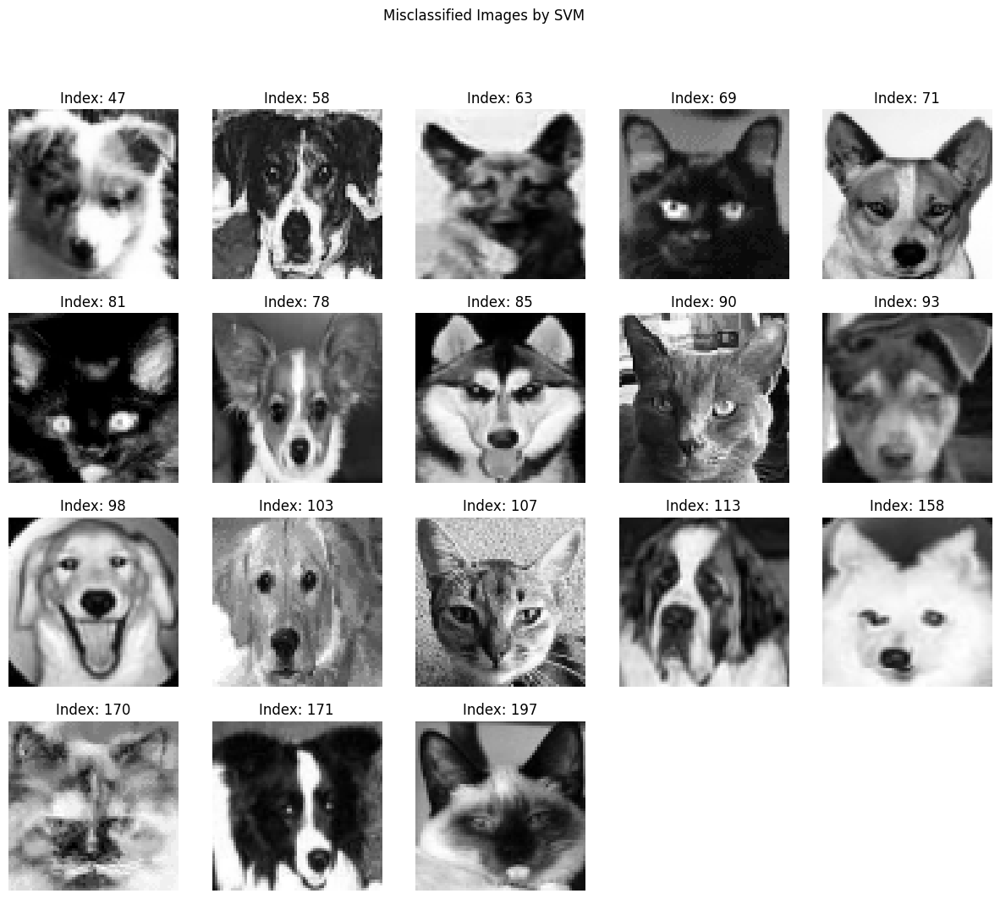

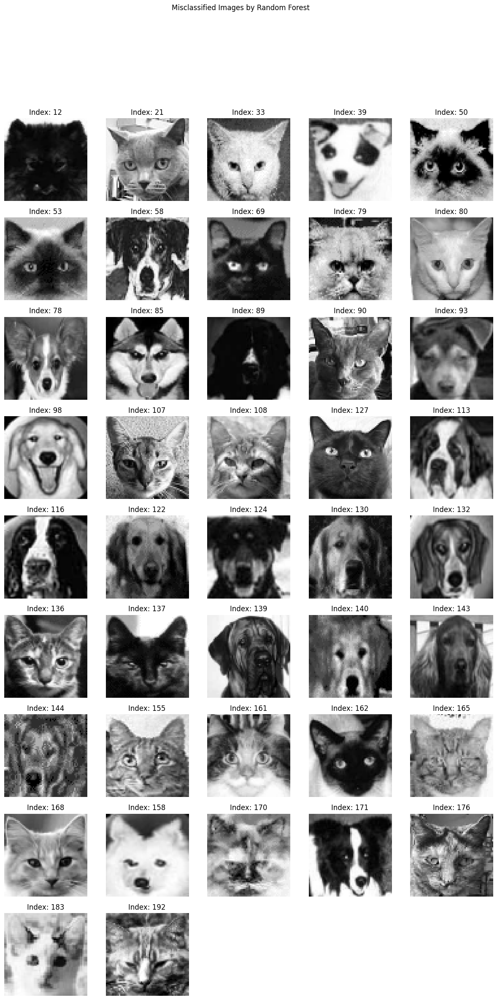

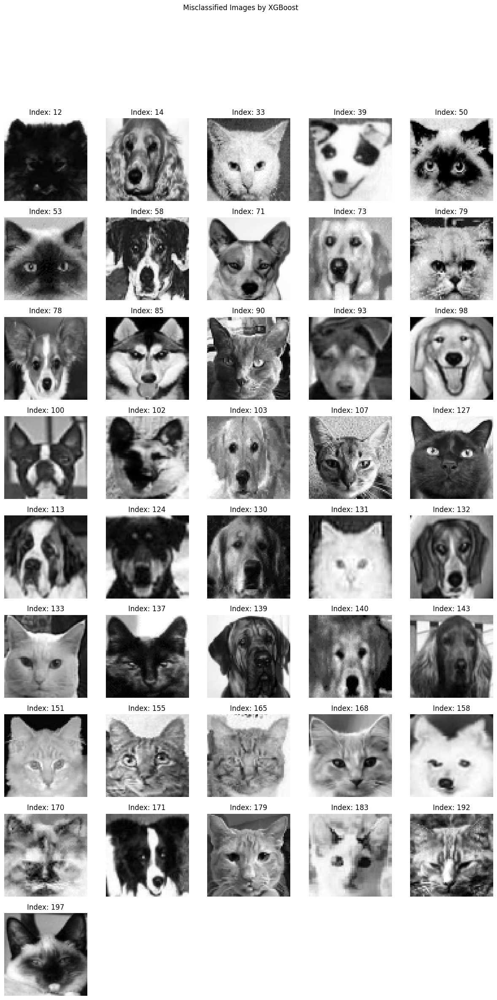

In [18]:
# Display misclassified images for each classifier
for name, results in evaluation_results.items():
    plot_misclassified_images(results['misclassified_indices'], f'Misclassified Images by {name}')

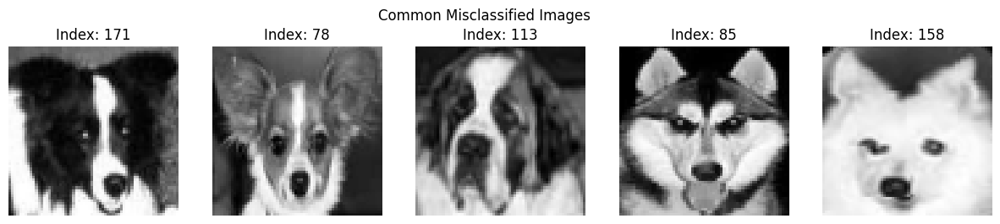

Common misclassified images: [171, 78, 113, 85, 158]
Number of common misclassified cats: 0
Number of common misclassified dogs: 5


In [19]:
# Identify common misclassified images
common_misclassified = list(set.intersection(*map(set, [results['misclassified_indices'] for results in evaluation_results.values()])))
plot_misclassified_images(common_misclassified, 'Common Misclassified Images')

# Print the indices of common misclassified images
print(f"Common misclassified images: {common_misclassified}")

# Count misclassified cats and dogs in common misclassified images
common_misclassified_cats = sum((y[common_misclassified] == 0))
common_misclassified_dogs = sum((y[common_misclassified] == 1))

print(f"Number of common misclassified cats: {common_misclassified_cats}")
print(f"Number of common misclassified dogs: {common_misclassified_dogs}")

#### 2.4.4 Difficulty in Classification -  Justification

##### 1. Why do we think that these images are difficult to classifiy ?

* Ambiguous Features: The misclassified images actually show dogs that have features that could be mistaken for either cats or a different breed of dog. For example, the dogs have varying fur patterns and the facial structures like the "pointy" ears and gap between ears that confuse the classifier

* Low Resolution: 64 x 64 pixels are low resolution images, which means that finer details that could help in classifying between dogs and cats are lost.

##### 2. Do the classifiers struggle with the same observations ?

Yes, the classifiers do struggle with the same observations. This is quite evident as the same set of images (as shown above) were misclassified by multiple classifiers. This shows that these specific images present particular challenges that impact all the classifiers used in the analysis. Specify more

##### 3. Are the errors balanced or is one class more difficult to classifiy correctly ?

The errors are not balanced, from the above analysis:
* Number of common misclassified cats: 0
* Number of common misclassifier dogs: 5

All the commonly misclassified images are of dogs, implying that dogs are more difficult to classify correctly than cats. The imbalance suggests that the classifiers are having a hard time identifying and distinguishing between different breeds of dogs compared to cats. 

**Specify the misclassification for each clasisifer**

## Section 3.

Determining the most important pixels for classification using ANOVA

### 3.1 Filter Based Feature Selection - ANOVA Test

In [20]:
from sklearn.feature_selection import f_classif

# Apply ANOVA F-test to each feature
f_values, p_values = f_classif(X_scaled, Labels)

# Display the first few F-values and p-values to understand the results
print("F-values:", f_values[:10])
print("P-values:", p_values[:10])


F-values: [2.07723657 0.86223688 0.35561153 0.29964106 0.20906114 0.40582704
 0.50174947 0.35112266 0.57187222 0.26022707]
P-values: [0.15110637 0.3542556  0.55164174 0.58473029 0.64801065 0.52483855
 0.47957399 0.55416132 0.45042386 0.61053817]


#### 3.1.1 Selecting Important Features

In [21]:
# Set a threshold for p-values
p_value_threshold = 0.05

# Select features with p-values below the threshold
important_features_indices = np.where(p_values < p_value_threshold)[0]
print("Number of important features:", len(important_features_indices))

Number of important features: 1875


#### 3.1.2 Visualizing the Important Features

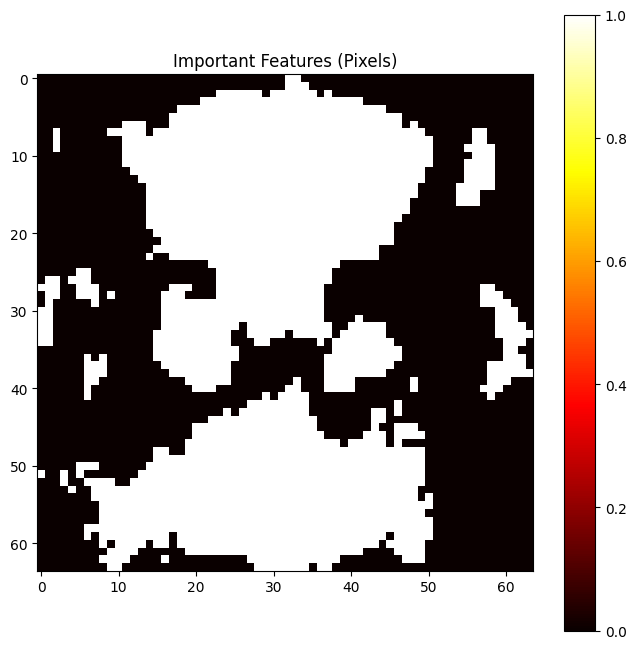

In [22]:
# Create an empty grid of 64x64
important_features_grid = np.zeros((64, 64))

# Mark important features in the grid
for index in important_features_indices:
    row = index // 64
    col = index % 64
    important_features_grid[row, col] = 1

# Plot the grid
plt.figure(figsize=(8, 8))
plt.imshow(important_features_grid, cmap='hot', interpolation='nearest')
plt.title('Important Features (Pixels)')
plt.colorbar()
plt.show()

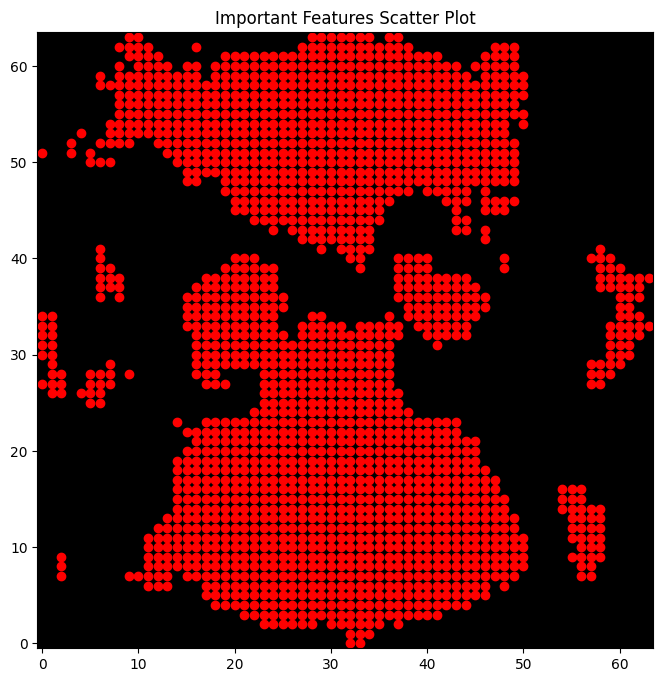

In [23]:
plt.figure(figsize=(8, 8))
plt.imshow(np.zeros((64, 64)), cmap='gray', interpolation='nearest')  # Blank image for background
for index in important_features_indices:
    row = index // 64
    col = index % 64
    plt.scatter(col, row, color='red')
plt.title('Important Features Scatter Plot')
plt.gca().invert_yaxis()
plt.show()

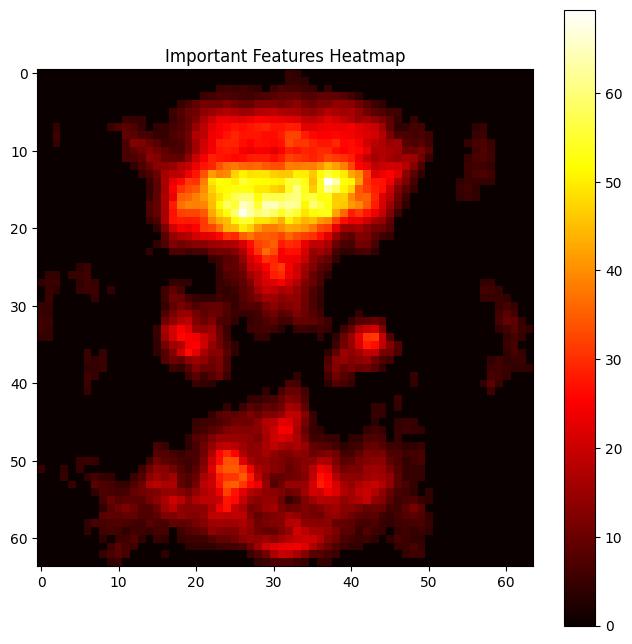

In [24]:
# Create a grid of 64x64 for feature importance
feature_importance_grid = np.zeros((64, 64))

# Populate the grid with F-values of important features
for index in important_features_indices:
    row = index // 64
    col = index % 64
    feature_importance_grid[row, col] = f_values[index]

# Plot the heatmap
plt.figure(figsize=(8, 8))
plt.imshow(feature_importance_grid, cmap='hot', interpolation='nearest')
plt.title('Important Features Heatmap')
plt.colorbar()
plt.show()

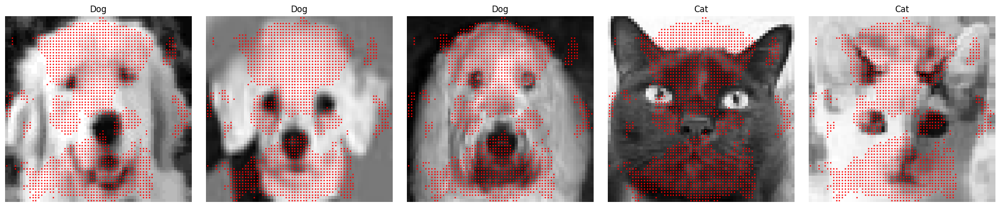

In [25]:
# Select a few sample images
sample_indices = np.random.choice(range(X.shape[0]), 5, replace=False)

fig, axs = plt.subplots(1, 5, figsize=(20, 4))
for i, idx in enumerate(sample_indices):
    img_matrix = CATSnDOGS[idx, :].reshape(64, 64)
    axs[i].imshow(img_matrix, cmap='gray')
    for index in important_features_indices:
        row = index // 64
        col = index % 64
        axs[i].scatter(col, row, color='red', s=1)
    label = "Dog" if Labels[idx] == 1 else "Cat"
    axs[i].set_title(label)
    axs[i].axis('off')
plt.tight_layout()
plt.show()

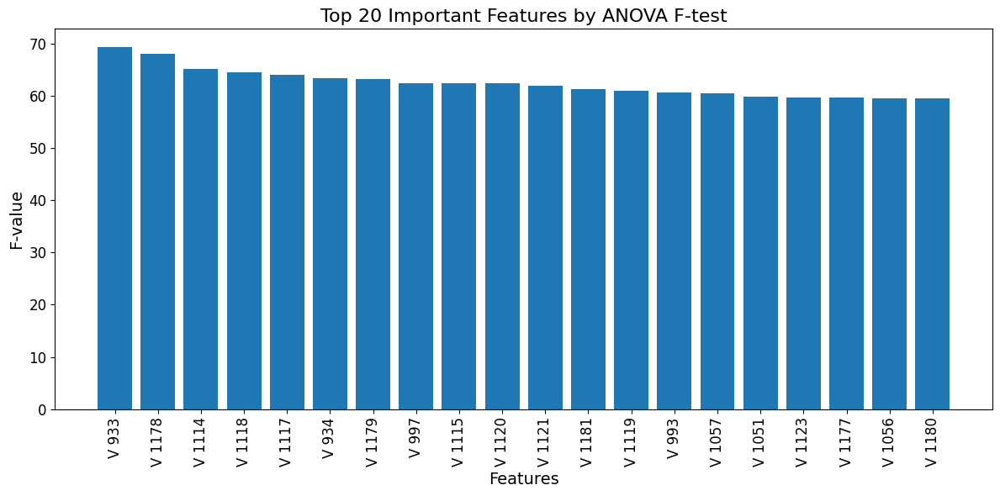

In [26]:
# Sort features by their F-values in descending order
sorted_indices = np.argsort(f_values)[::-1]

# Select the top 20 features
top_20_indices = sorted_indices[:20]
top_20_f_values = f_values[top_20_indices]
top_20_p_values = p_values[top_20_indices]

# Create labels for the features (optional)
feature_labels = [f'V {i}' for i in top_20_indices]

# Plot the top 20 features
plt.figure(figsize=(12, 6))
plt.bar(range(20), top_20_f_values, tick_label=feature_labels)
plt.xlabel('Features', fontsize=14)
plt.ylabel('F-value', fontsize=14)
plt.title('Top 20 Important Features by ANOVA F-test', fontsize=16)
plt.xticks(rotation=90, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

### 3.2 Wrapper Method Feature Selection

In [27]:
from sklearn.model_selection import StratifiedKFold
from sklearn.inspection import permutation_importance

# Define your classifiers
classifiers = {
    "KNN": KNeighborsClassifier(n_neighbors=3, weights='uniform'),
    "SVM": SVC(kernel='rbf', C=10),
    "Random Forest": RandomForestClassifier(n_estimators=50, max_depth=None, min_samples_split=10, random_state=42, n_jobs=-1),
    "XGBoost": xgb.XGBClassifier(n_estimators=100, max_depth=5, eval_metric='logloss', random_state=42, n_jobs=-1)
}

# Initialize stratified k-fold cross-validation
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Dictionary to store feature importances for each classifier
feature_importances = {name: np.zeros(X.shape[1]) for name in classifiers.keys()}

# Perform stratified k-fold cross-validation and compute permutation importances
for train_index, test_index in skf.split(X, y):
    X_train, X_test = X_scaled[train_index], X_scaled[test_index]
    y_train, y_test = y[train_index], y[test_index]
    
    for name, clf in classifiers.items():
        clf.fit(X_train, y_train)
        result = permutation_importance(clf, X_test, y_test, n_repeats=10, random_state=42, n_jobs=-1)
        feature_importances[name] += result.importances_mean

# Average the feature importances over the folds
for name in feature_importances:
    feature_importances[name] /= skf.get_n_splits()

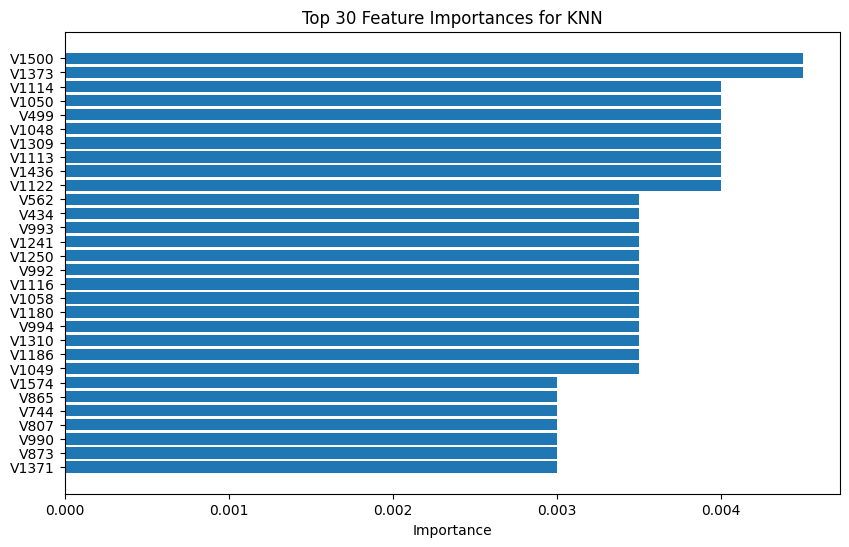

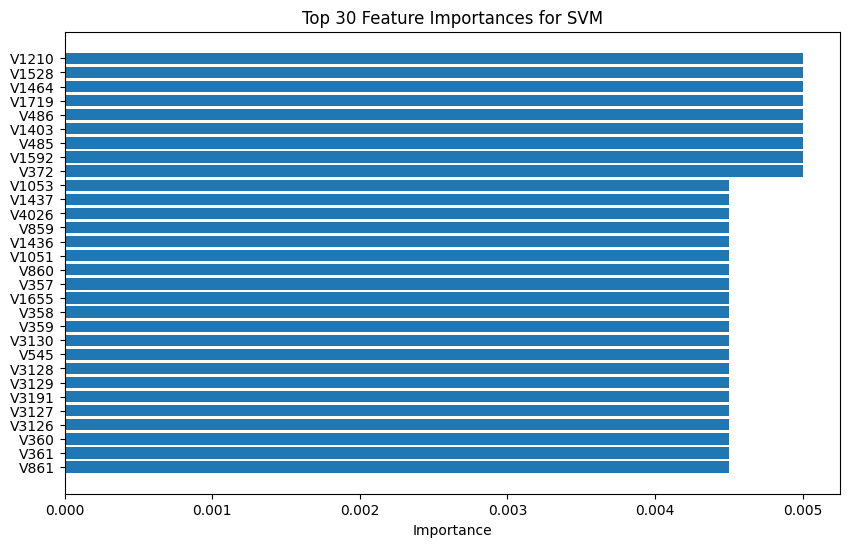

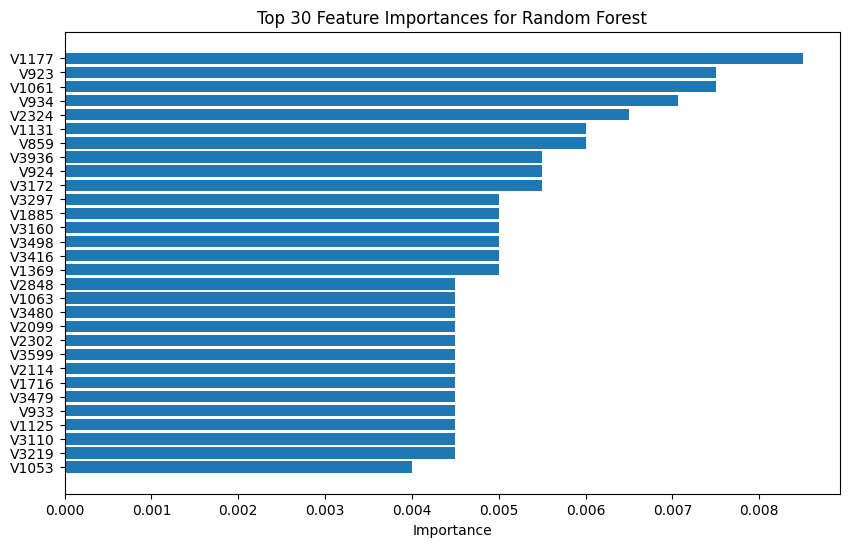

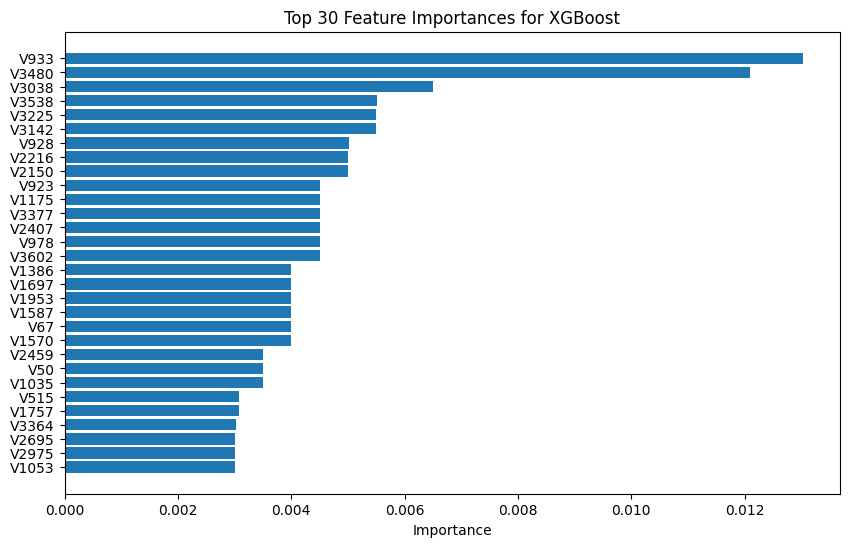

In [28]:
# If X is a numpy array, convert it to a DataFrame with prefixed column names
if isinstance(X, np.ndarray):
    X = pd.DataFrame(X, columns=[f"V{i}" for i in range(X.shape[1])])

# Convert to DataFrame for easier plotting
feature_importance_df = {name: pd.DataFrame({'feature': X.columns, 'importance': importance}) for name, importance in feature_importances.items()}

# Plotting the top 30 feature importances for each classifier
for name, df in feature_importance_df.items():
    df = df.sort_values(by='importance', ascending=False).head(30)  # Get top 30 features
    plt.figure(figsize=(10, 6))
    plt.barh(df['feature'], df['importance'])
    plt.xlabel('Importance')
    plt.title(f'Top 30 Feature Importances for {name}')
    plt.gca().invert_yaxis()
    plt.show()

### 3.3 Embedded Methods - Lasso, Ridge and Elastic Net

#### 3.3.1 Lasso Method

In [29]:
from sklearn.linear_model import LassoCV
from sklearn.preprocessing import StandardScaler

alphas = np.logspace(-4,0,50)

# Fit the LassoCV model
lasso_cv = LassoCV(alphas=None, cv=5, random_state=0, max_iter = 50000)
lasso_cv.fit(X_scaled, Labels)

# Get the best alpha found by cross-validation
best_alpha = lasso_cv.alpha_
print("Best alpha:", best_alpha)

# Fit the Lasso model with the best alpha
lasso = Lasso(alpha=best_alpha)
lasso.fit(X_scaled, Labels)

# Get the coefficients from the Lasso model
lasso_coefficients = lasso.coef_

# Display the first few coefficients to understand the results
print("Lasso coefficients:", lasso_coefficients[:10])


Best alpha: 0.02223794843904712
Lasso coefficients: [-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]


In [30]:
important_features = np.where(lasso_coefficients != 0)[0]
print("Number of important features:", len(important_features))
print("Indices of important features:", important_features)

Number of important features: 62
Indices of important features: [  64  127  246  277  387  514  588  752  877  887  933  950  952 1032
 1078 1121 1129 1158 1169 1188 1304 1458 1459 1523 1570 1594 1694 1826
 1839 1902 2141 2197 2215 2218 2219 2342 2343 2468 2528 2544 2598 2746
 2912 3159 3160 3206 3287 3297 3300 3335 3428 3429 3480 3486 3494 3537
 3614 3632 3633 3722 4017 4057]


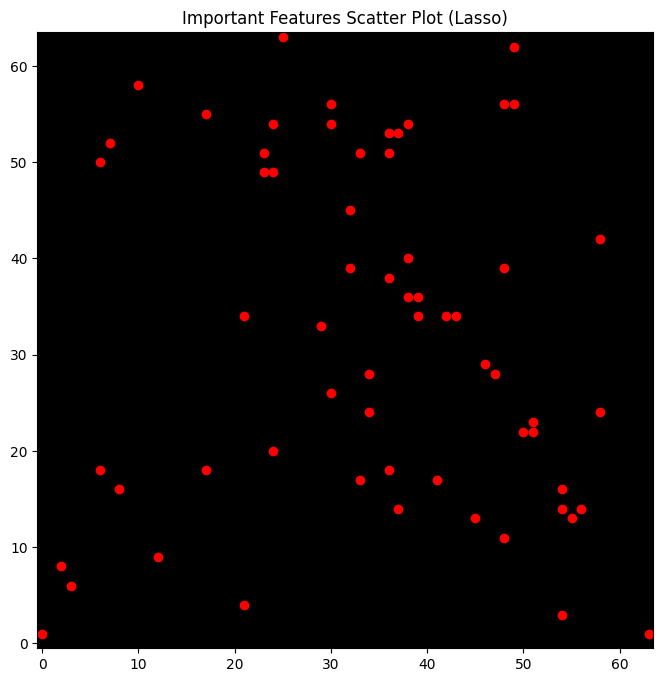

In [31]:
plt.figure(figsize=(8, 8))
plt.imshow(np.zeros((64, 64)), cmap='gray', interpolation='nearest')  # Blank image for background
for index in important_features:
    row = index // 64
    col = index % 64
    plt.scatter(col, row, color='red')
plt.title('Important Features Scatter Plot (Lasso)')
plt.gca().invert_yaxis()
plt.show()


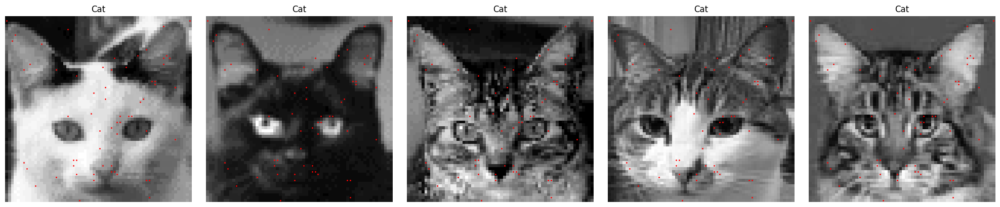

In [32]:
# Select a few sample images
sample_indices = np.random.choice(range(X.shape[0]), 5, replace=False)

fig, axs = plt.subplots(1, 5, figsize=(20, 4))
for i, idx in enumerate(sample_indices):
    img_matrix = CATSnDOGS[idx, :].reshape(64, 64)
    axs[i].imshow(img_matrix, cmap='gray')
    for index in important_features:
        row = index // 64
        col = index % 64
        axs[i].scatter(col, row, color='red', s=1)
    label = "Dog" if Labels[idx] == 1 else "Cat"
    axs[i].set_title(label)
    axs[i].axis('off')
plt.tight_layout()
plt.show()


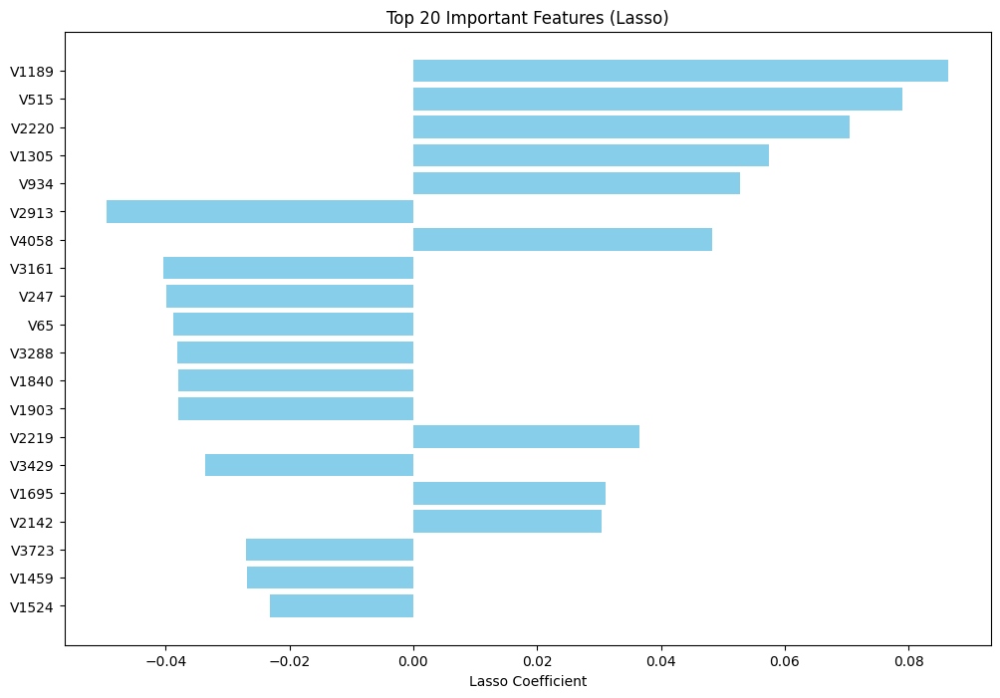

In [33]:
# Number of top features to plot
top_n = 20

# Get the indices of the top N features based on the absolute value of the coefficients
top_n_indices = np.argsort(np.abs(lasso_coefficients))[-top_n:]

# Get the corresponding coefficients and feature indices
top_n_coefficients = lasso_coefficients[top_n_indices]
top_n_features = [f'V{index + 1}' for index in top_n_indices]

# Create a bar plot
plt.figure(figsize=(12, 8))
plt.barh(top_n_features, top_n_coefficients, color='skyblue')
plt.xlabel('Lasso Coefficient')
plt.title('Top 20 Important Features (Lasso)')
plt.show()


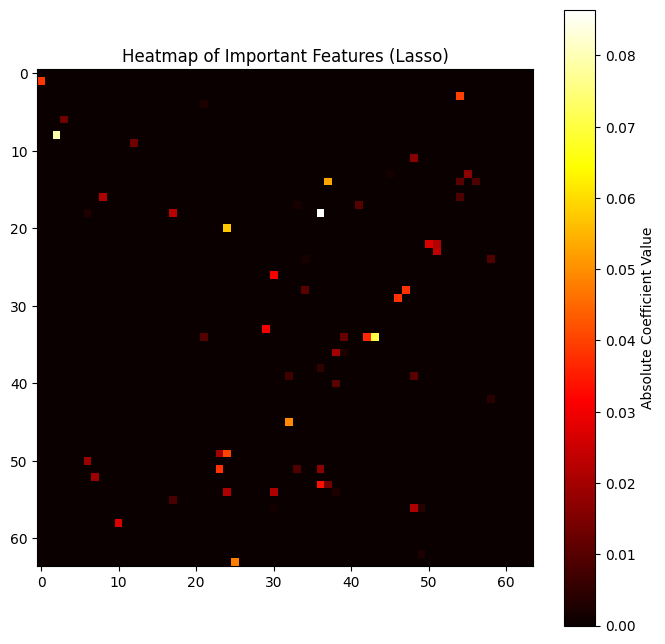

In [34]:
# Reshape the coefficients to the image dimensions for the heatmap
coefficients_image = lasso_coefficients.reshape(64, 64)

# Plot the heatmap
plt.figure(figsize=(8, 8))
plt.imshow(np.abs(coefficients_image), cmap='hot', interpolation='nearest')
plt.colorbar(label='Absolute Coefficient Value')
plt.title('Heatmap of Important Features (Lasso)')
plt.show()

#### 3.3.2 Ridge Method

In [35]:
from sklearn.linear_model import RidgeCV

# Define the range of alpha values to search
alphas = np.logspace(-4, 4, 50)

# Initialize RidgeCV with the range of alphas
ridge_cv = RidgeCV(alphas=alphas, store_cv_values=True)

# Fit the model
ridge_cv.fit(X_scaled, Labels)

# Get the best alpha
best_alpha = ridge_cv.alpha_
print(f"Best alpha: {best_alpha}")


Best alpha: 2222.996482526191


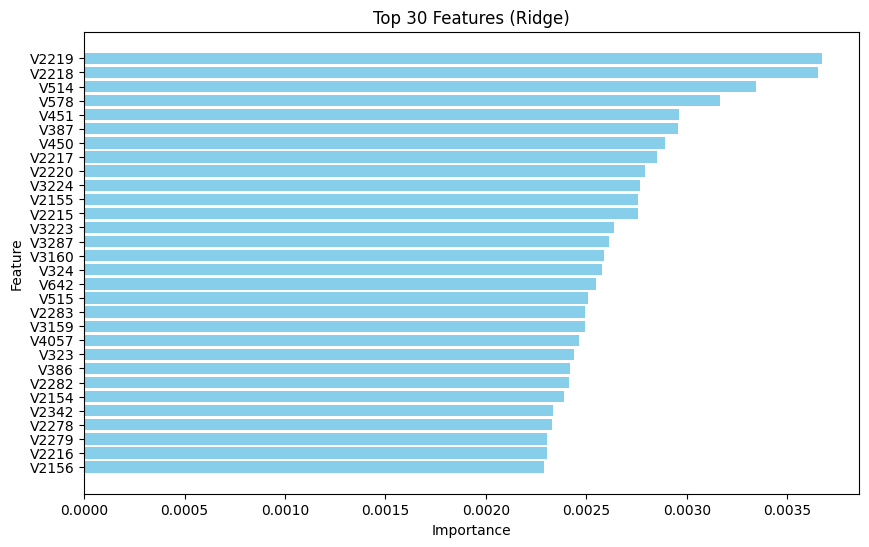

In [79]:
def plot_top_features(coef, feature_names, top_n=10):
    feature_importances = np.abs(coef)
    
    # Modify feature names to the desired format "V<number>"
    feature_names = [f"{feature.split('_')[-1]}" for feature in feature_names]
    
    # Create a DataFrame to sort the features by importance
    features_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)

    # Select the top N features
    top_features_df = features_df.head(top_n)
    
    # Plot the top N features
    plt.figure(figsize=(10, 6))
    plt.barh(top_features_df['Feature'], top_features_df['Importance'], color='skyblue')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f'Top {top_n} Features (Ridge)')
    plt.gca().invert_yaxis()  # Highest importance at the top
    plt.show()

# Get the coefficients (feature importances)
feature_importances = ridge_cv.coef_

# Plot the top features (you can specify the number of top features to display)
plot_top_features(feature_importances, X.columns, top_n=30)


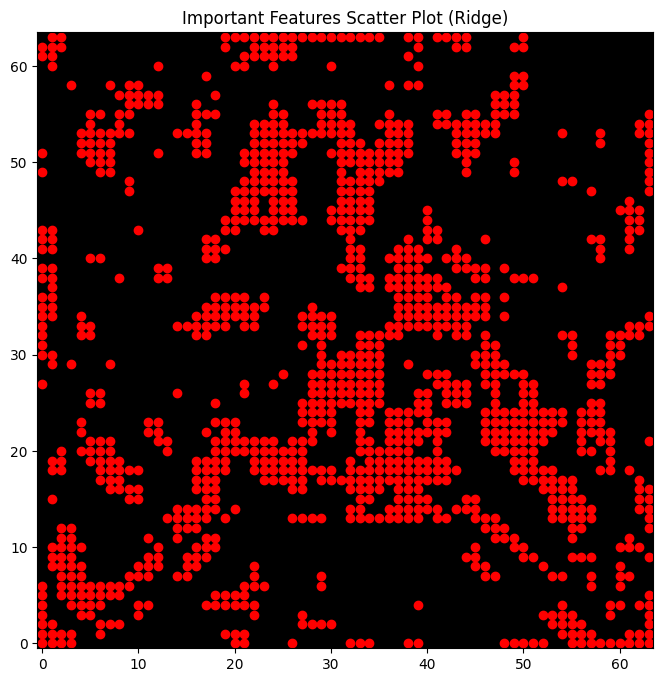

In [37]:
# Get the coefficients (feature importances)
coefficients_ridge = ridge_cv.coef_

# Number of top features to highlight
top_n = 1200  # Adjust this to the number of top features you want to highlight

# Get indices of the top N important features
important_features_indices_ridge = np.argsort(np.abs(coefficients_ridge))[-top_n:]

# Plot the important features on a blank 64x64 image
plt.figure(figsize=(8, 8))
plt.imshow(np.zeros((64, 64)), cmap='gray', interpolation='nearest')  # Blank image for background
for index in important_features_indices_ridge:
    row = index // 64
    col = index % 64
    plt.scatter(col, row, color='red')
plt.title('Important Features Scatter Plot (Ridge)')
plt.gca().invert_yaxis()
plt.show()


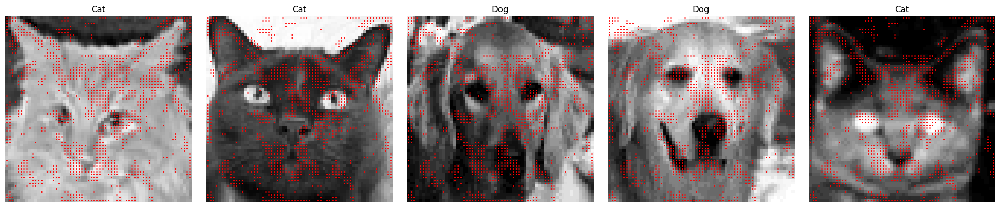

In [38]:
# Select a few sample images
sample_indices = np.random.choice(range(X.shape[0]), 5, replace=False)

fig, axs = plt.subplots(1, 5, figsize=(20, 4))
for i, idx in enumerate(sample_indices):
    img_matrix = CATSnDOGS[idx, :].reshape(64, 64)
    axs[i].imshow(img_matrix, cmap='gray')
    for index in important_features_indices_ridge:
        row = index // 64
        col = index % 64
        axs[i].scatter(col, row, color='red', s=1)
    label = "Dog" if Labels[idx] == 1 else "Cat"
    axs[i].set_title(label)
    axs[i].axis('off')
plt.tight_layout()
plt.show()


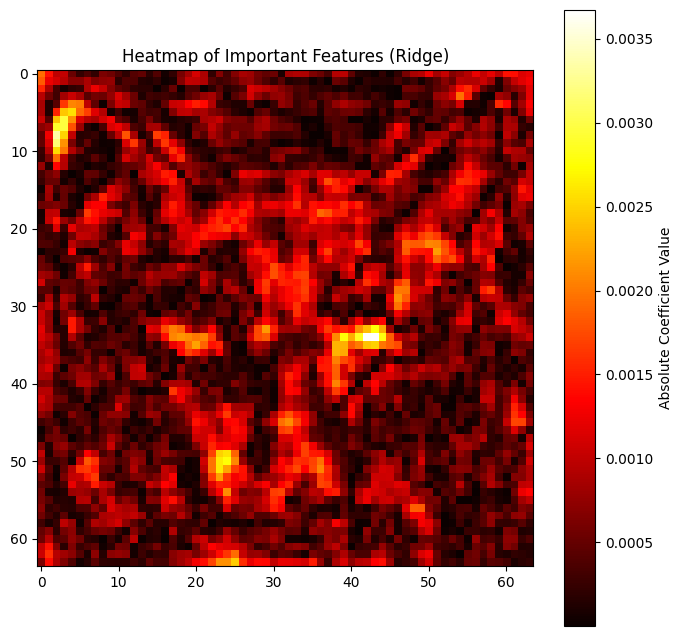

In [39]:
# Reshape the coefficients to the image dimensions for the heatmap
coefficients_image = coefficients_ridge.reshape(64, 64)

# Plot the heatmap
plt.figure(figsize=(8, 8))
plt.imshow(np.abs(coefficients_image), cmap='hot', interpolation='nearest')
plt.colorbar(label='Absolute Coefficient Value')
plt.title('Heatmap of Important Features (Ridge)')
plt.show()

#### 3.3.3 Elastic Net Method

In [40]:
from sklearn.linear_model import ElasticNetCV

# Define the range of alpha and l1_ratio values to search
alphas = np.logspace(-4, 4, 50)
l1_ratios = np.linspace(0.1, 1, 10)

# Initialize ElasticNetCV with the range of alphas and l1_ratios
elastic_net_cv = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=5, max_iter = 50000)

# Fit the model
elastic_net_cv.fit(X_scaled, Labels)

# Get the best alpha and l1_ratio
best_alpha = elastic_net_cv.alpha_
best_l1_ratio = elastic_net_cv.l1_ratio_
print(f"Best alpha: {best_alpha}")
print(f"Best l1_ratio: {best_l1_ratio}")

Best alpha: 0.18420699693267145
Best l1_ratio: 0.1


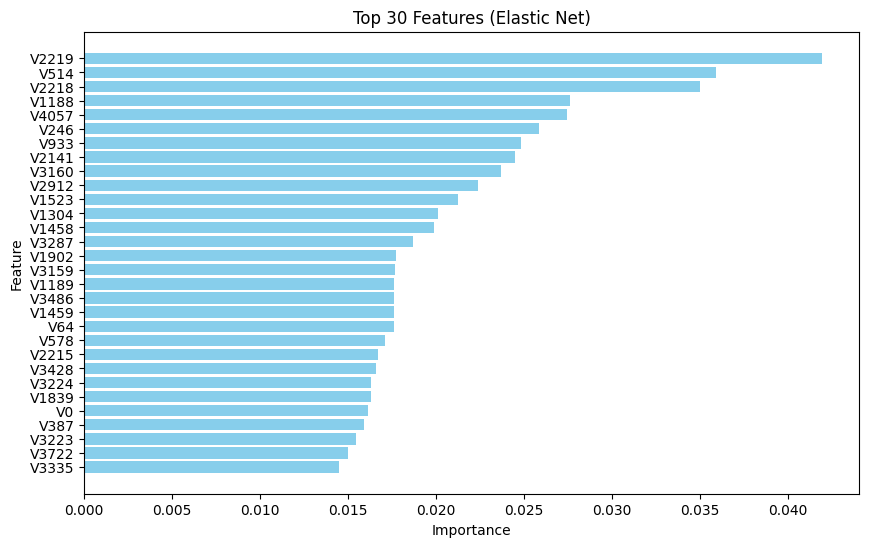

In [80]:
def plot_top_features(coef, feature_names, top_n=10):
    feature_importances = np.abs(coef)
    
    # Modify feature names to the desired format "V<number>"
    feature_names = [f"{feature.split('_')[-1]}" for feature in feature_names]
    
    # Create a DataFrame to sort the features by importance
    features_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)

    # Select the top N features
    top_features_df = features_df.head(top_n)
    
    # Plot the top N features
    plt.figure(figsize=(10, 6))
    plt.barh(top_features_df['Feature'], top_features_df['Importance'], color='skyblue')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f'Top {top_n} Features (Elastic Net)')
    plt.gca().invert_yaxis()  # Highest importance at the top
    plt.show()

# Get the coefficients (feature importances)
feature_importances = elastic_net_cv.coef_

# Plot the top features (you can specify the number of top features to display)
plot_top_features(feature_importances, X.columns, top_n=30)

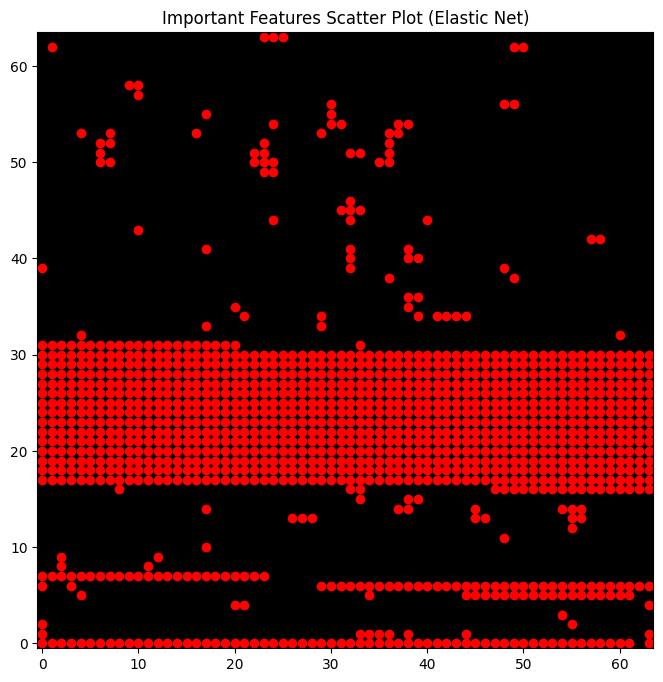

In [42]:
# Get the coefficients (feature importances)
coefficients = elastic_net_cv.coef_

# Number of top features to highlight
top_n = 1200  # Adjust this to the number of top features you want to highlight

# Get indices of the top N important features
important_features_indices = np.argsort(np.abs(coefficients))[-top_n:]

# Plot the important features on a blank 64x64 image
plt.figure(figsize=(8, 8))
plt.imshow(np.zeros((64, 64)), cmap='gray', interpolation='nearest')  # Blank image for background
for index in important_features_indices:
    row = index // 64
    col = index % 64
    plt.scatter(col, row, color='red')
plt.title('Important Features Scatter Plot (Elastic Net)')
plt.gca().invert_yaxis()
plt.show()


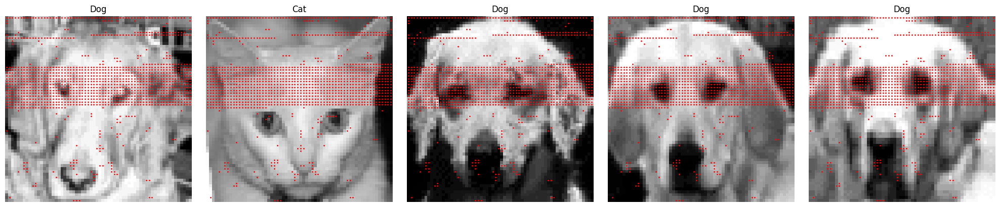

In [43]:
# Select a few sample images
sample_indices = np.random.choice(range(X.shape[0]), 5, replace=False)

fig, axs = plt.subplots(1, 5, figsize=(20, 4))
for i, idx in enumerate(sample_indices):
    img_matrix = CATSnDOGS[idx, :].reshape(64, 64)
    axs[i].imshow(img_matrix, cmap='gray')
    for index in important_features_indices:
        row = index // 64
        col = index % 64
        axs[i].scatter(col, row, color='red', s=1)
    label = "Dog" if Labels[idx] == 1 else "Cat"
    axs[i].set_title(label)
    axs[i].axis('off')
plt.tight_layout()
plt.show()


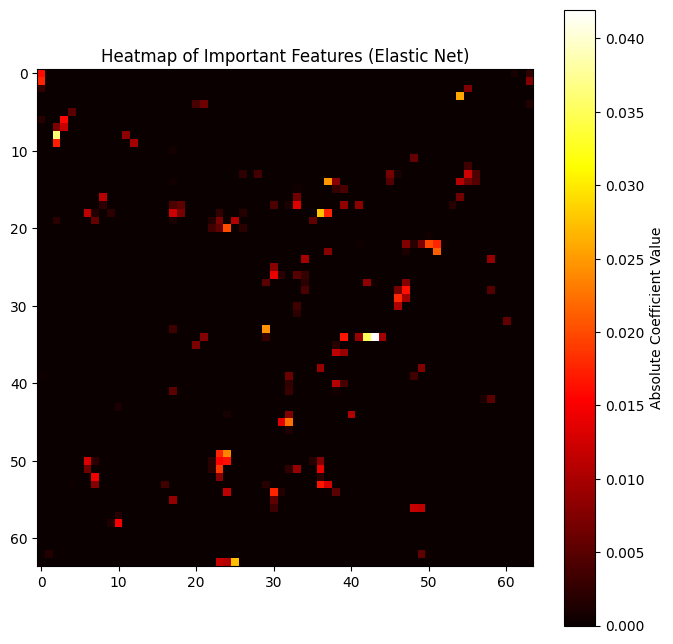

In [44]:
# Reshape the coefficients to the image dimensions for the heatmap
coefficients_image = coefficients.reshape(64, 64)

# Plot the heatmap
plt.figure(figsize=(8, 8))
plt.imshow(np.abs(coefficients_image), cmap='hot', interpolation='nearest')
plt.colorbar(label='Absolute Coefficient Value')
plt.title('Heatmap of Important Features (Elastic Net)')
plt.show()

### 3.4 Answering Questions

#### 3.4.1 Are these features easy to identify or is there uncertainty in the selection of important features ?

* There is considerable uncertainty in feature selection as different methods identify different sets of important features.
* Ovearlapping: Some features are identified as important across multiple methods, which can increase confidence in their importance.
* The importance scores and visualizations indicate relative importance but do not provide absolute certainty.

#### 3.4.2 Can you think of a way to improve on the stability of selection/identification ?

* Combining Multiple Feature Selection Methods: Use an ensemble approach by combining multiple feature selection methods to identify a consensus set of important features.

* Cross-Validation: Implement cross-validation to ensure that the selected features are consistently important across different subsets of the data.

* Bootstrap Aggregation (Bagging): Use bagging to generate multiple datasets from the original data and perform feature selection on each. Aggregate the results to identify stable features.

* Regularization Techniques: Utilize regularization methods like Lasso, Ridge, and Elastic Net to impose constraints and prevent overfitting, thereby improving feature stability.

* Dimensionality Reduction: Apply dimensionality reduction techniques like Principal Component Analysis (PCA) to reduce noise and highlight important features.

* Stability Selection: Implement stability selection methods that repeatedly subsample the data and apply a feature selection algorithm to identify features that are consistently selected.

## Section 4.

### 4.1 Clustering on the Whole Dataset  (Without Pre-Processing)

We use 3 clustering algorithms here: Gaussian Mixture, K-Means and Agglomerative

#### 4.1.1 Gaussian Mixture


GMM with 2 Clusters:


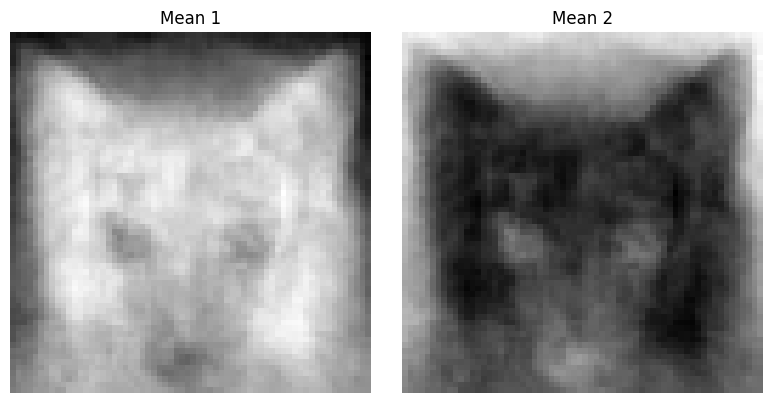

Silhouette Score: 0.131
Adjusted Rand Index (ARI): -0.005

Images in Cluster 1:


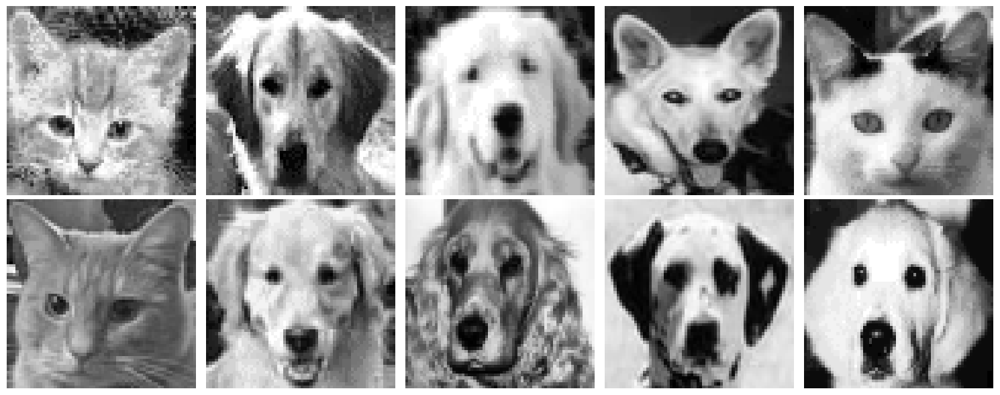


Images in Cluster 2:


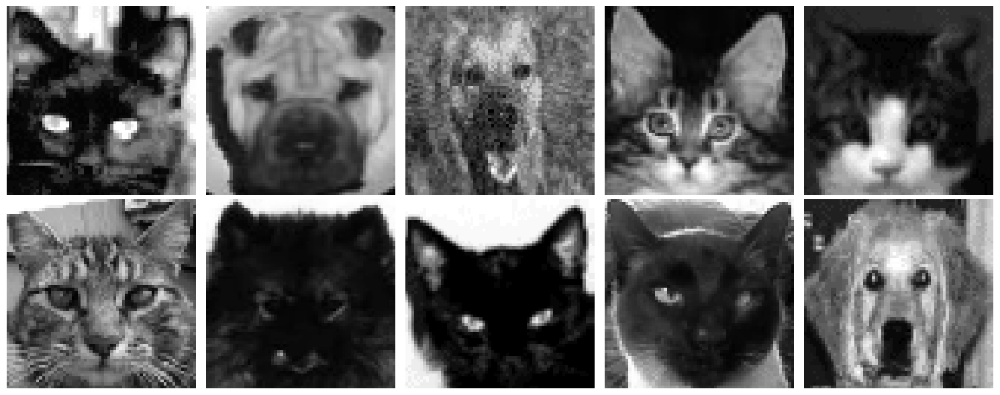

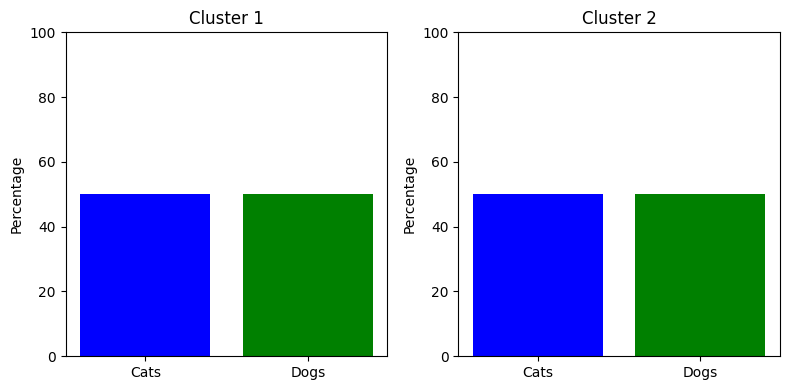


GMM with 3 Clusters:


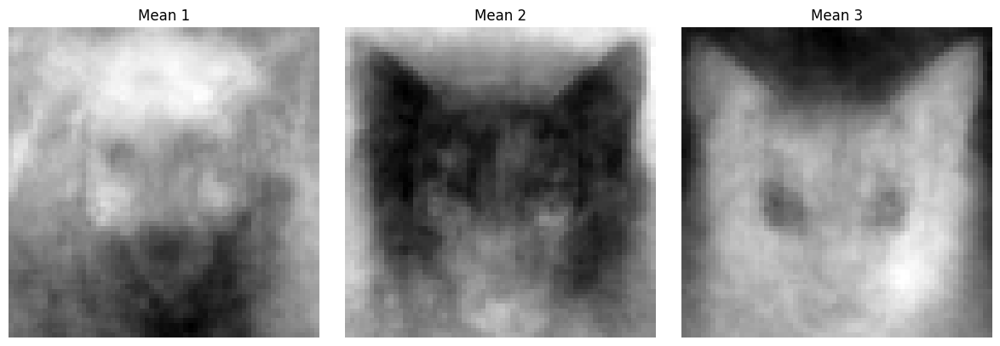

Silhouette Score: 0.084
Adjusted Rand Index (ARI): 0.081

Images in Cluster 1:


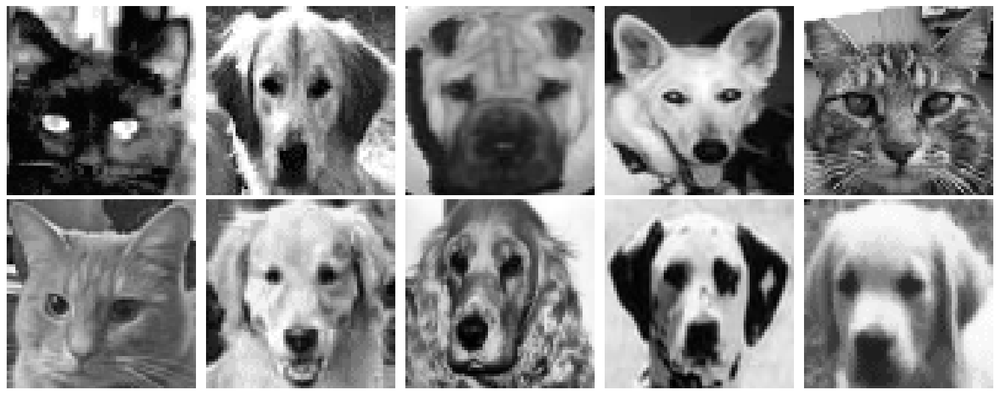


Images in Cluster 2:


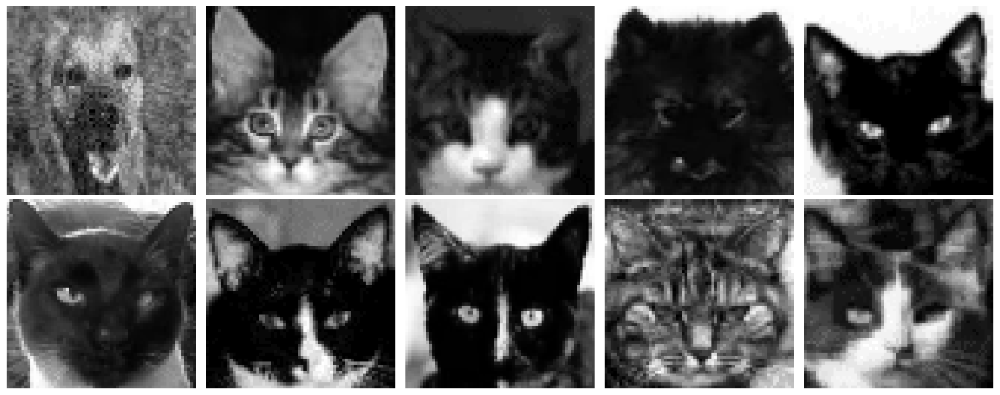


Images in Cluster 3:


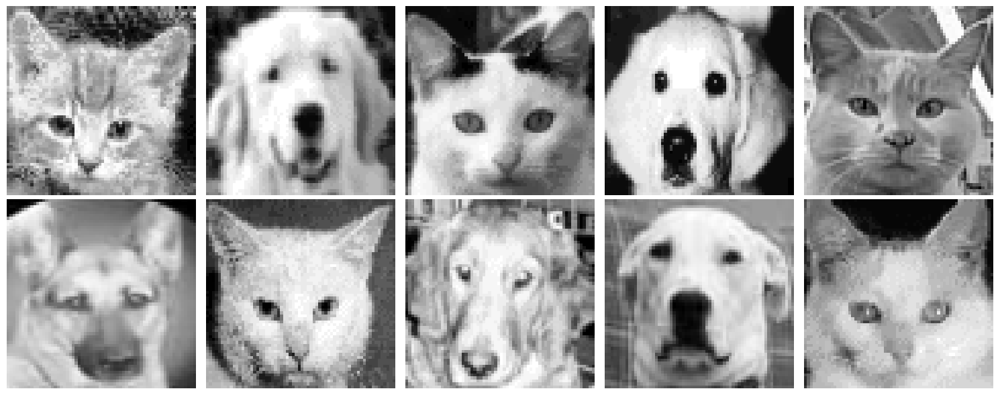

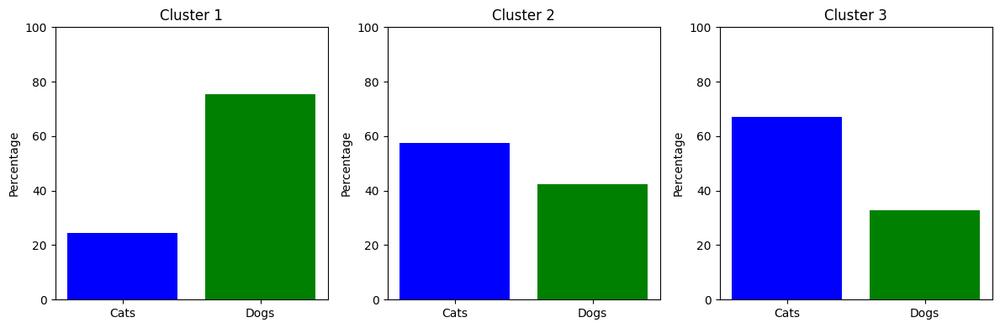


GMM with 4 Clusters:


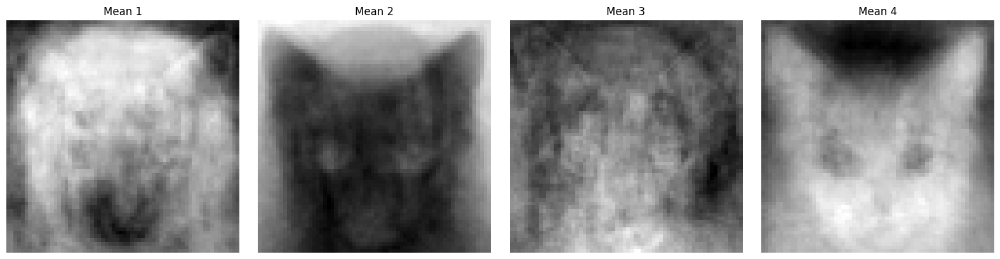

Silhouette Score: 0.081
Adjusted Rand Index (ARI): 0.078

Images in Cluster 1:


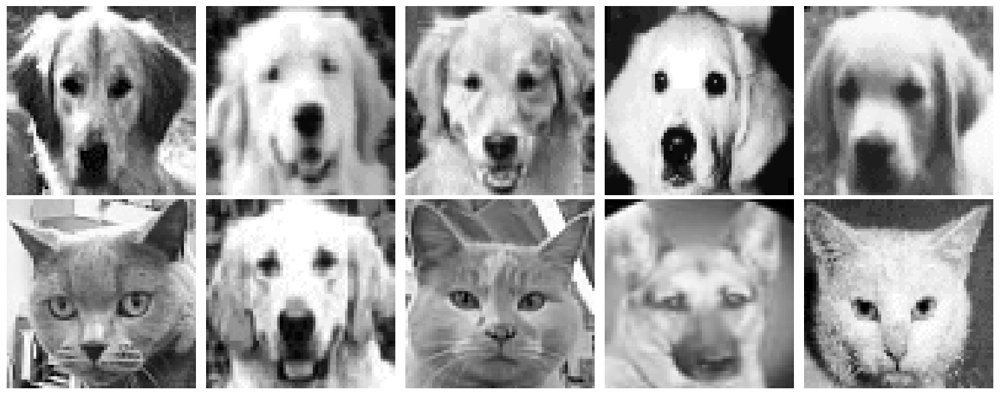


Images in Cluster 2:


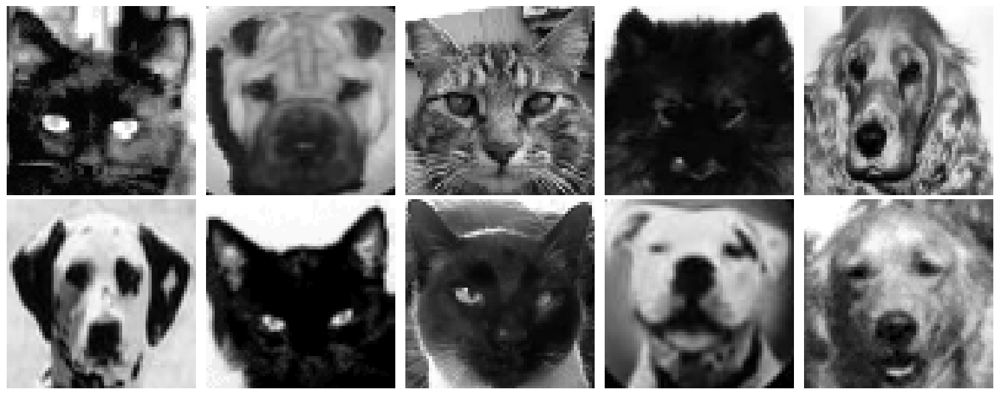


Images in Cluster 3:


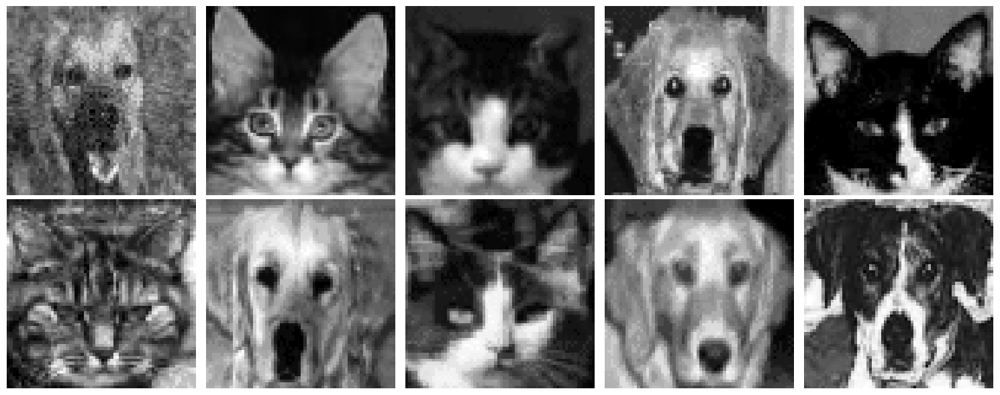


Images in Cluster 4:


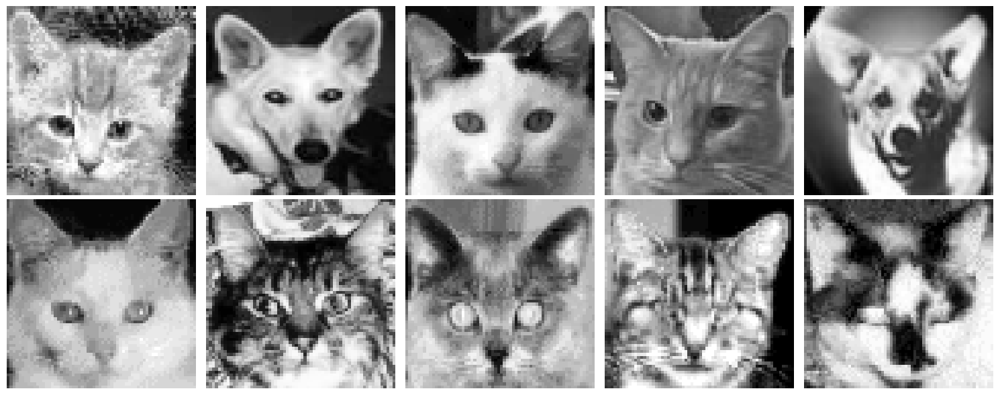

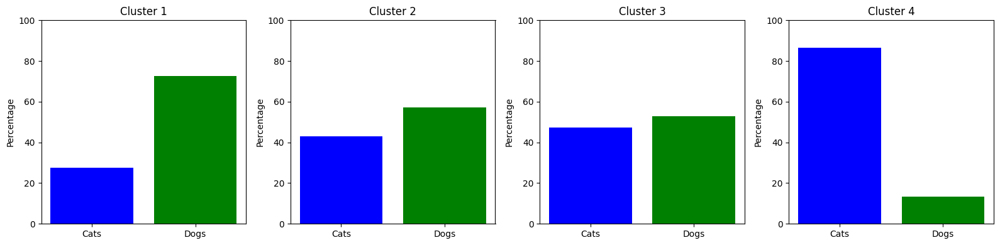


GMM with 5 Clusters:


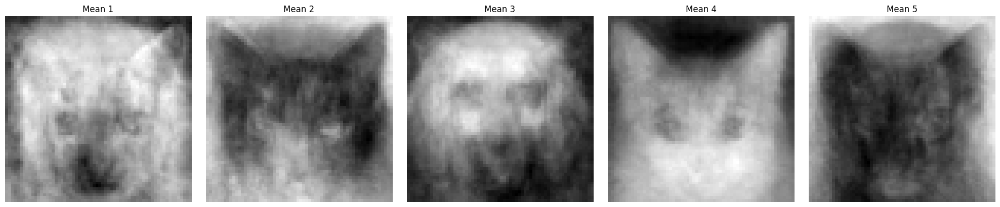

Silhouette Score: 0.082
Adjusted Rand Index (ARI): 0.093

Images in Cluster 1:


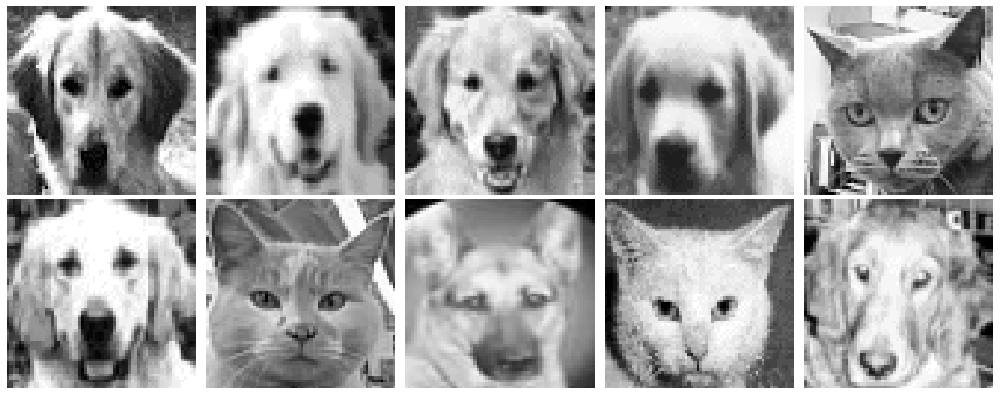


Images in Cluster 2:


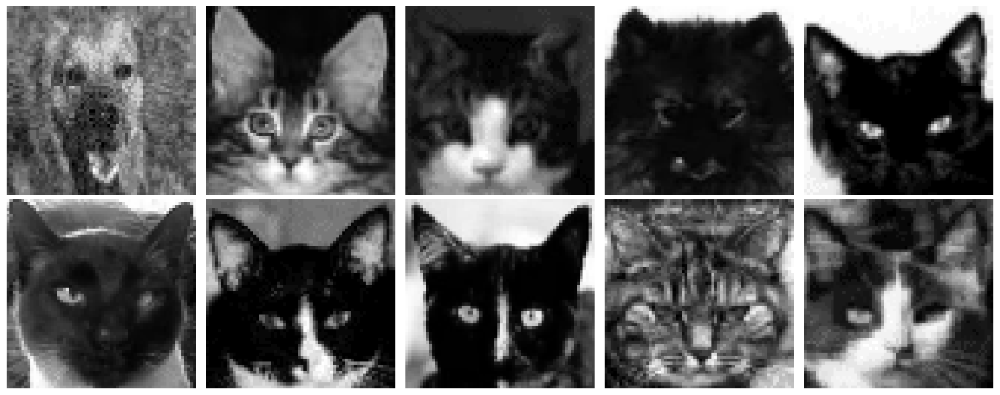


Images in Cluster 3:


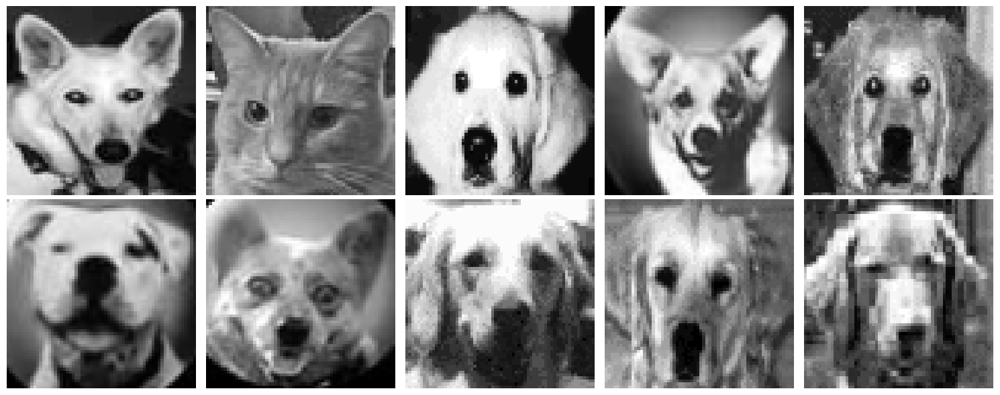


Images in Cluster 4:


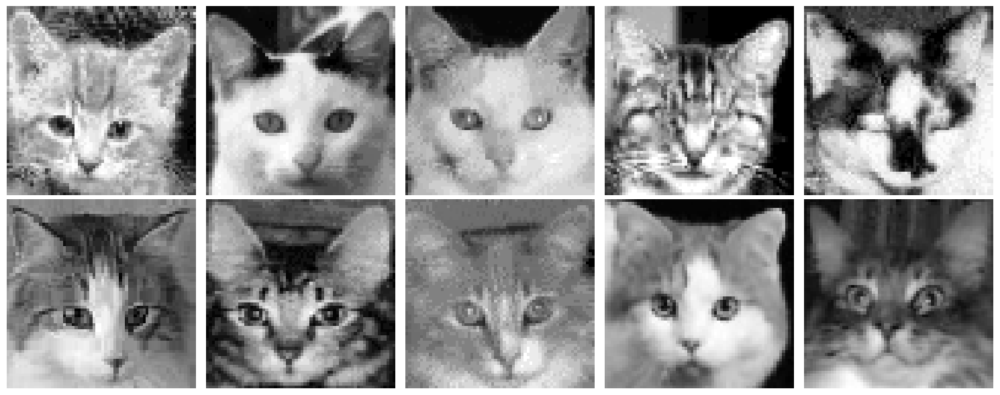


Images in Cluster 5:


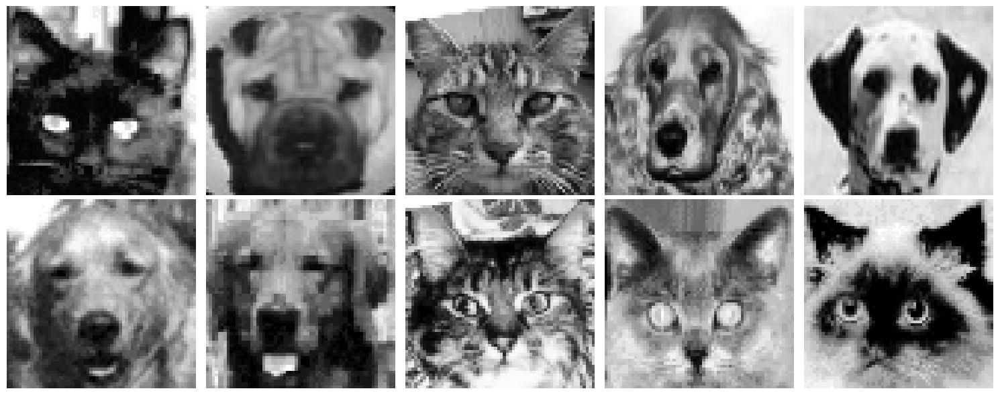

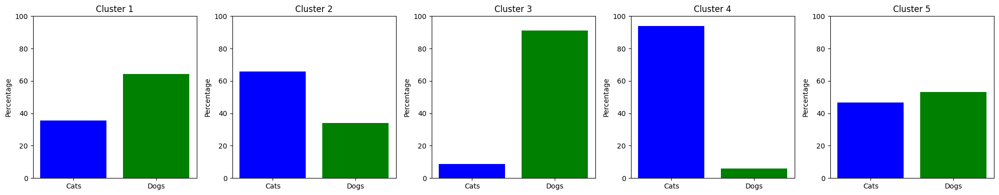


GMM with 6 Clusters:


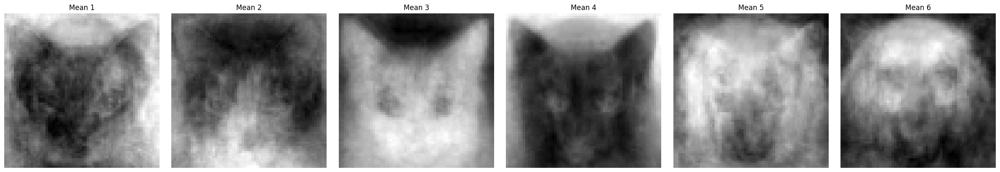

Silhouette Score: 0.081
Adjusted Rand Index (ARI): 0.071

Images in Cluster 1:


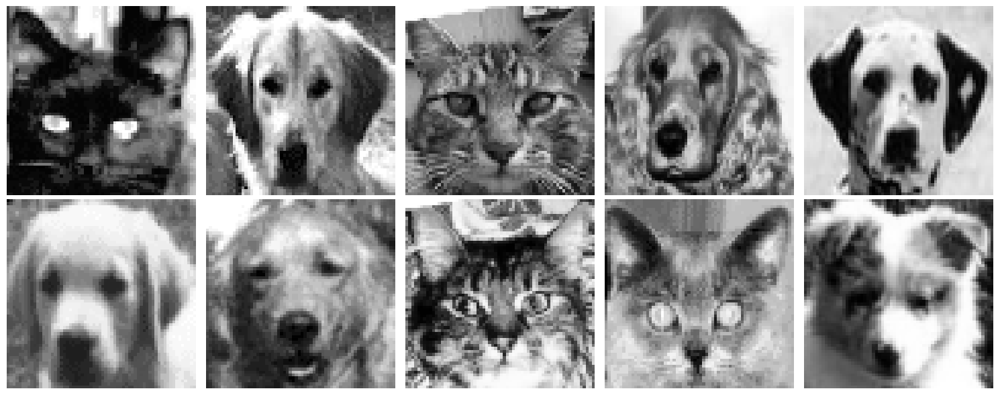


Images in Cluster 2:


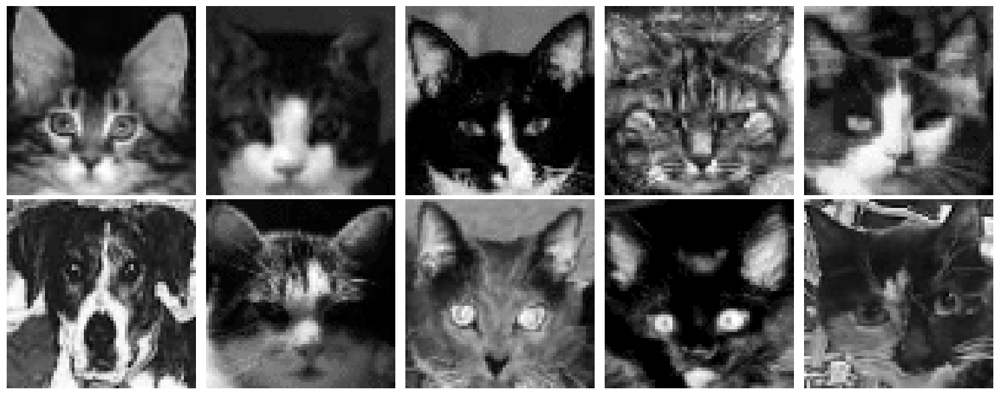


Images in Cluster 3:


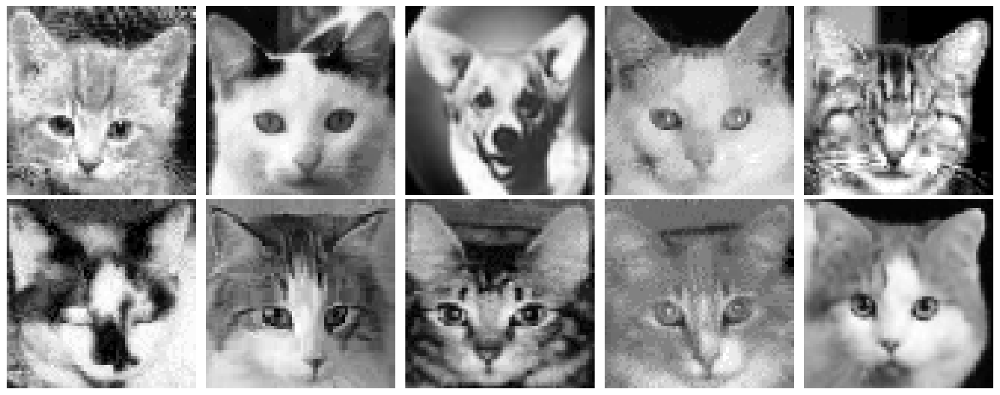


Images in Cluster 4:


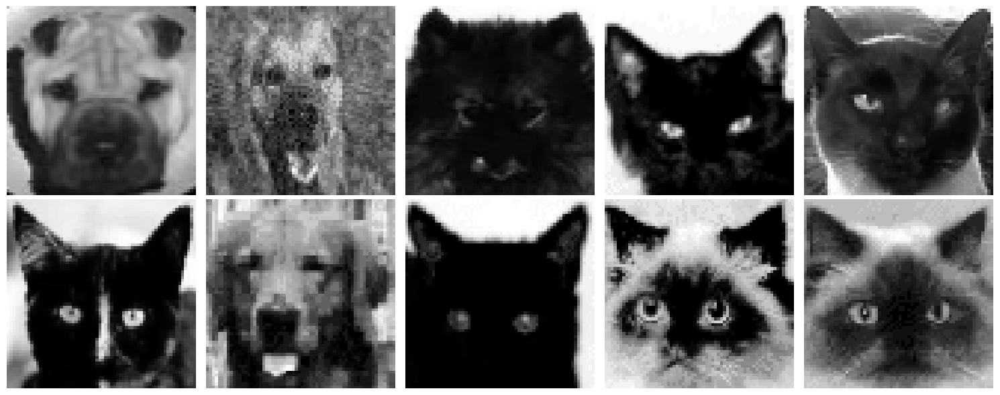


Images in Cluster 5:


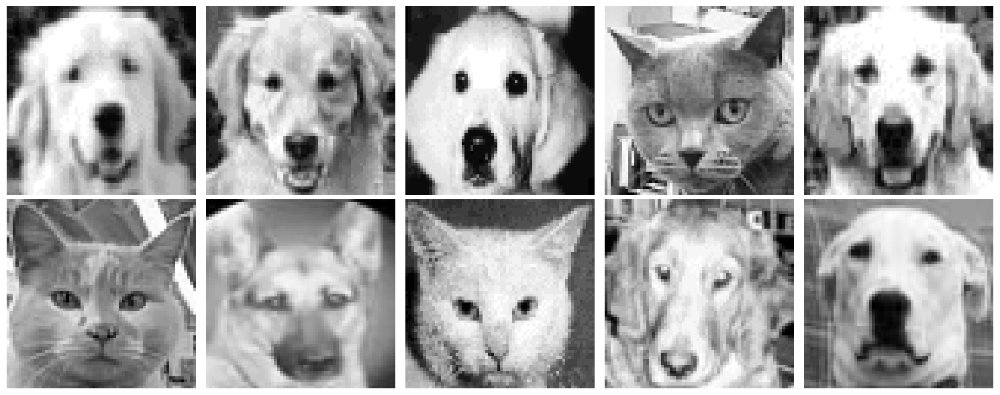


Images in Cluster 6:


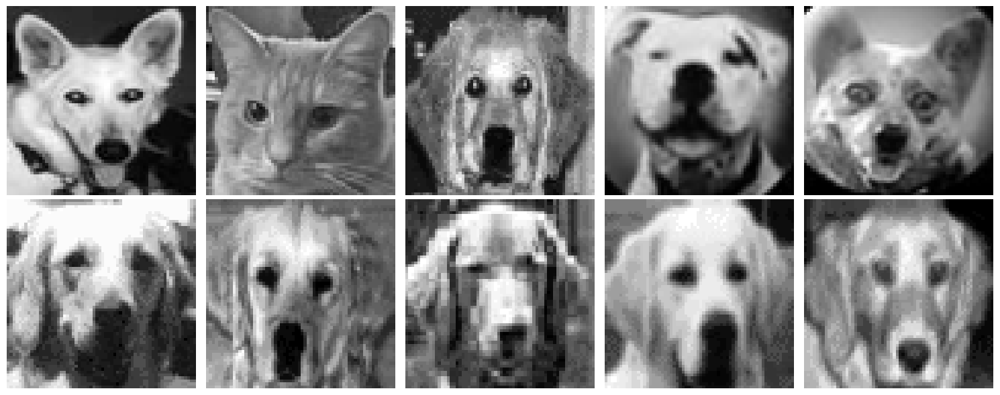

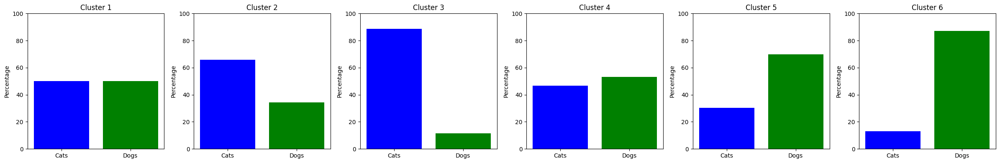


GMM with 7 Clusters:


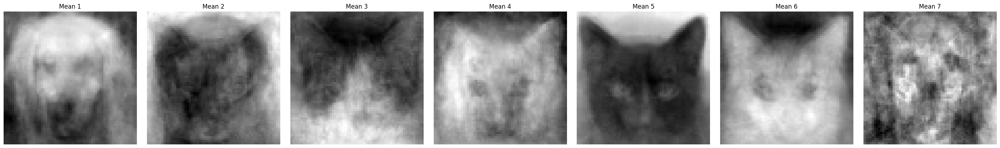

Silhouette Score: 0.069
Adjusted Rand Index (ARI): 0.101

Images in Cluster 1:


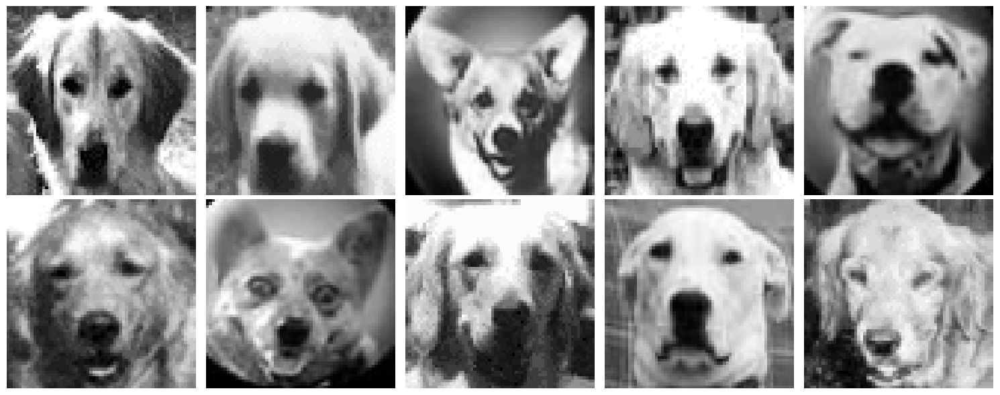


Images in Cluster 2:


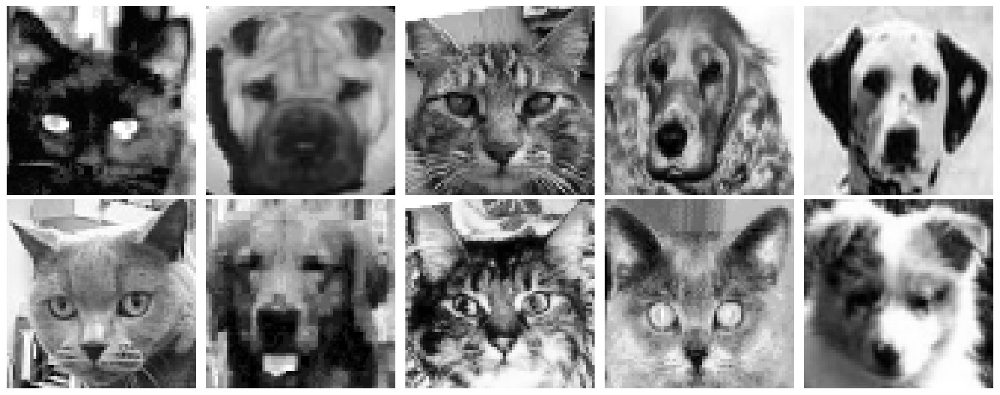


Images in Cluster 3:


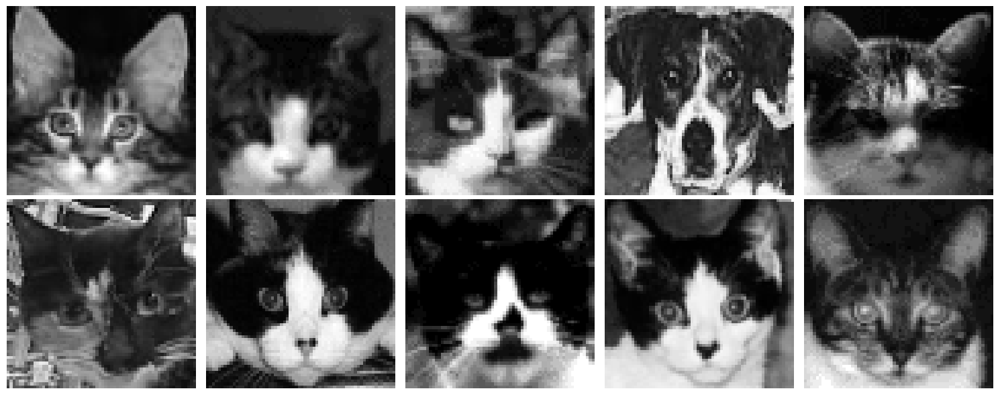


Images in Cluster 4:


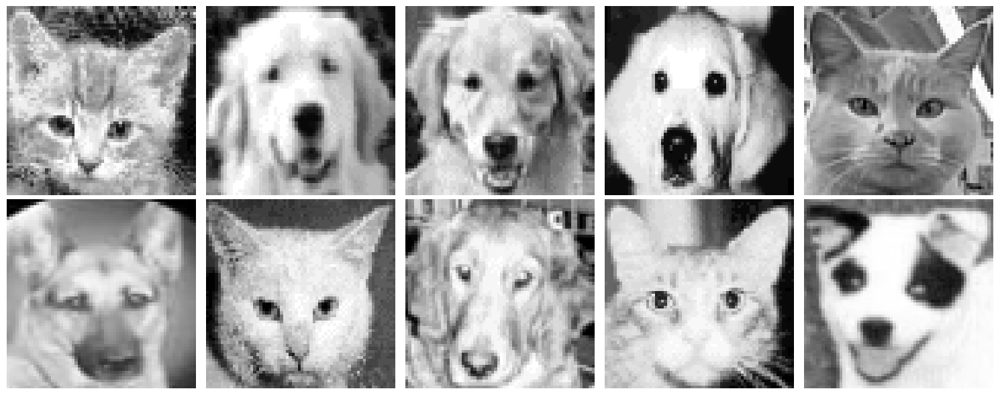


Images in Cluster 5:


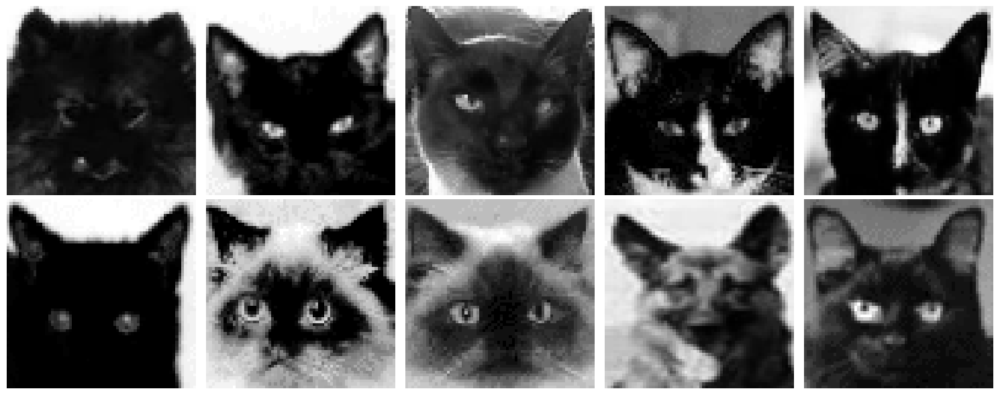


Images in Cluster 6:


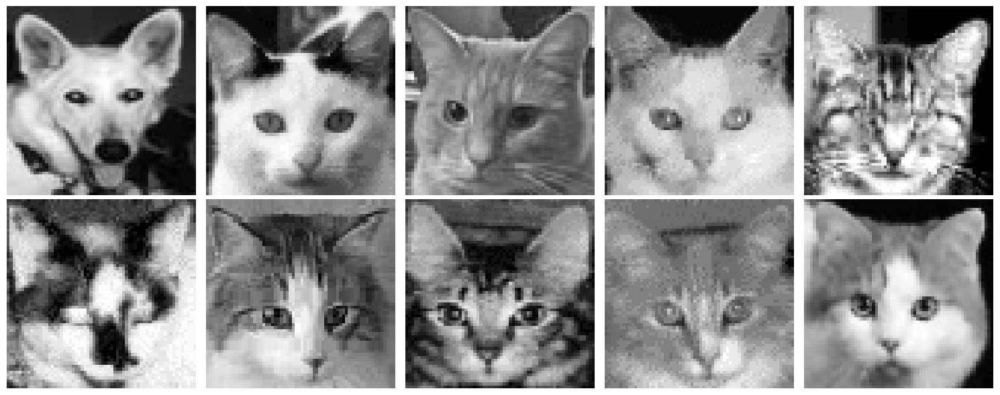


Images in Cluster 7:


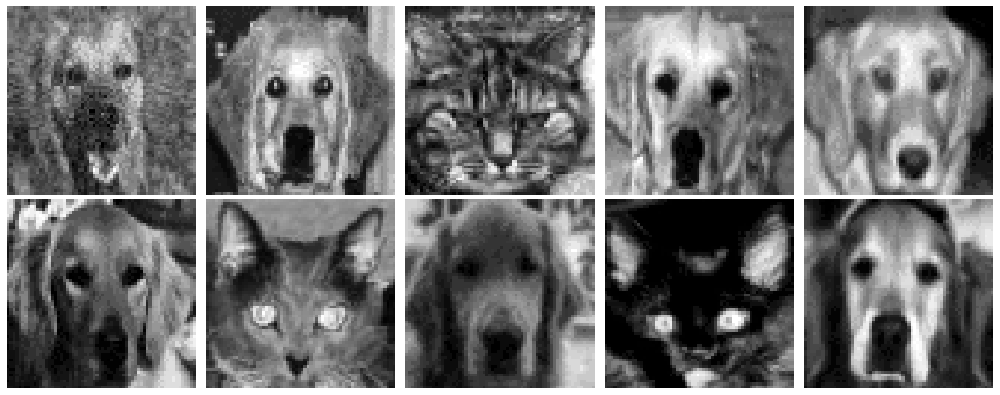

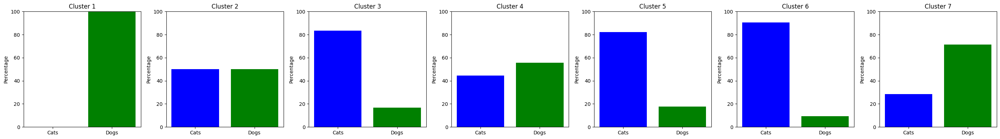


GMM with 8 Clusters:


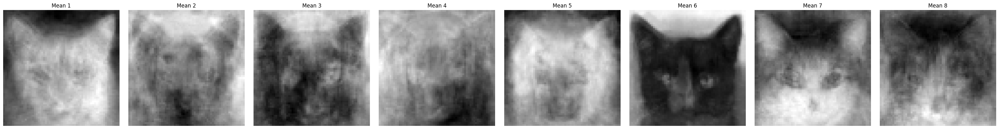

Silhouette Score: 0.060
Adjusted Rand Index (ARI): 0.033

Images in Cluster 1:


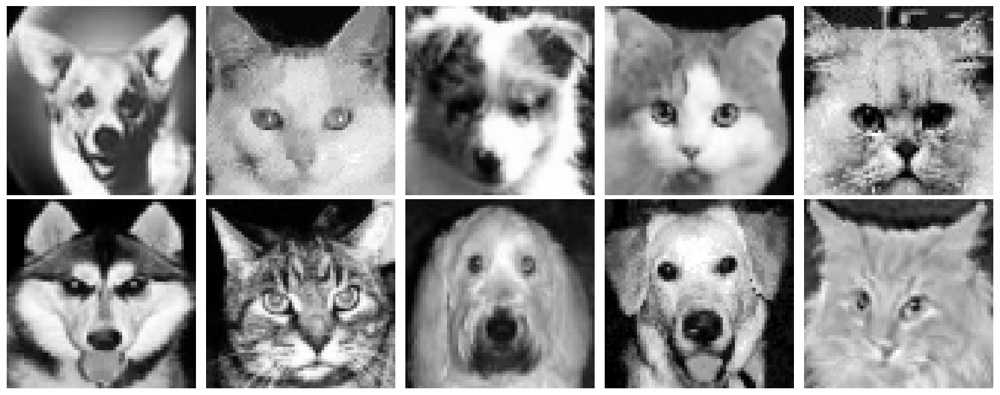


Images in Cluster 2:


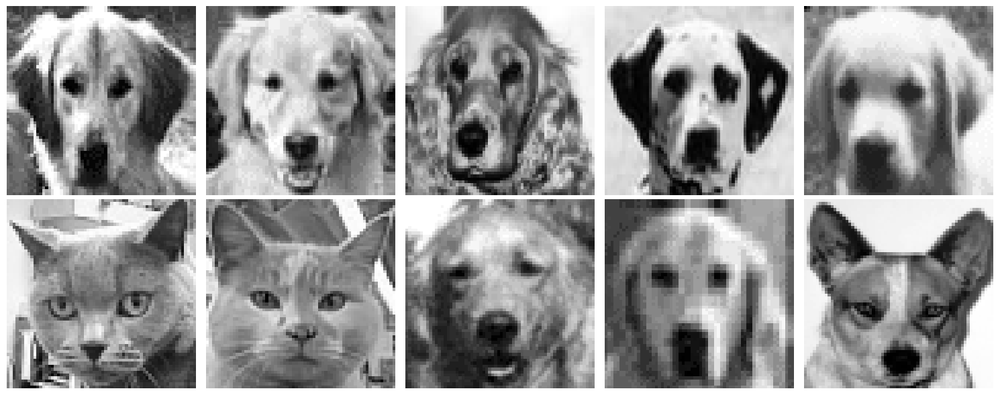


Images in Cluster 3:


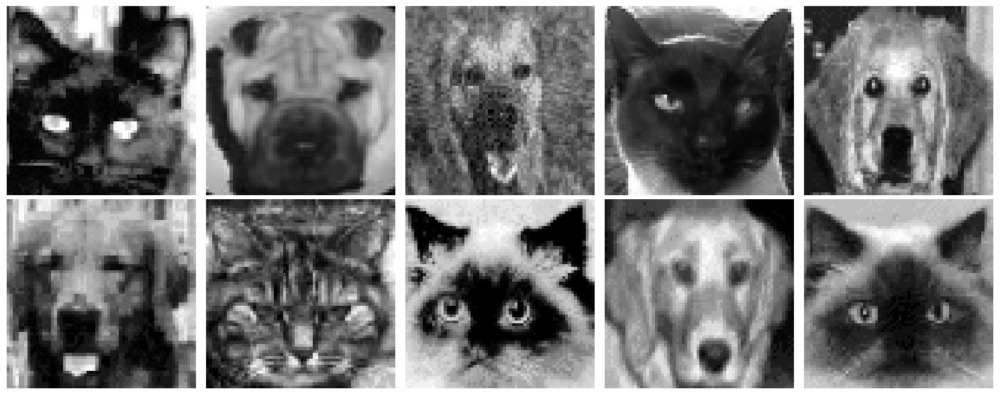


Images in Cluster 4:


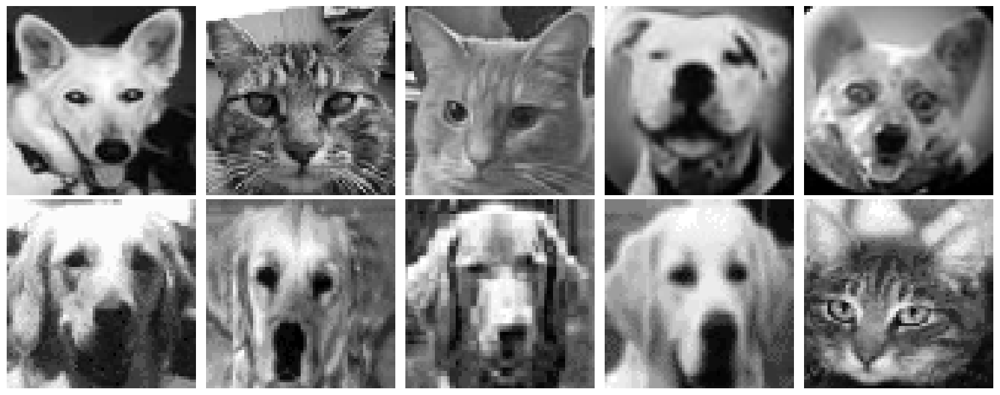


Images in Cluster 5:


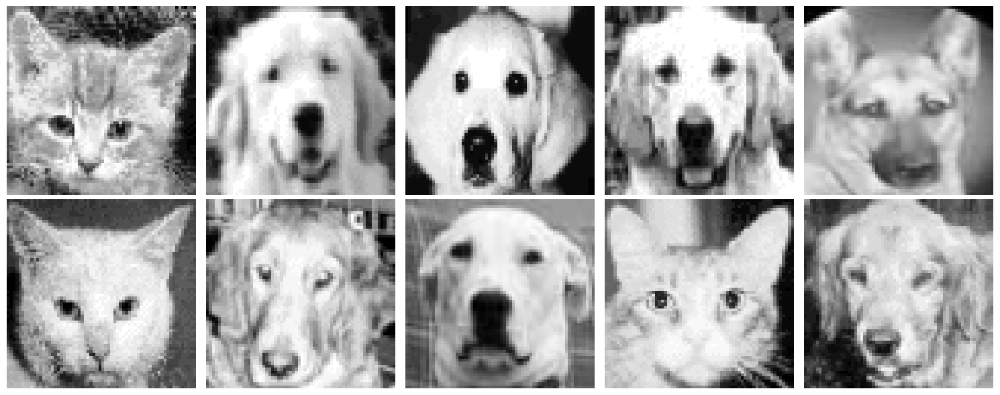


Images in Cluster 6:


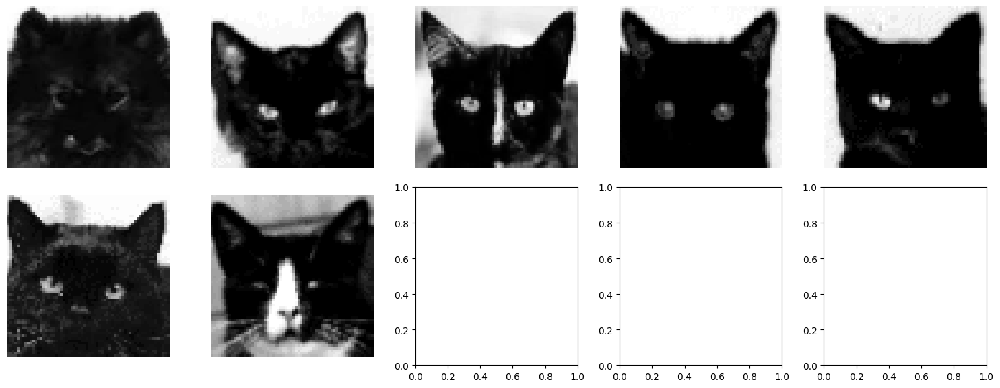


Images in Cluster 7:


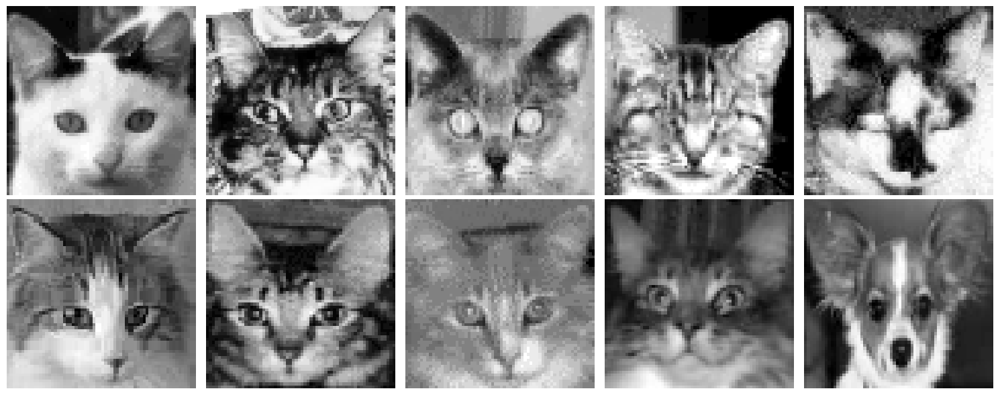


Images in Cluster 8:


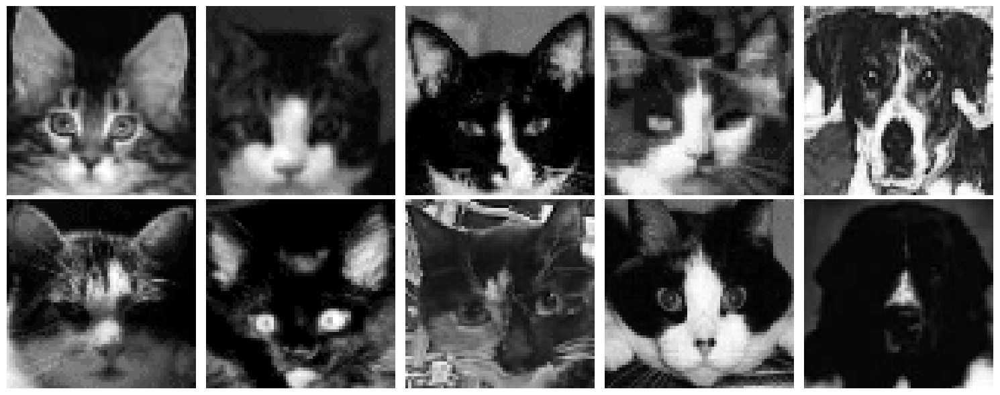

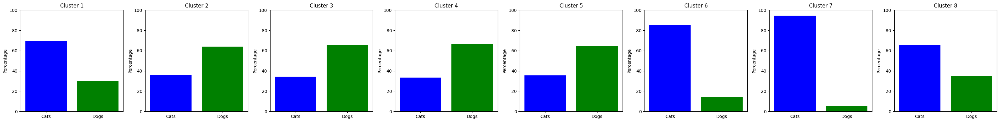

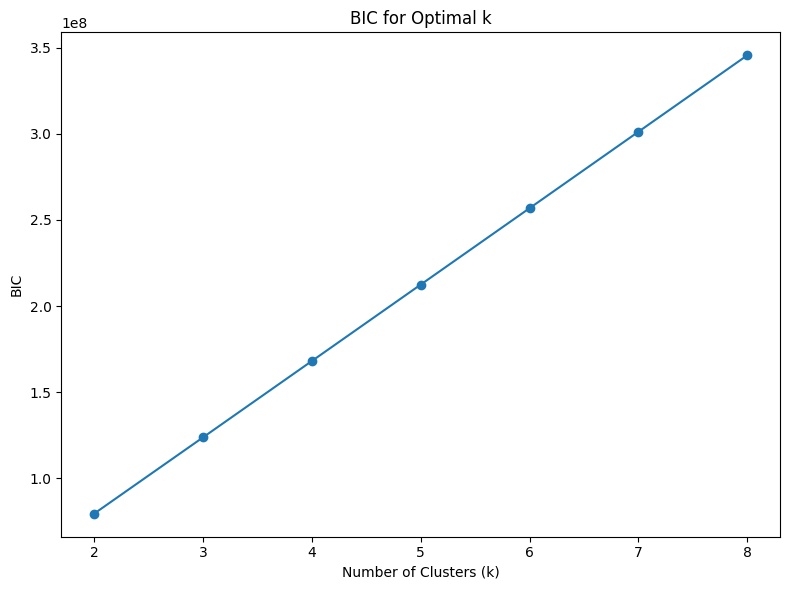

In [47]:
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, adjusted_rand_score

# Initialize lists to store metrics
ari_scores = []
silhouette_scores = []
bic_values = []

# Define the range for the number of clusters
cluster_range = (2, 9)
image_size = 64


for n_clusters in range(cluster_range[0], cluster_range[1]):
    gmm = GaussianMixture(n_components=n_clusters, random_state=42, n_init=10)
    gmm.fit(X_scaled)
    cluster_labels = gmm.predict(X_scaled)

    # Visualize Means
    print(f"\nGMM with {n_clusters} Clusters:")
    means = gmm.means_
    num_means = means.shape[0]
    fig, axs = plt.subplots(1, num_means, figsize=(num_means * 4, 4))
    for i, mean in enumerate(means):
        img = mean.reshape(image_size, image_size)
        axs[i].imshow(img, cmap='gray')
        axs[i].set_title(f"Mean {i+1}")
        axs[i].axis('off')
    plt.tight_layout()
    plt.show()

    # Assess Clustering
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    ari = adjusted_rand_score(y, cluster_labels)
    bic_values.append(gmm.bic(X_scaled))

    print(f"Silhouette Score: {silhouette_avg:.3f}")
    print(f"Adjusted Rand Index (ARI): {ari:.3f}")

    # Show Clustered Images
    for cluster_id in range(n_clusters):
        print(f"\nImages in Cluster {cluster_id + 1}:")
        cluster_indices = np.where(cluster_labels == cluster_id)[0]

        # Adjust the number of rows and columns in the subplot grid
        num_rows = 2
        num_cols = 5
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 6))

        for i, idx in enumerate(cluster_indices[:10]):
            row = i // num_cols
            col = i % num_cols
            img = X.iloc[idx].values.reshape(image_size, image_size)
            axs[row, col].imshow(img, cmap='gray')
            axs[row, col].axis('off')
        plt.tight_layout()
        plt.show()

    # Plot percentage of each class in each cluster
    fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters * 4, 4))
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(cluster_labels == cluster_id)[0]
        cats_in_cluster = np.sum(y[cluster_indices] == 0)
        dogs_in_cluster = np.sum(y[cluster_indices] == 1)
        total_in_cluster = len(cluster_indices)

        cats_percentage = (cats_in_cluster / total_in_cluster) * 100
        dogs_percentage = (dogs_in_cluster / total_in_cluster) * 100

        axs[cluster_id].bar(['Cats', 'Dogs'], [cats_percentage, dogs_percentage], color=['blue', 'green'])
        axs[cluster_id].set_title(f'Cluster {cluster_id + 1}')
        axs[cluster_id].set_ylim(0, 100)
        axs[cluster_id].set_ylabel('Percentage')

    plt.tight_layout()
    plt.show()

# BIC Plot
plt.figure(figsize=(8, 6))
plt.plot(range(cluster_range[0], cluster_range[1]), bic_values, marker='o')
plt.title('BIC for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('BIC')
plt.tight_layout()
plt.show()

#### 4.1.2 K-means (Whole Dataset)


K-Means with 2 Clusters:


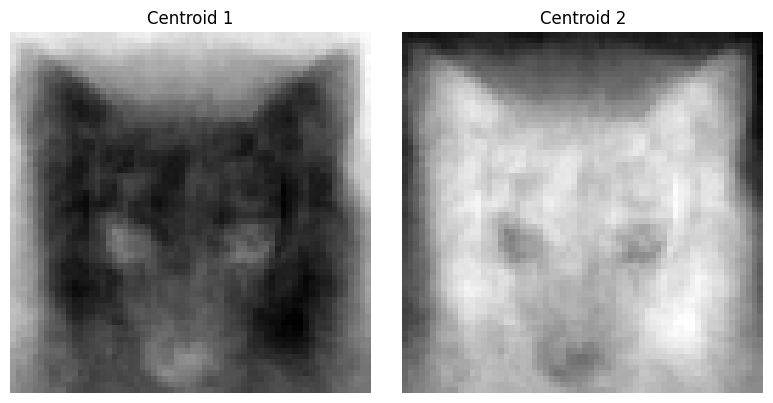

Silhouette Score: 0.131
Adjusted Rand Index (ARI): -0.005

Images in Cluster 1:


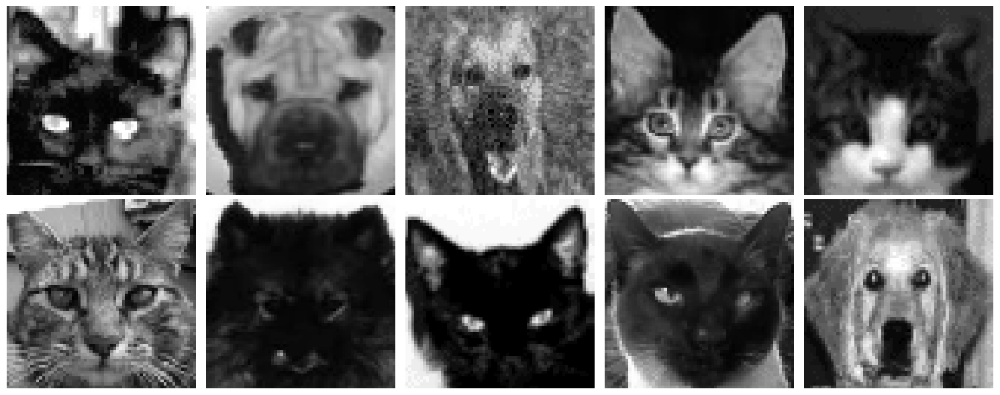


Images in Cluster 2:


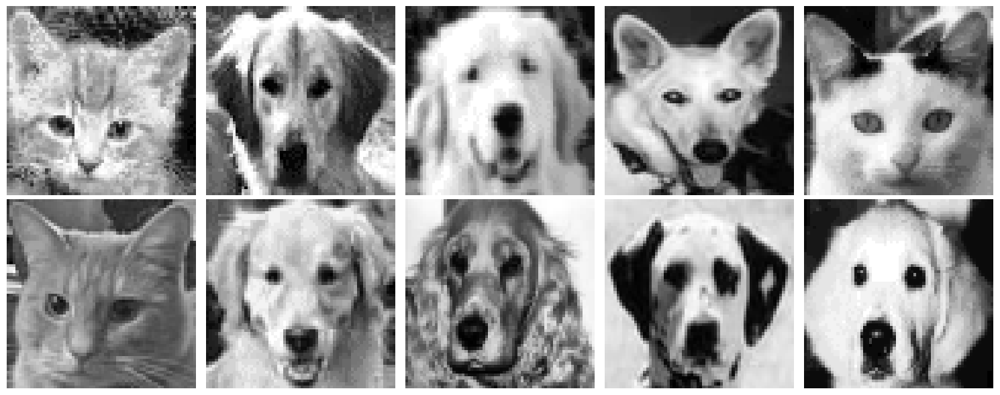

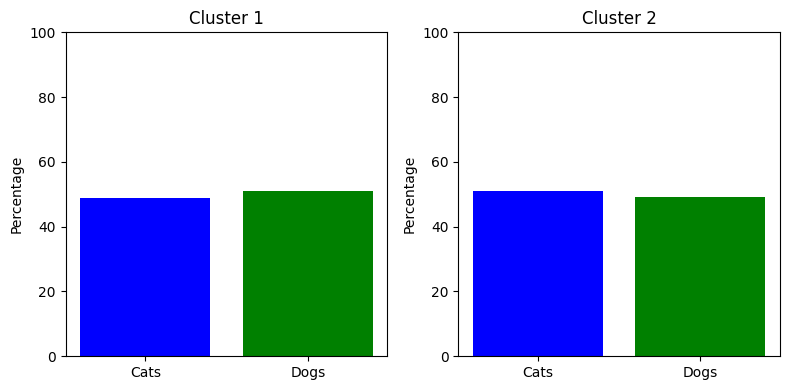


K-Means with 3 Clusters:


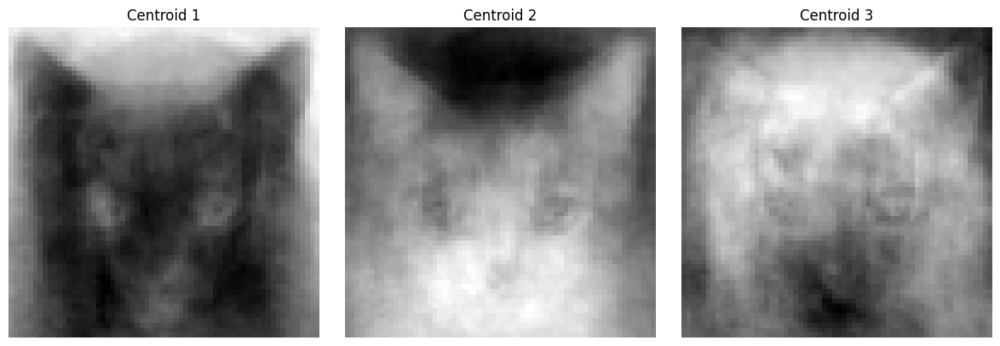

Silhouette Score: 0.096
Adjusted Rand Index (ARI): 0.115

Images in Cluster 1:


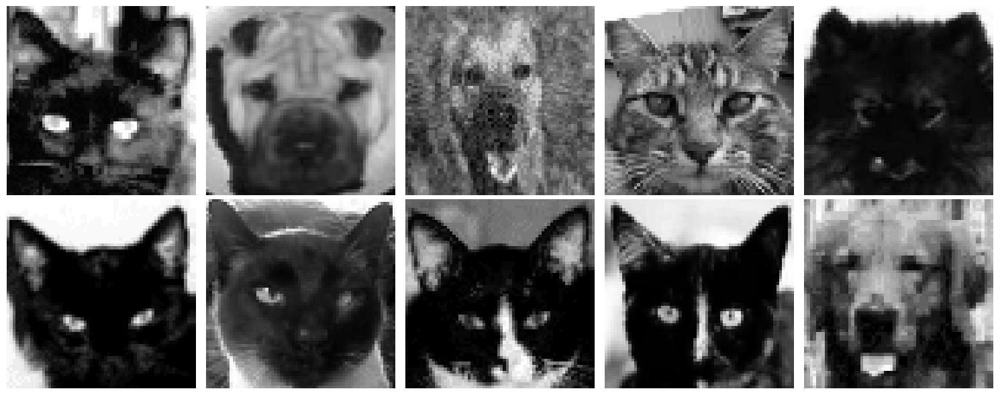


Images in Cluster 2:


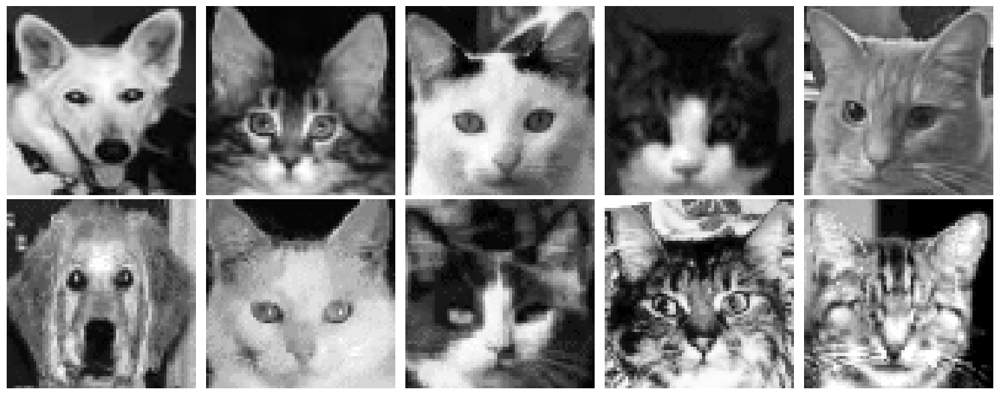


Images in Cluster 3:


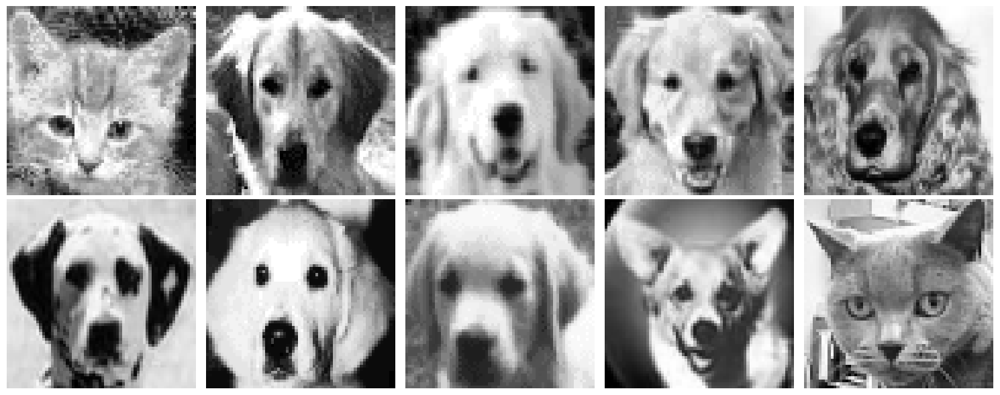

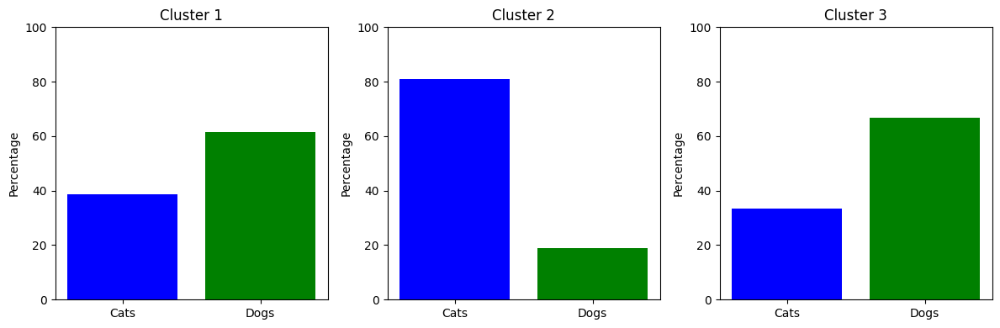


K-Means with 4 Clusters:


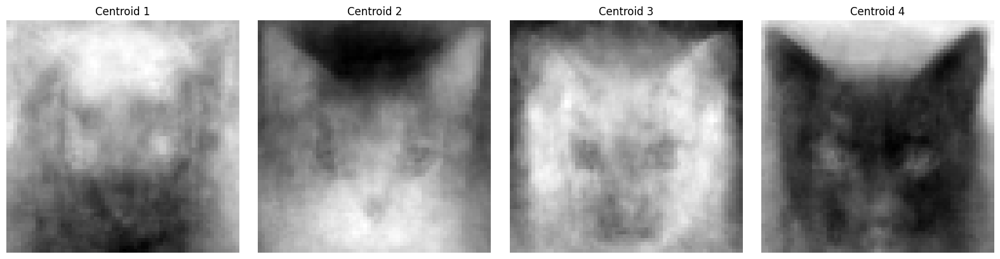

Silhouette Score: 0.092
Adjusted Rand Index (ARI): 0.131

Images in Cluster 1:


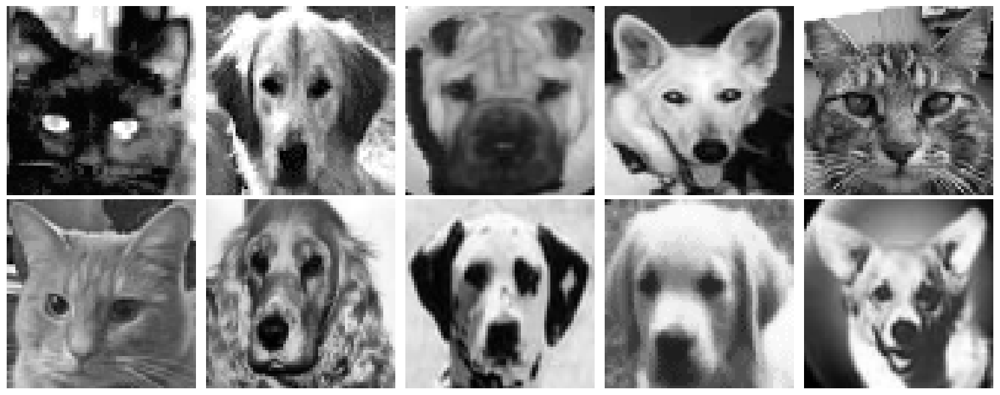


Images in Cluster 2:


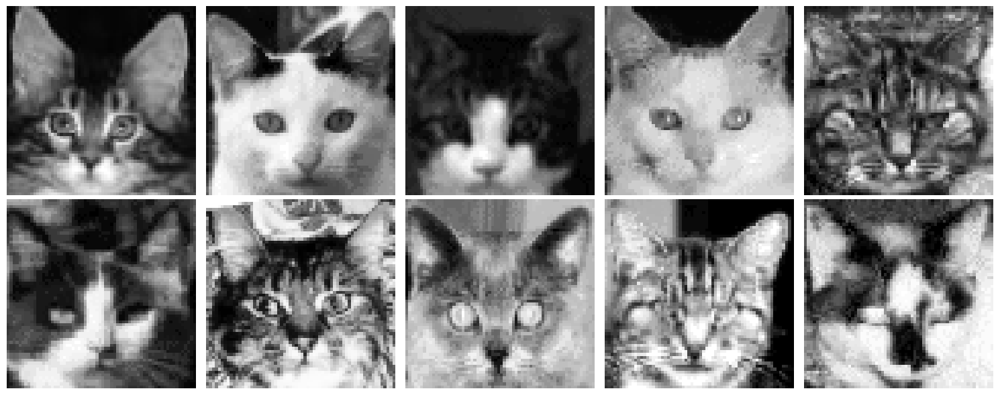


Images in Cluster 3:


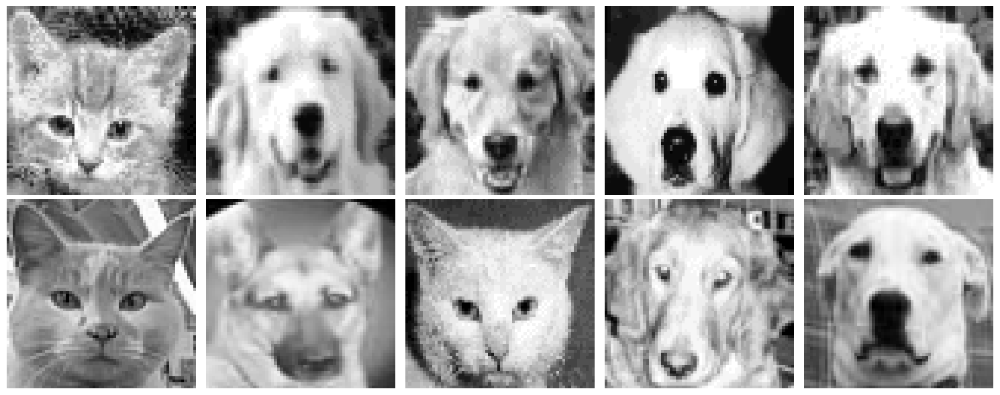


Images in Cluster 4:


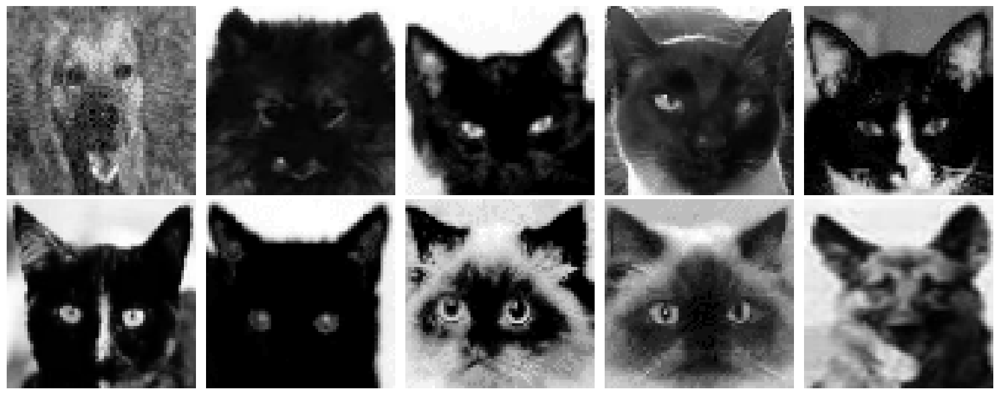

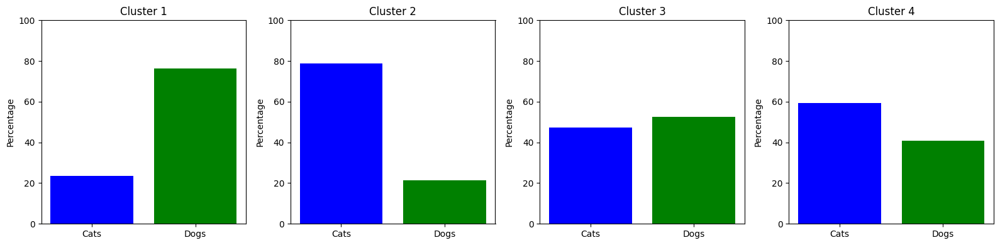


K-Means with 5 Clusters:


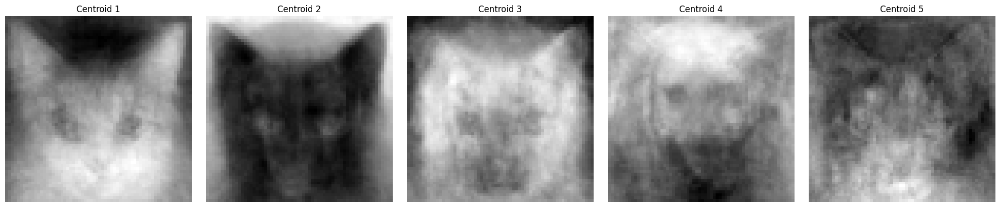

Silhouette Score: 0.077
Adjusted Rand Index (ARI): 0.080

Images in Cluster 1:


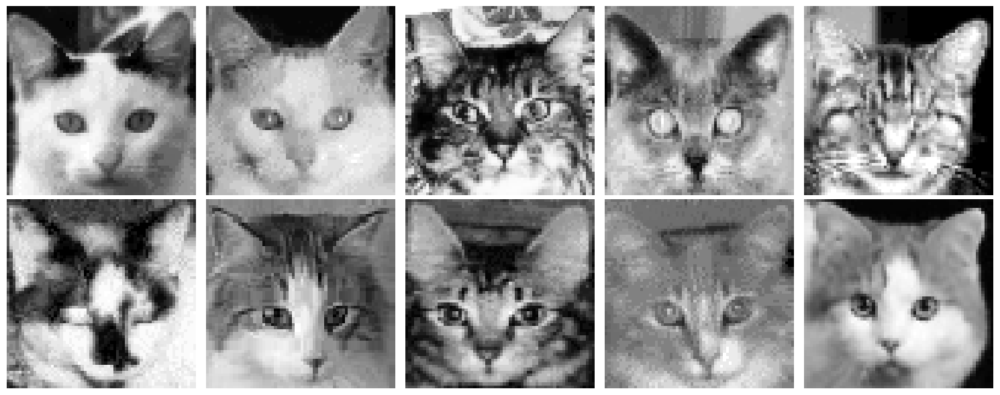


Images in Cluster 2:


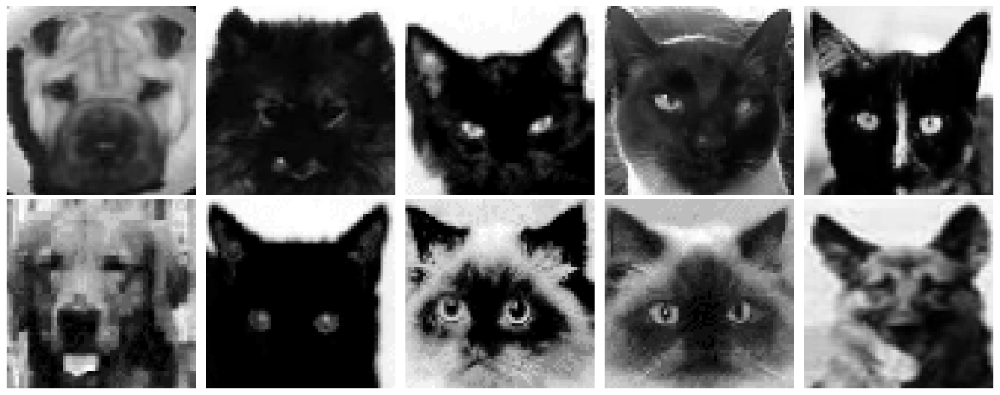


Images in Cluster 3:


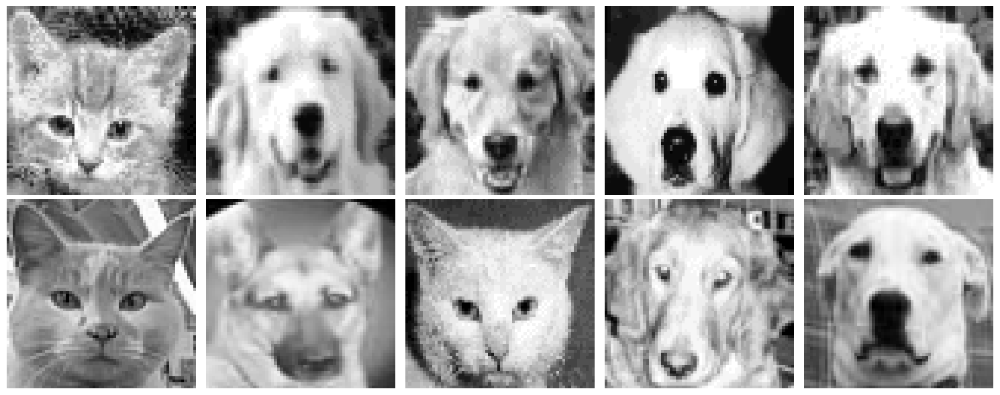


Images in Cluster 4:


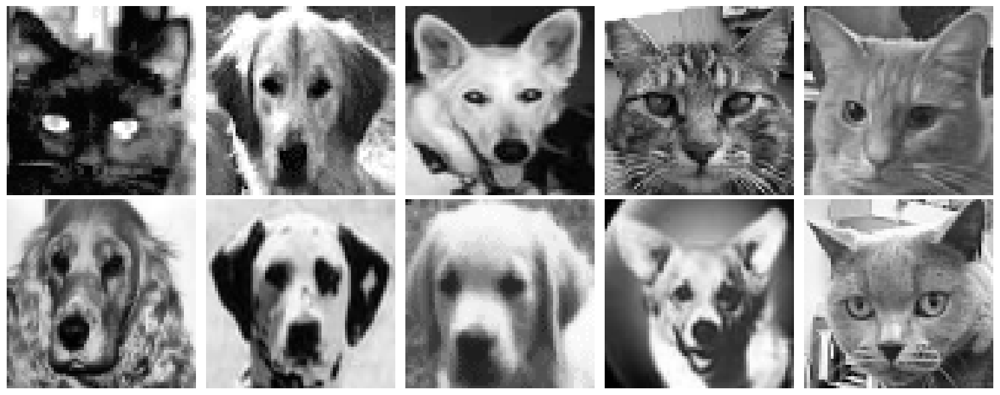


Images in Cluster 5:


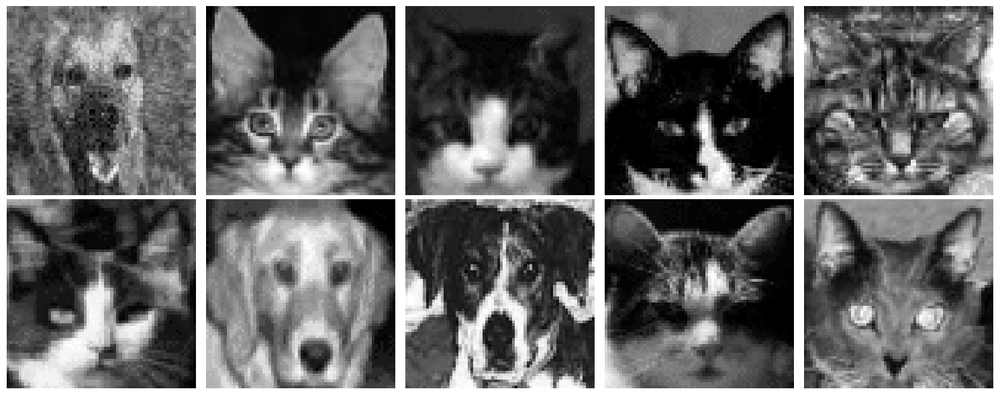

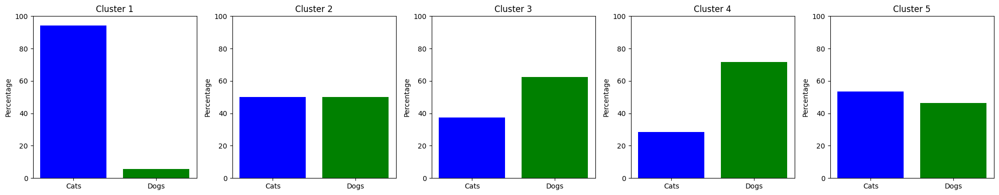


K-Means with 6 Clusters:


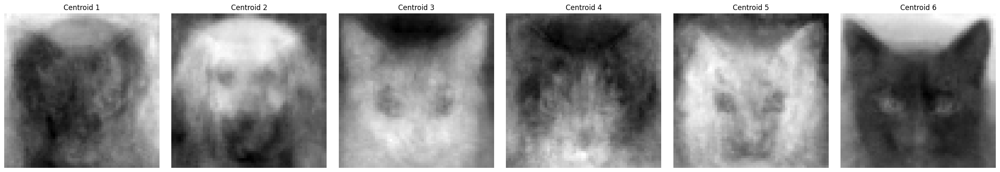

Silhouette Score: 0.082
Adjusted Rand Index (ARI): 0.106

Images in Cluster 1:


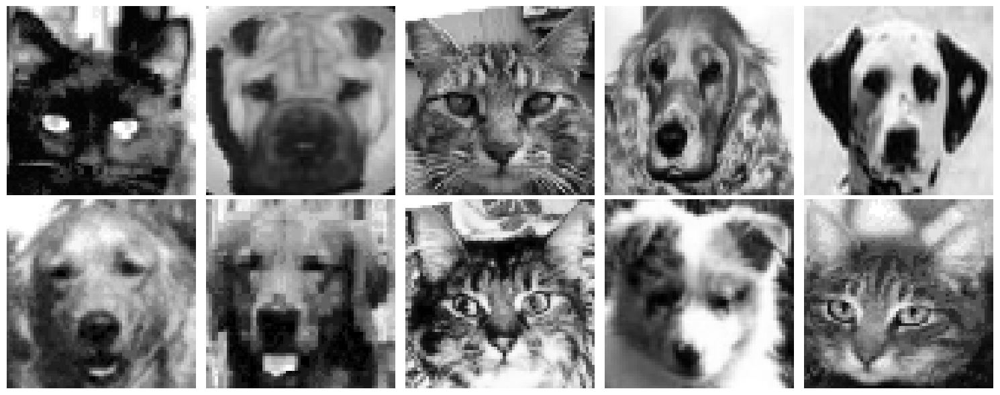


Images in Cluster 2:


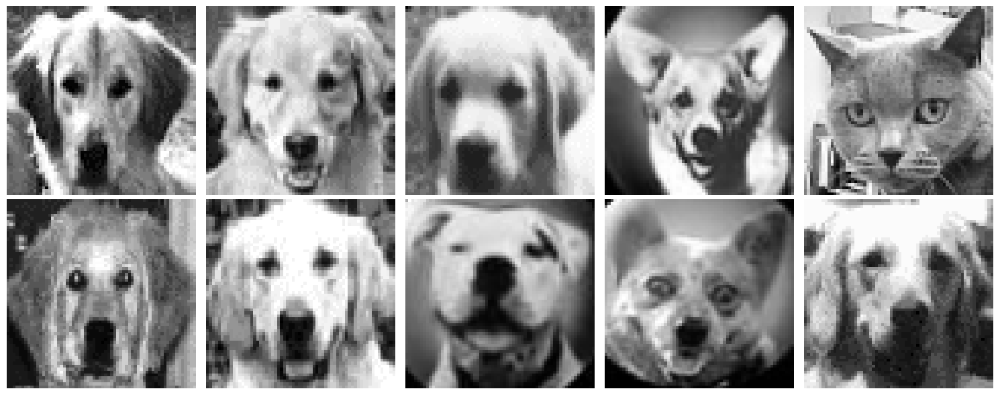


Images in Cluster 3:


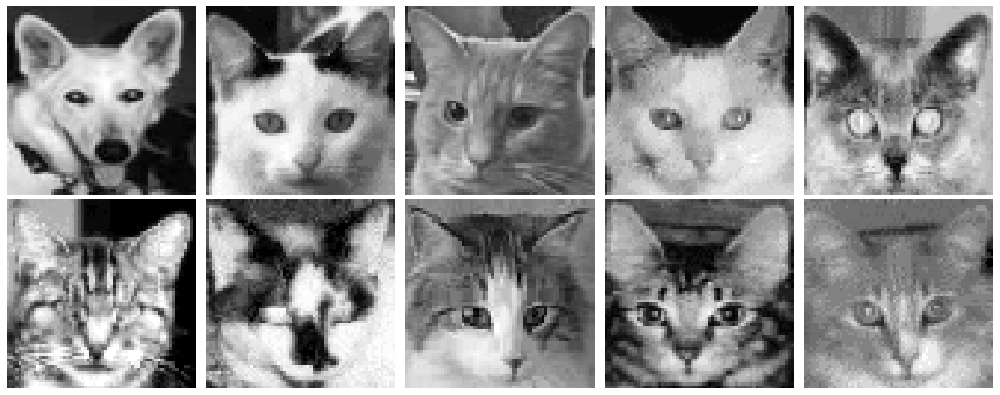


Images in Cluster 4:


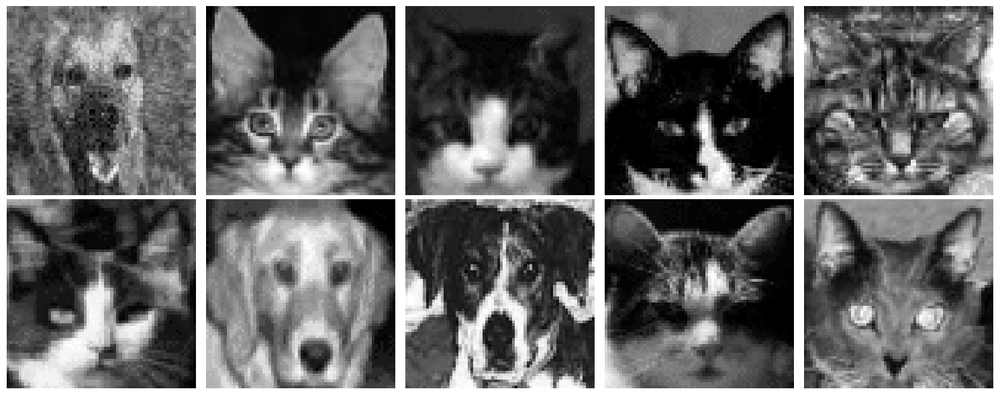


Images in Cluster 5:


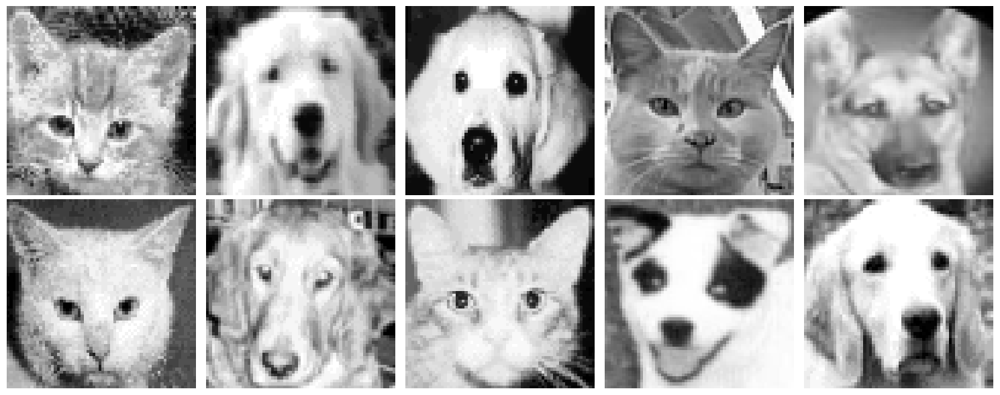


Images in Cluster 6:


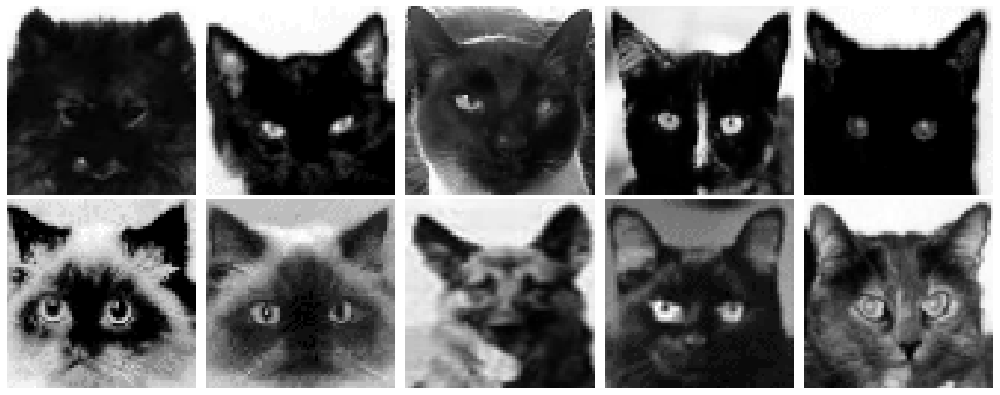

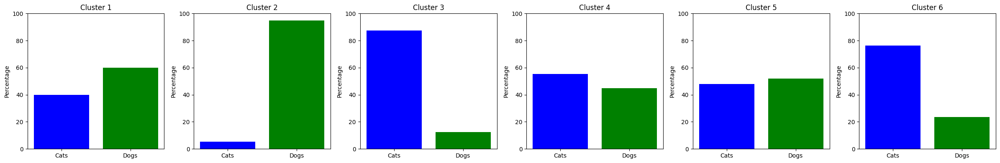


K-Means with 7 Clusters:


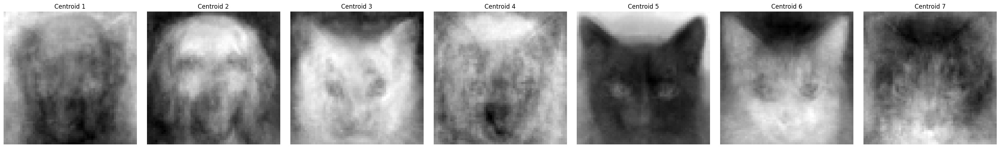

Silhouette Score: 0.074
Adjusted Rand Index (ARI): 0.076

Images in Cluster 1:


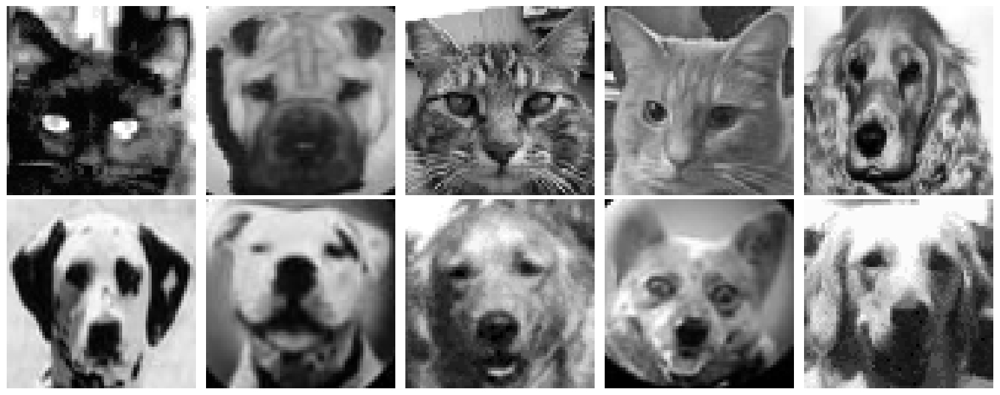


Images in Cluster 2:


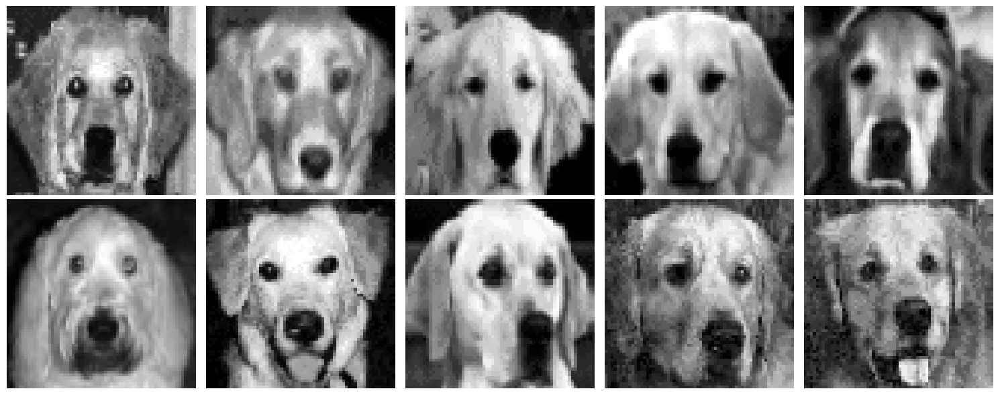


Images in Cluster 3:


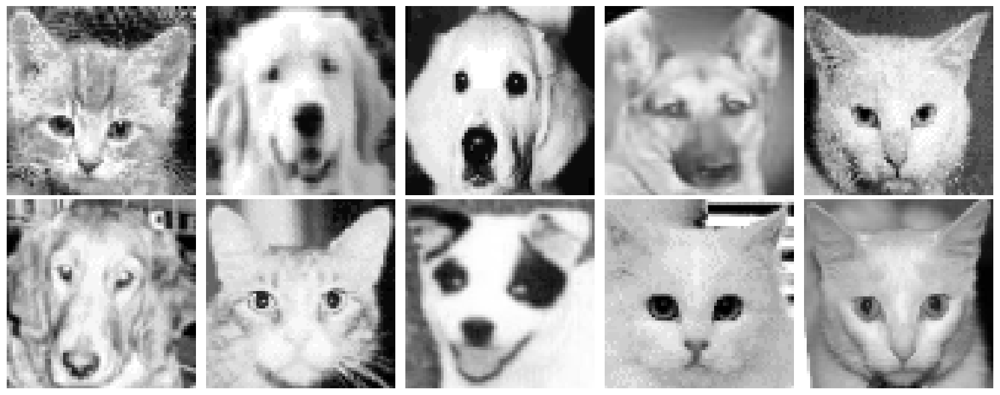


Images in Cluster 4:


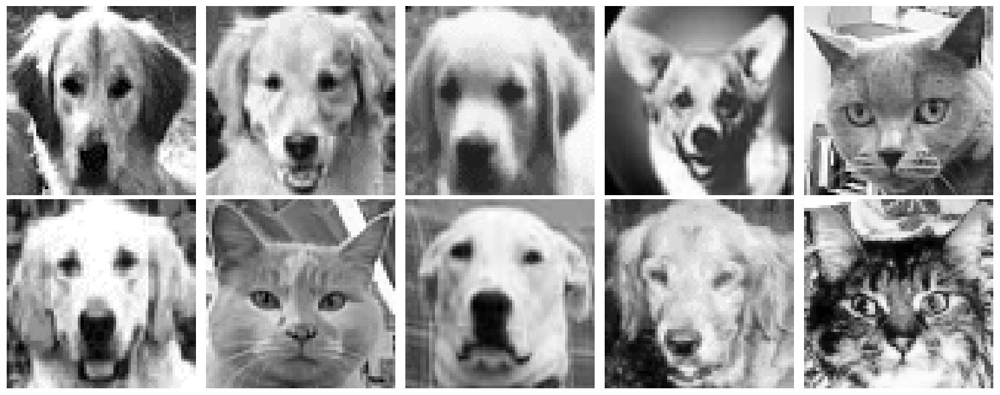


Images in Cluster 5:


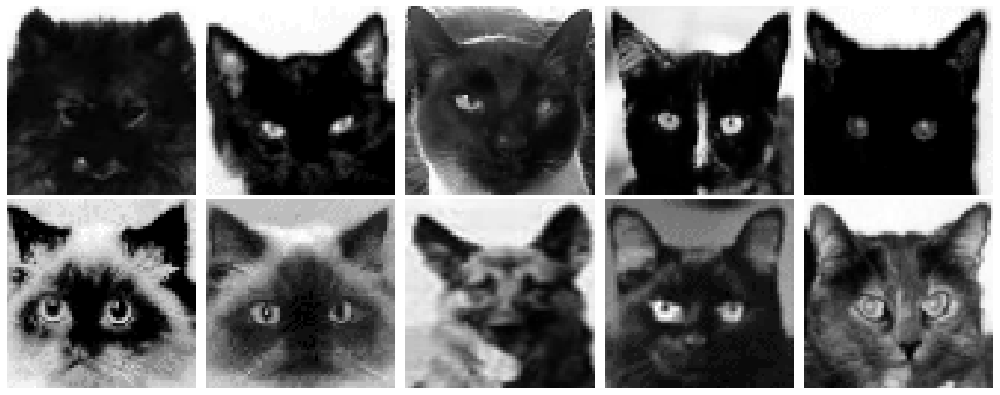


Images in Cluster 6:


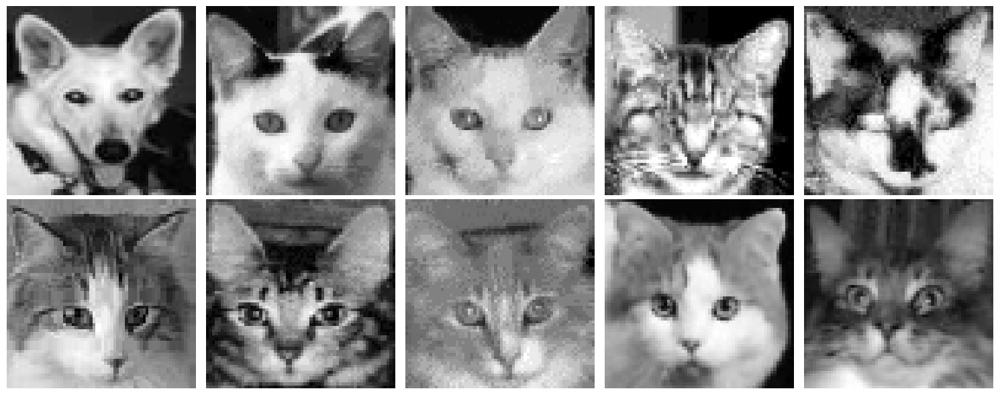


Images in Cluster 7:


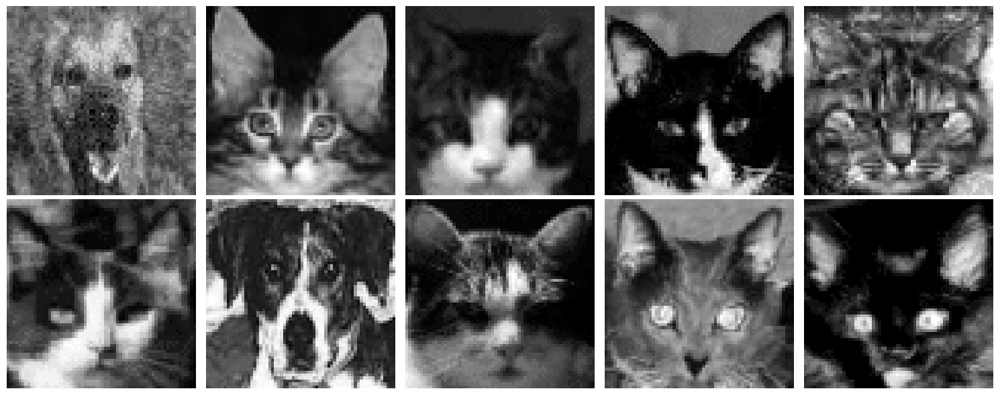

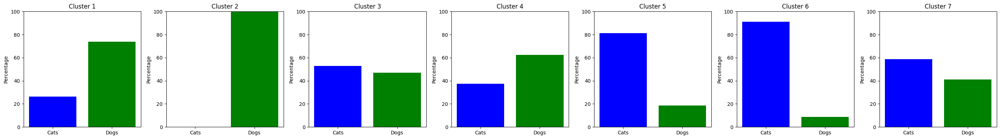


K-Means with 8 Clusters:


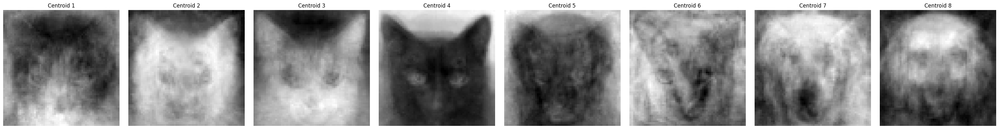

Silhouette Score: 0.081
Adjusted Rand Index (ARI): 0.099

Images in Cluster 1:


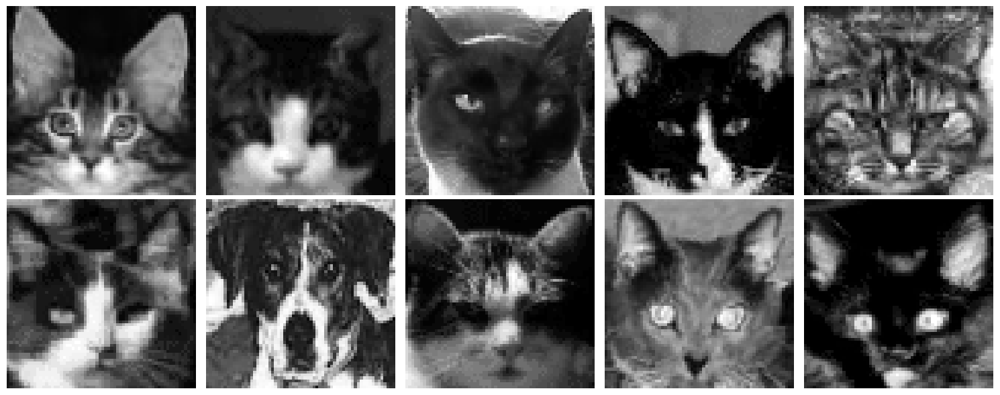


Images in Cluster 2:


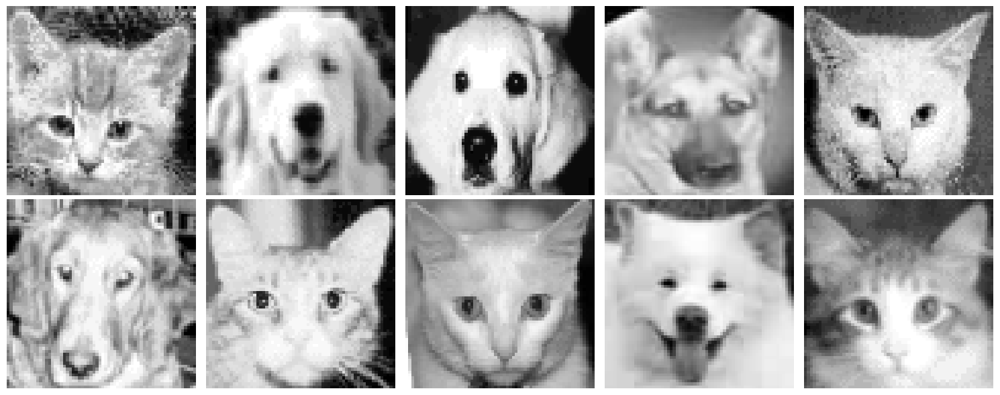


Images in Cluster 3:


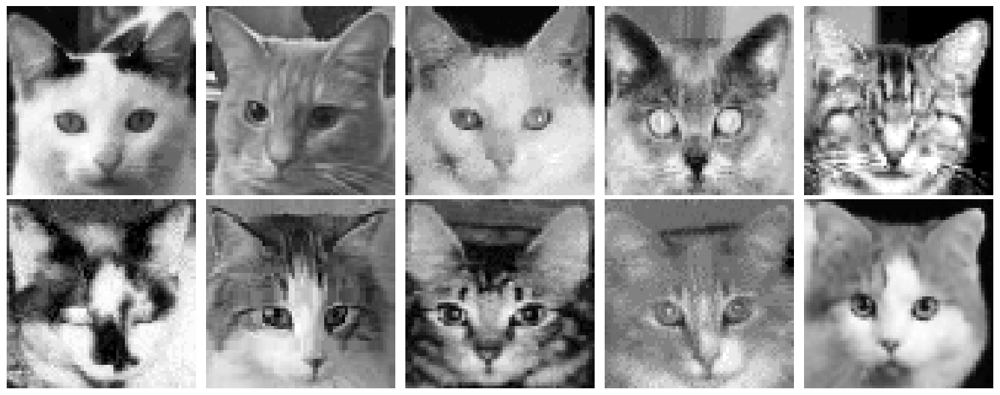


Images in Cluster 4:


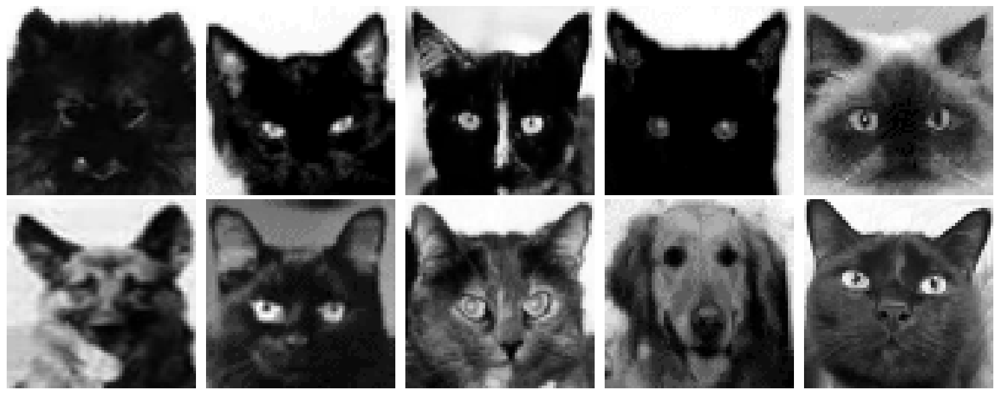


Images in Cluster 5:


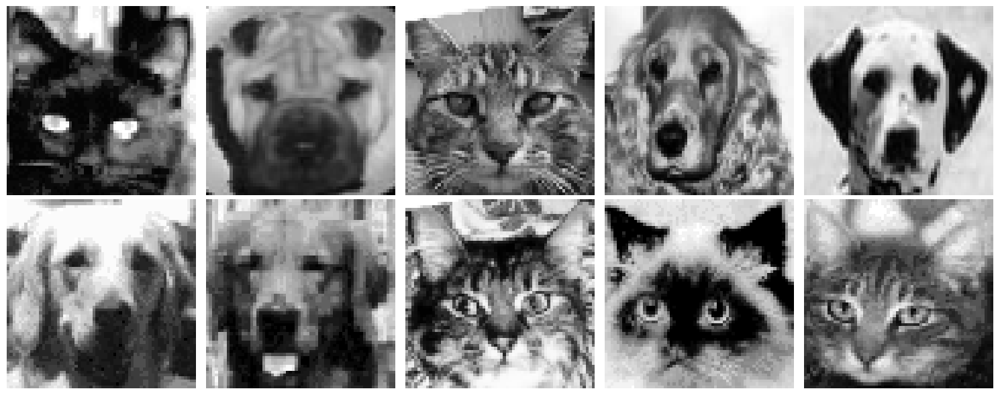


Images in Cluster 6:


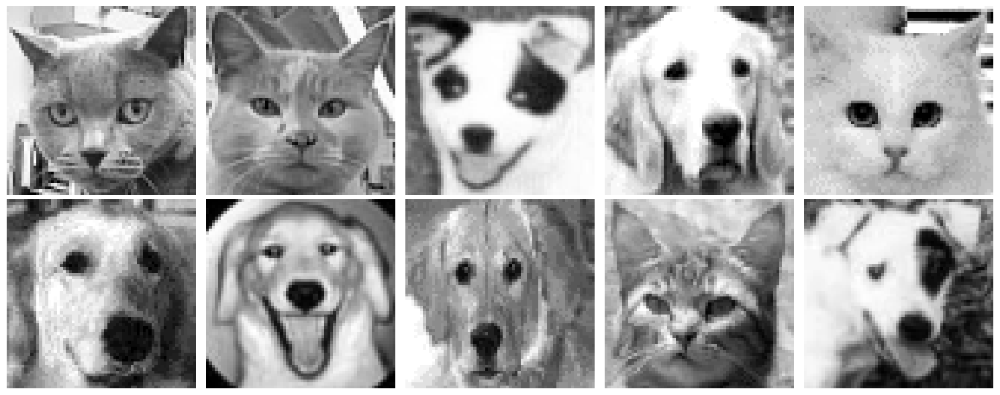


Images in Cluster 7:


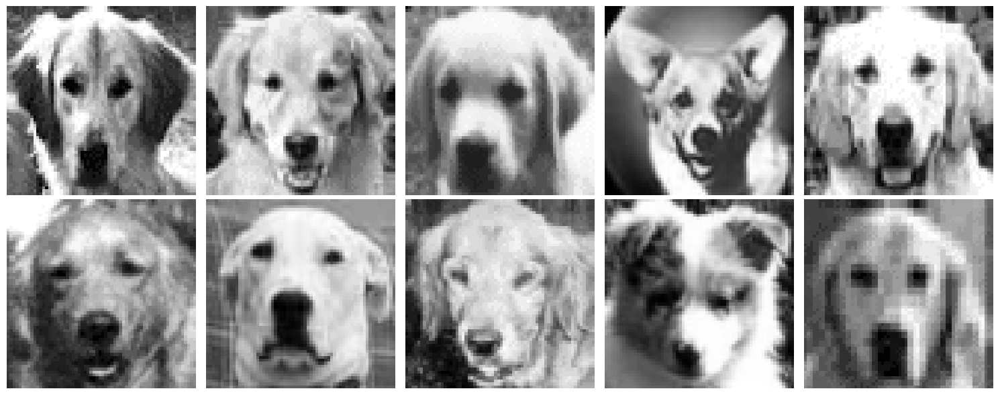


Images in Cluster 8:


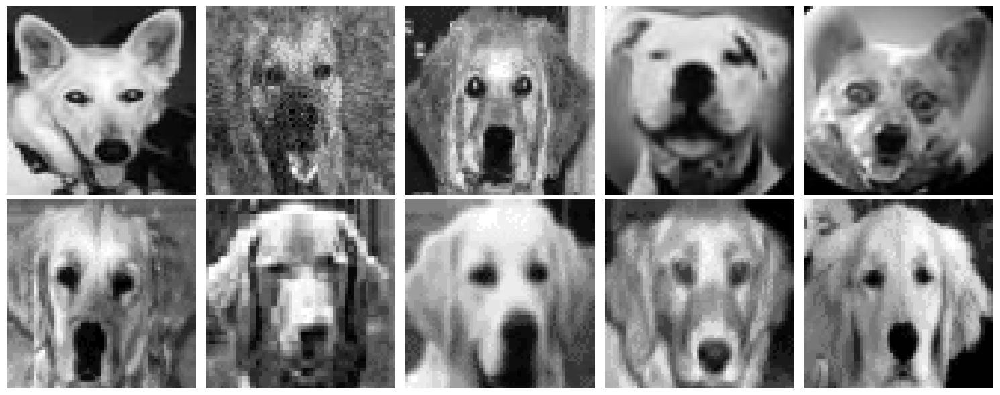

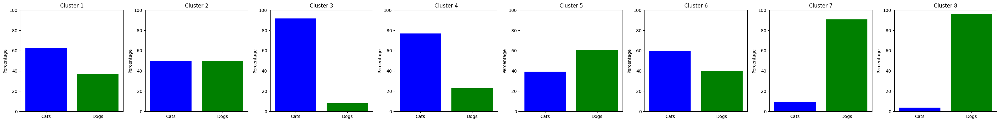

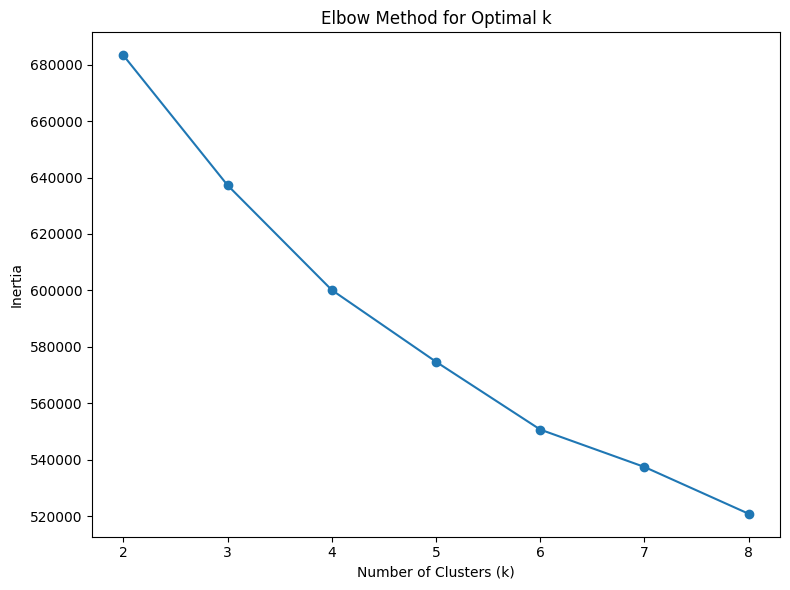

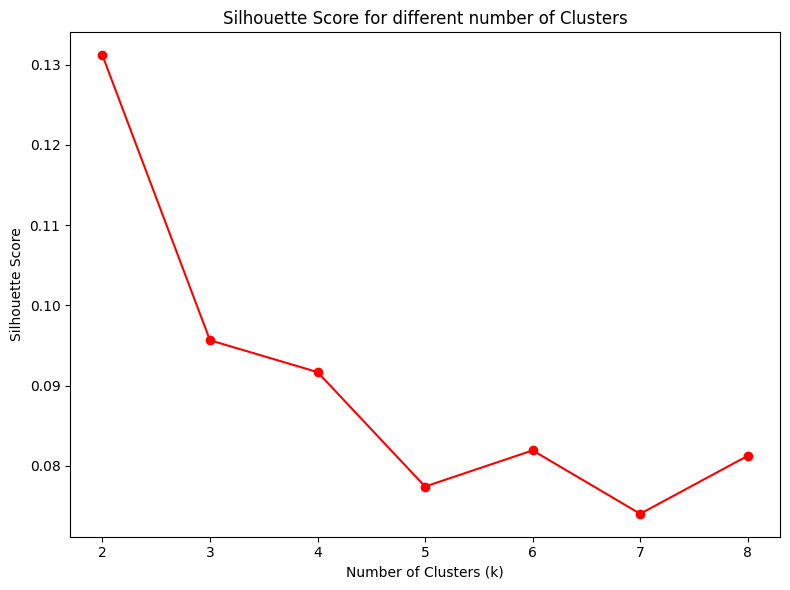

In [53]:
from sklearn.cluster import KMeans

# Initialize lists to store metrics
ari_scores = []
silhouette_scores = []
inertia_values = []

cluster_range = (2, 9)
image_size = 64

for n_clusters in range(cluster_range[0], cluster_range[1]):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    kmeans.fit(X_scaled)

    # Visualize Centroids
    print(f"\nK-Means with {n_clusters} Clusters:")
    centroids = kmeans.cluster_centers_
    num_centroids = centroids.shape[0]
    fig, axs = plt.subplots(1, num_centroids, figsize=(num_centroids * 4, 4))
    for i, centroid in enumerate(centroids):
        img = centroid.reshape(image_size, image_size)
        axs[i].imshow(img, cmap='gray')
        axs[i].set_title(f"Centroid {i+1}")
        axs[i].axis('off')
    plt.tight_layout()
    plt.show()

    # Assess Clustering
    silhouette_avg = silhouette_score(X_scaled, kmeans.labels_)
    ari = adjusted_rand_score(y, kmeans.labels_)
    silhouette_scores.append(silhouette_avg)
    ari_scores.append(ari)
    inertia_values.append(kmeans.inertia_)

    print(f"Silhouette Score: {silhouette_avg:.3f}")
    print(f"Adjusted Rand Index (ARI): {ari:.3f}")

    # Show Clustered Images
    for cluster_id in range(n_clusters):
        print(f"\nImages in Cluster {cluster_id + 1}:")
        cluster_indices = np.where(kmeans.labels_ == cluster_id)[0]

        # Adjust the number of rows and columns in the subplot grid
        num_rows = 2  # Display images in 2 rows
        num_cols = 5  # Display 5 images per row (total of 10 images)
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 6))  # Adjust figure size

        for i, idx in enumerate(cluster_indices[:10]):  # Show the first 10 images
            row = i // num_cols
            col = i % num_cols
            img = X.iloc[idx].values.reshape(image_size, image_size)  # Correct indexing with .iloc
            axs[row, col].imshow(img, cmap='gray')
            axs[row, col].axis('off')
        plt.tight_layout()
        plt.show()

    # Plot percentage of each class in each cluster
    fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters * 4, 4))
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(kmeans.labels_ == cluster_id)[0]
        cats_in_cluster = np.sum(y[cluster_indices] == 0)
        dogs_in_cluster = np.sum(y[cluster_indices] == 1)
        total_in_cluster = len(cluster_indices)
        
        cats_percentage = (cats_in_cluster / total_in_cluster) * 100
        dogs_percentage = (dogs_in_cluster / total_in_cluster) * 100
        
        axs[cluster_id].bar(['Cats', 'Dogs'], [cats_percentage, dogs_percentage], color=['blue', 'green'])
        axs[cluster_id].set_title(f'Cluster {cluster_id + 1}')
        axs[cluster_id].set_ylim(0, 100)
        axs[cluster_id].set_ylabel('Percentage')
    
    plt.tight_layout()
    plt.show()

# Elbow Method Plot
plt.figure(figsize=(8, 6))
plt.plot(range(cluster_range[0], cluster_range[1]), inertia_values, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.tight_layout()
plt.show()

# Plot Silhouette Scores
plt.figure(figsize=(8, 6))
plt.plot(range(cluster_range[0], cluster_range[1]), silhouette_scores, marker='o', color='r')
plt.title('Silhouette Score for different number of Clusters')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.tight_layout()
plt.show()

#### 4.1.3 Agglomerative Clustering (Whole Dataset)


Hierarchical Clustering with 2 Clusters:
Silhouette Score: 0.128
Adjusted Rand Index (ARI): 0.029

Images in Cluster 1:


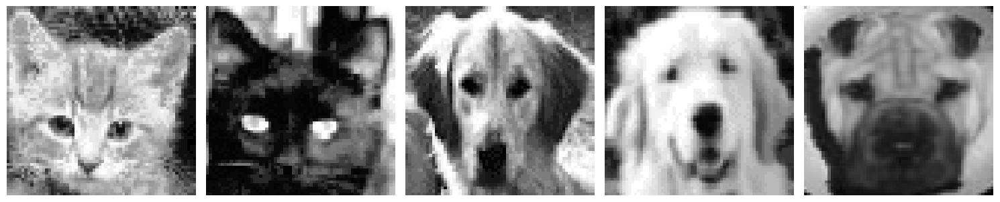


Images in Cluster 2:


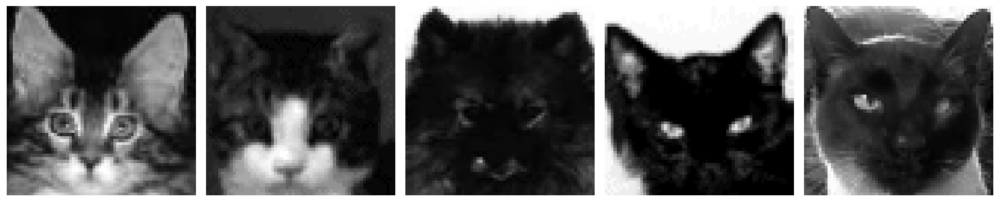

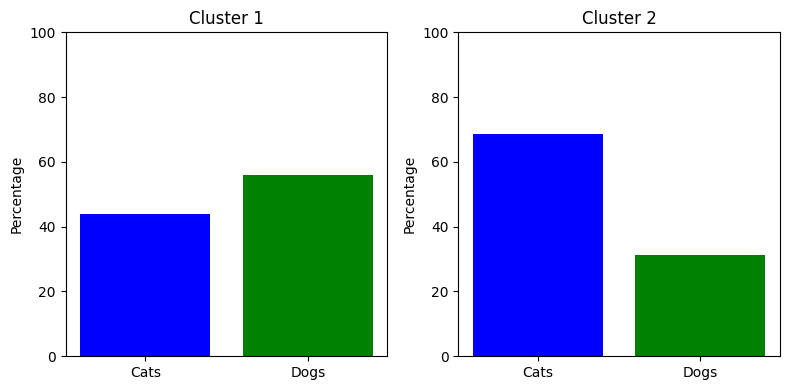


Hierarchical Clustering with 3 Clusters:
Silhouette Score: 0.077
Adjusted Rand Index (ARI): 0.099

Images in Cluster 1:


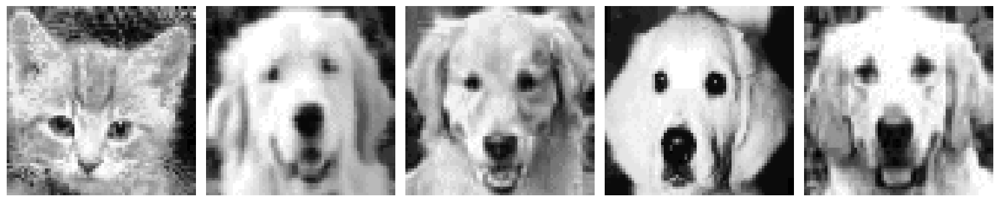


Images in Cluster 2:


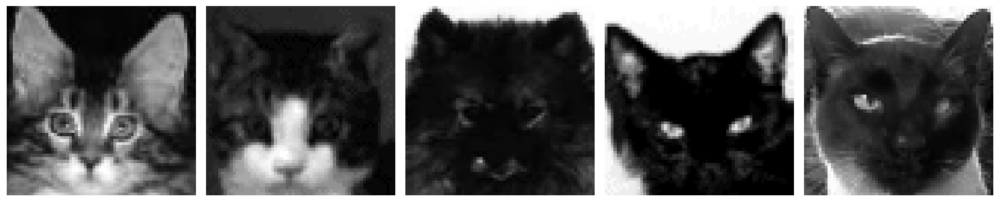


Images in Cluster 3:


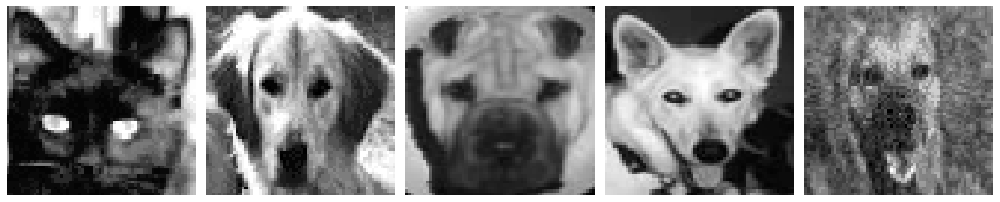

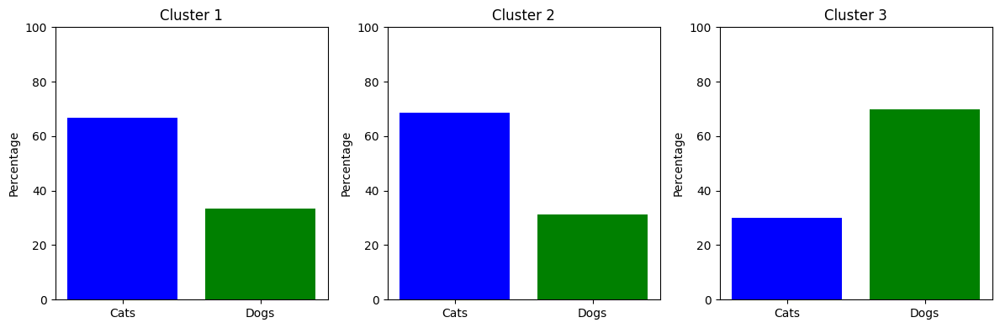


Hierarchical Clustering with 4 Clusters:
Silhouette Score: 0.065
Adjusted Rand Index (ARI): 0.111

Images in Cluster 1:


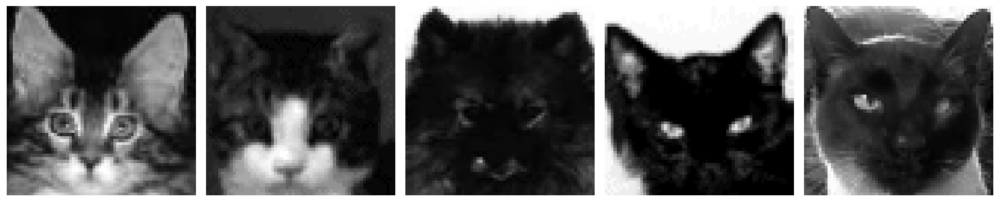


Images in Cluster 2:


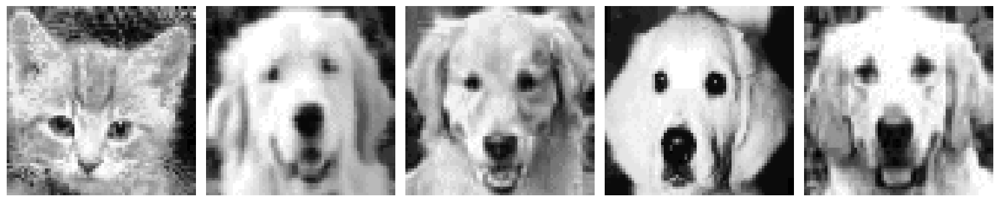


Images in Cluster 3:


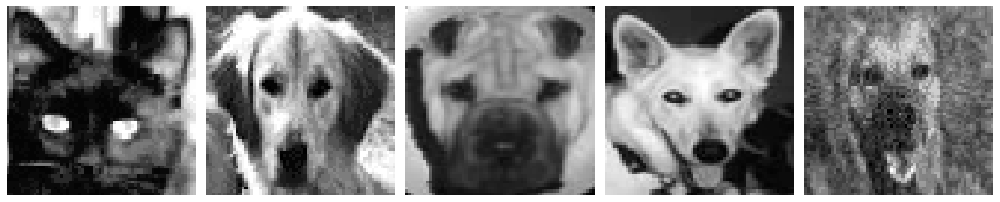


Images in Cluster 4:


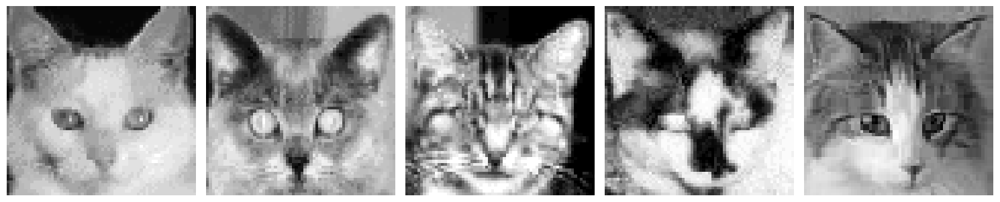

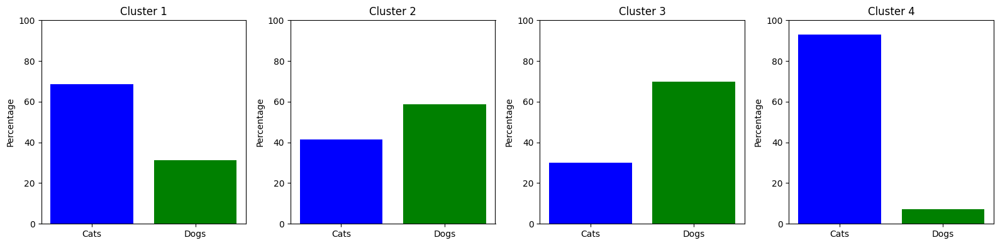


Hierarchical Clustering with 5 Clusters:
Silhouette Score: 0.069
Adjusted Rand Index (ARI): 0.102

Images in Cluster 1:


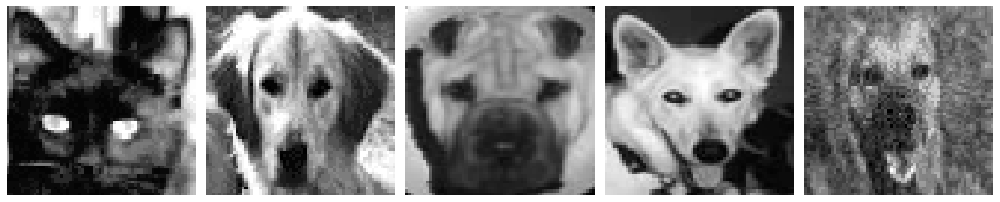


Images in Cluster 2:


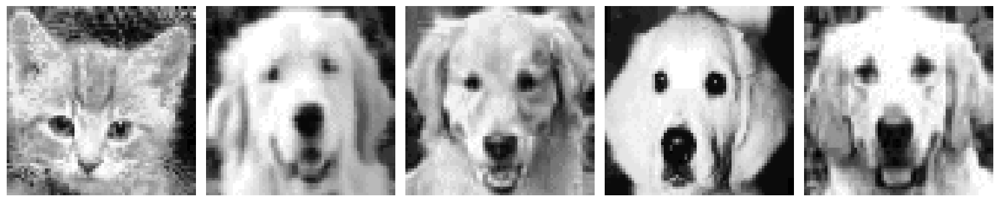


Images in Cluster 3:


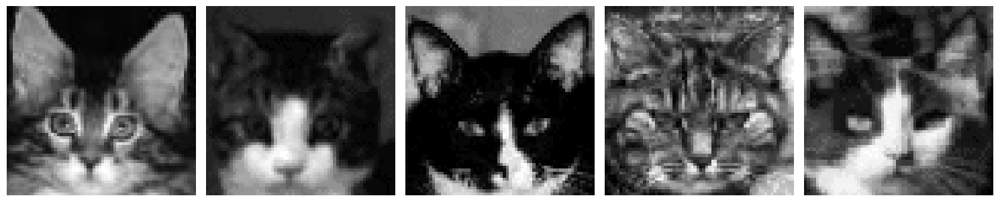


Images in Cluster 4:


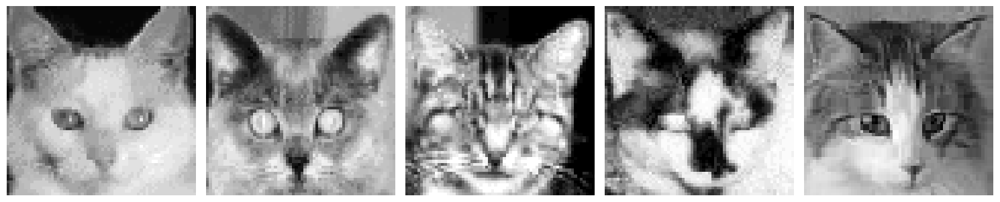


Images in Cluster 5:


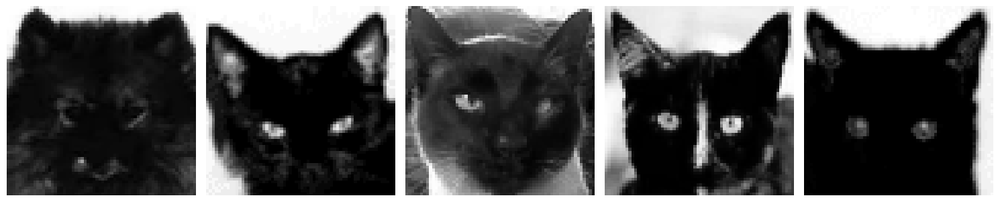

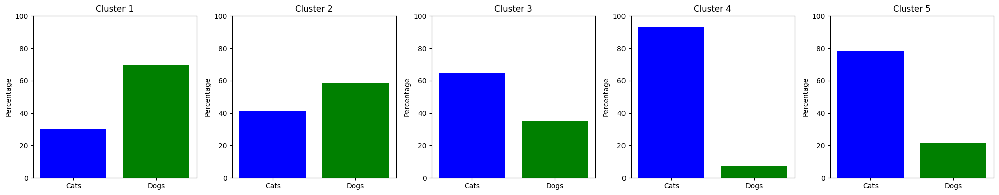


Hierarchical Clustering with 6 Clusters:
Silhouette Score: 0.072
Adjusted Rand Index (ARI): 0.094

Images in Cluster 1:


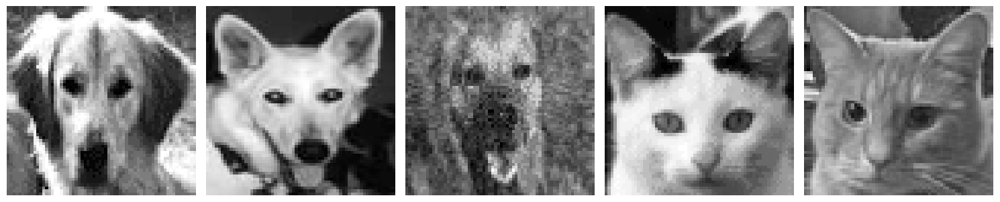


Images in Cluster 2:


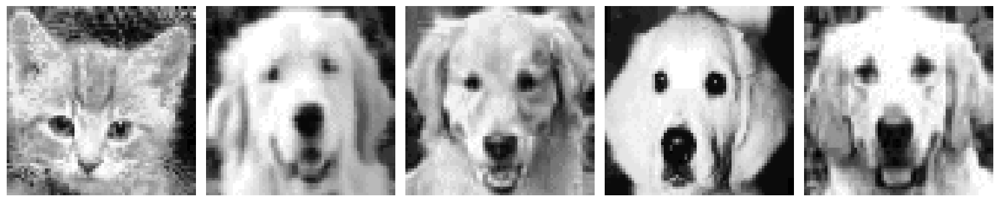


Images in Cluster 3:


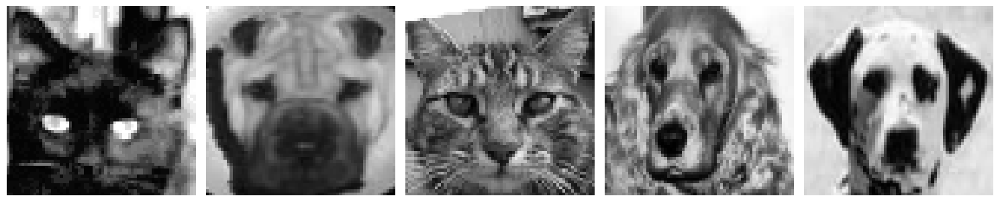


Images in Cluster 4:


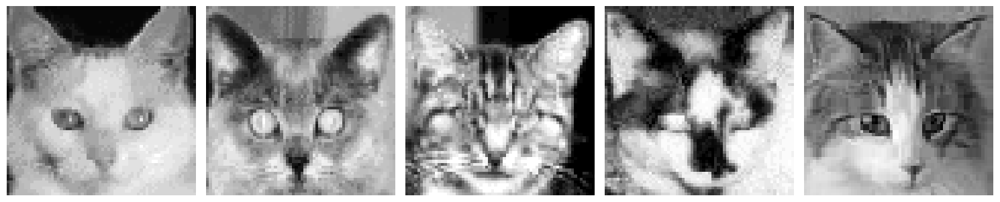


Images in Cluster 5:


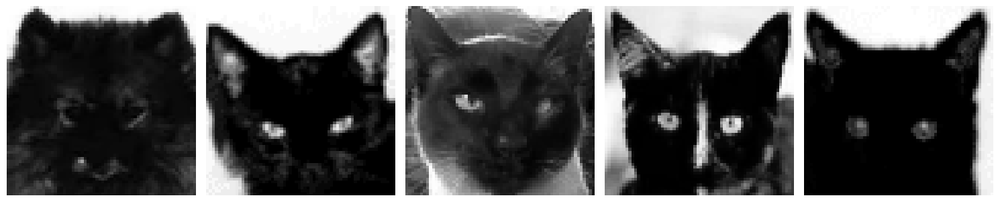


Images in Cluster 6:


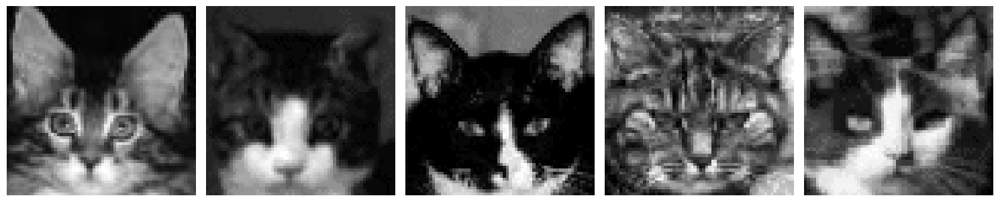

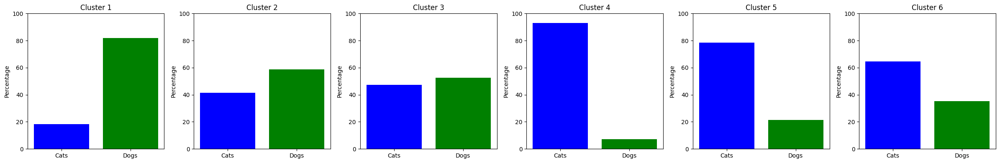


Hierarchical Clustering with 7 Clusters:
Silhouette Score: 0.071
Adjusted Rand Index (ARI): 0.063

Images in Cluster 1:


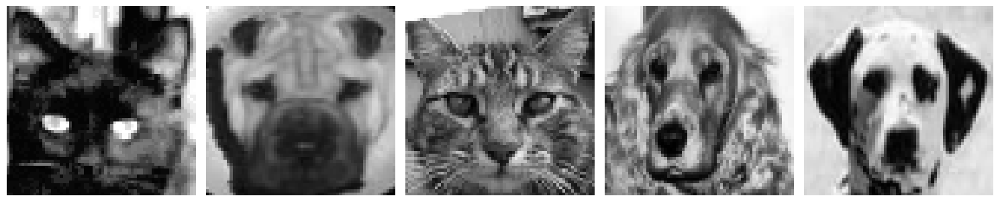


Images in Cluster 2:


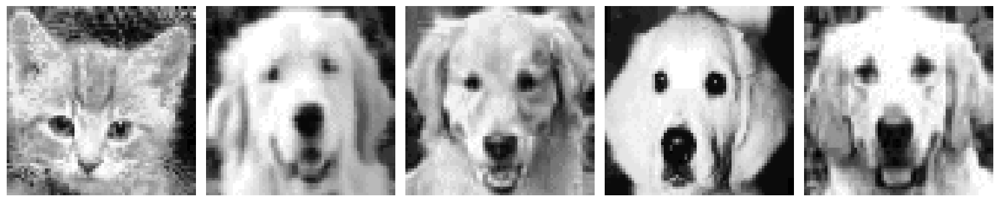


Images in Cluster 3:


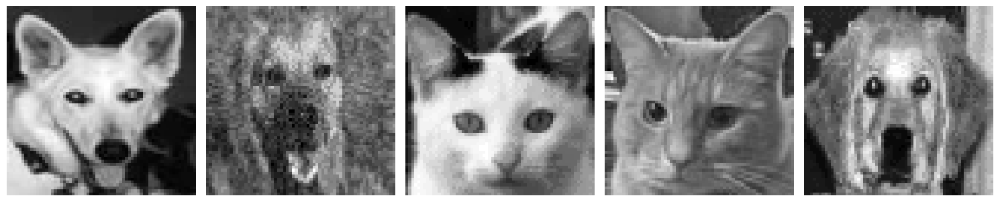


Images in Cluster 4:


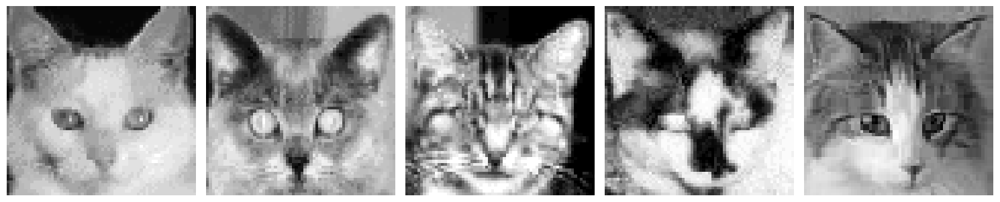


Images in Cluster 5:


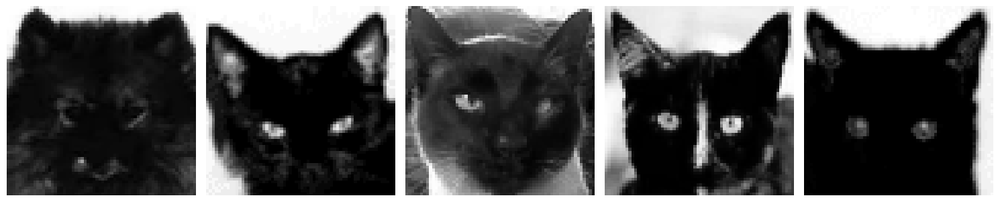


Images in Cluster 6:


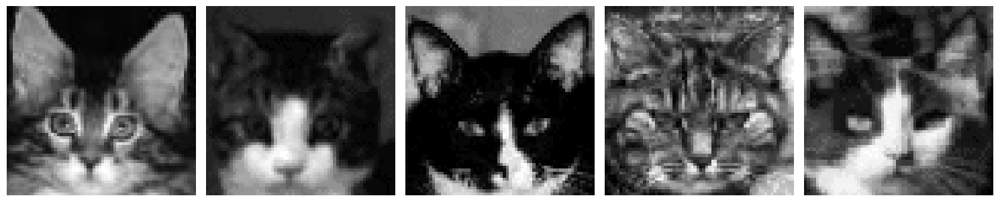


Images in Cluster 7:


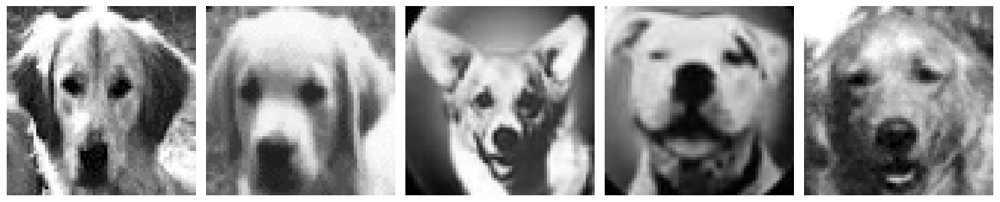

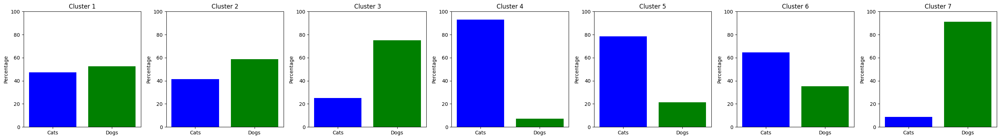


Hierarchical Clustering with 8 Clusters:
Silhouette Score: 0.073
Adjusted Rand Index (ARI): 0.063

Images in Cluster 1:


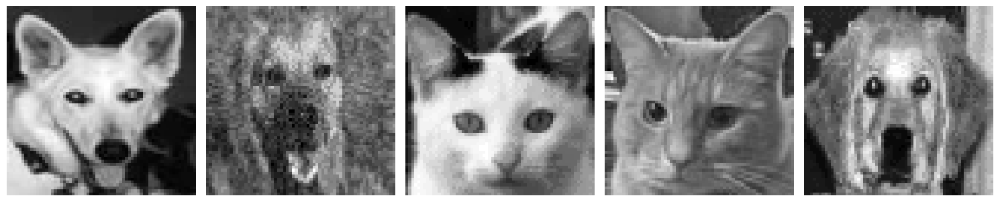


Images in Cluster 2:


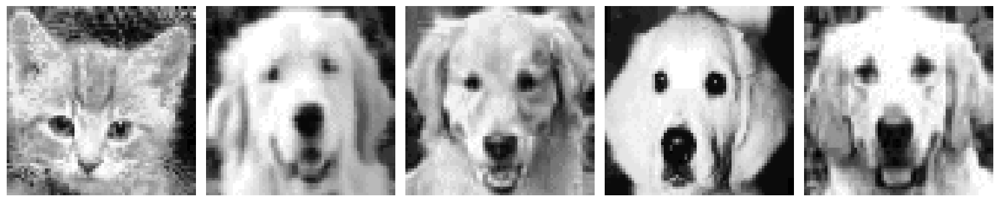


Images in Cluster 3:


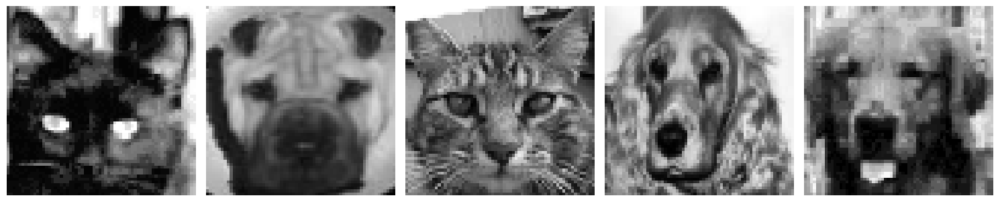


Images in Cluster 4:


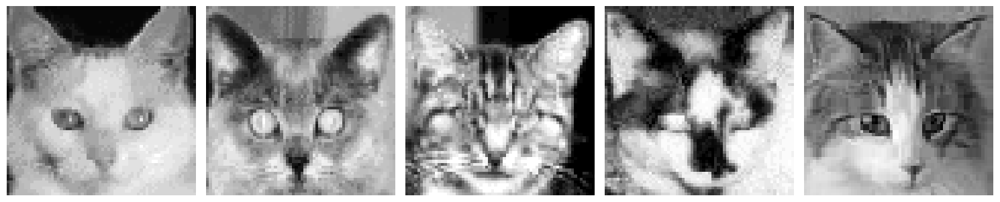


Images in Cluster 5:


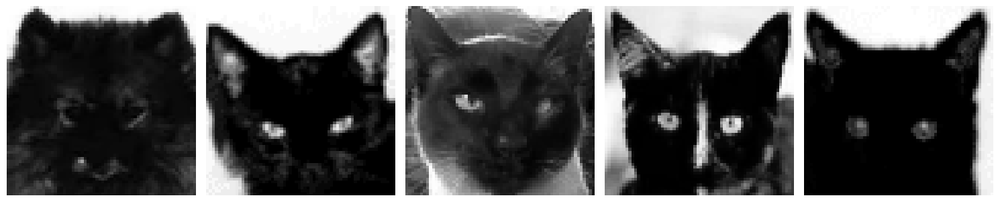


Images in Cluster 6:


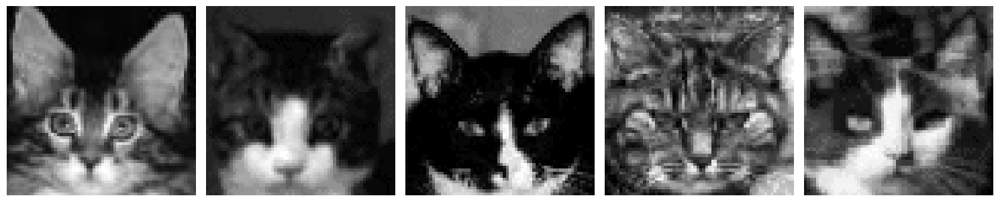


Images in Cluster 7:


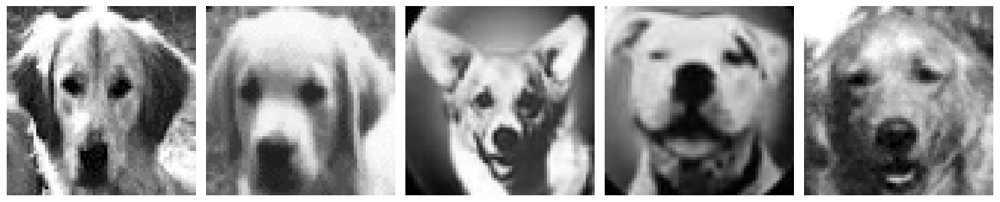


Images in Cluster 8:


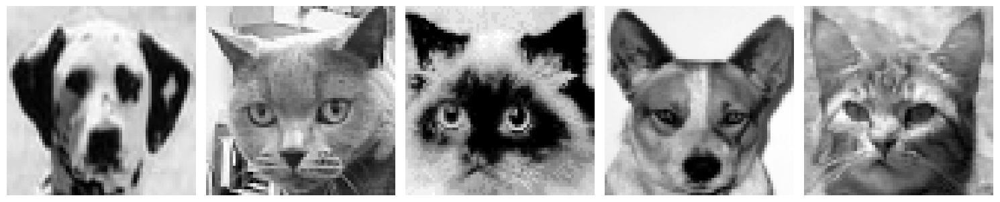

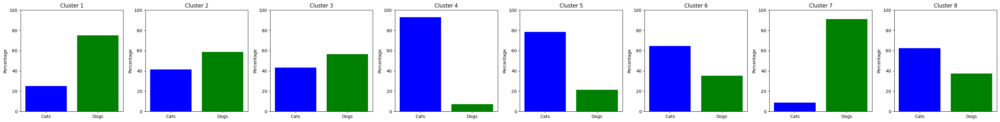

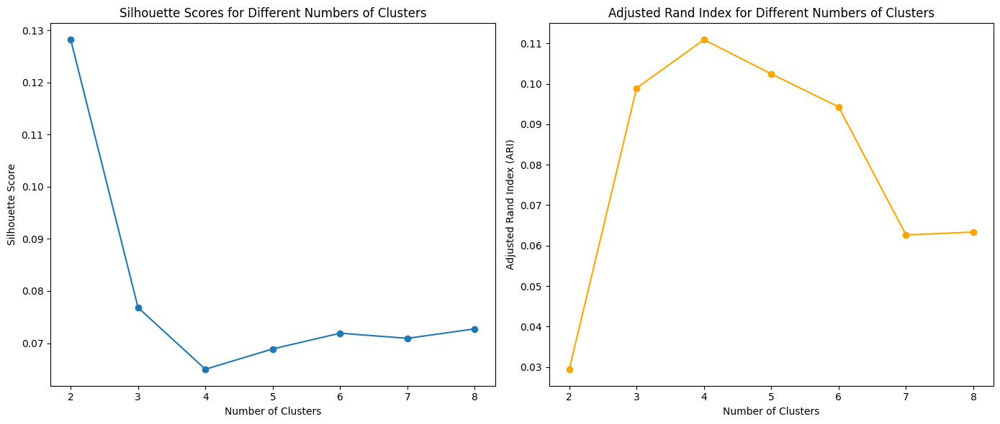

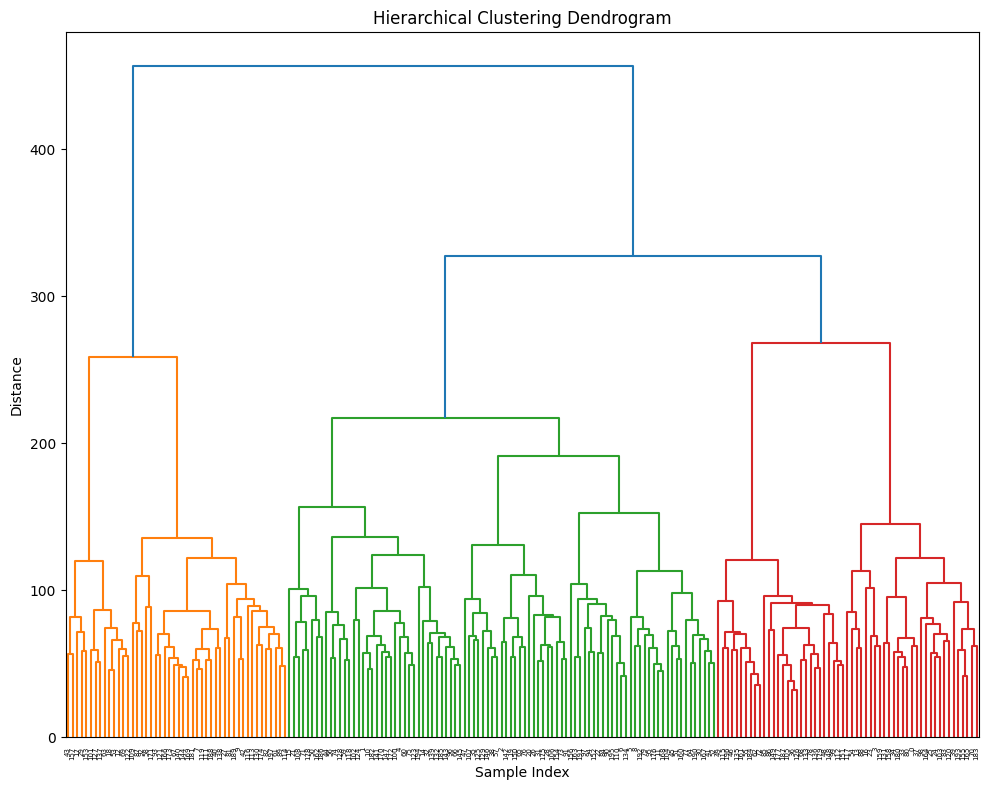

In [56]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Initialize lists to store metrics
ari_scores = []
silhouette_scores = []
cluster_range = (2, 9)
image_size = 64

for n_clusters in range(cluster_range[0], cluster_range[1]):
    hier_clust = AgglomerativeClustering(n_clusters=n_clusters)
    labels = hier_clust.fit_predict(X_scaled)

    # Assess Clustering
    silhouette_avg = silhouette_score(X_scaled, labels)
    ari = adjusted_rand_score(y, labels)

    silhouette_scores.append(silhouette_avg)
    ari_scores.append(ari)

    print(f"\nHierarchical Clustering with {n_clusters} Clusters:")
    print(f"Silhouette Score: {silhouette_avg:.3f}")
    print(f"Adjusted Rand Index (ARI): {ari:.3f}")

    # Show Clustered Images
    for cluster_id in range(n_clusters):
        print(f"\nImages in Cluster {cluster_id + 1}:")
        cluster_indices = np.where(labels == cluster_id)[0]
        fig, axs = plt.subplots(1, 5, figsize=(15, 4))  # Show 5 images per cluster
        for i, idx in enumerate(cluster_indices[:5]):  # Only show the first 5
            img = X.iloc[idx].values.reshape(image_size, image_size)  # Correct indexing with .iloc
            axs[i].imshow(img, cmap='gray')
            axs[i].axis('off')
        plt.tight_layout()
        plt.show()

    # Plot percentage of each class in each cluster
    fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters * 4, 4))
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(labels == cluster_id)[0]
        cats_in_cluster = np.sum(y[cluster_indices] == 0)
        dogs_in_cluster = np.sum(y[cluster_indices] == 1)
        total_in_cluster = len(cluster_indices)
        
        cats_percentage = (cats_in_cluster / total_in_cluster) * 100
        dogs_percentage = (dogs_in_cluster / total_in_cluster) * 100
        
        axs[cluster_id].bar(['Cats', 'Dogs'], [cats_percentage, dogs_percentage], color=['blue', 'green'])
        axs[cluster_id].set_title(f'Cluster {cluster_id + 1}')
        axs[cluster_id].set_ylim(0, 100)
        axs[cluster_id].set_ylabel('Percentage')
    
    plt.tight_layout()
    plt.show()

# Plot Silhouette Scores and ARI
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(range(cluster_range[0], cluster_range[1]), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')

plt.subplot(1, 2, 2)
plt.plot(range(cluster_range[0], cluster_range[1]), ari_scores, marker='o', color='orange')
plt.title('Adjusted Rand Index for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Adjusted Rand Index (ARI)')

plt.tight_layout()
plt.show()

# Dendrogram for hierarchical clustering
Z = linkage(X_scaled, 'ward')
plt.figure(figsize=(10, 8))
dendrogram(Z)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

### 4.2 Clustering on the Whole Dataset  (With Pre-Processing)

We use 3 clustering algorithms here: Gaussian Mixture, K-Means and Agglomerative, but prior to training the algorithms, we apply PCA

#### 4.2.1 Gaussian Mixture (After PCA)


Gaussian Mixture Model with 2 Clusters:
Silhouette Score: 0.050
Adjusted Rand Index (ARI): 0.231

Images in Cluster 1:


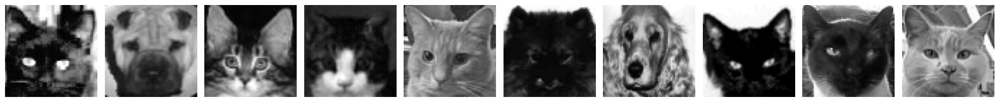


Images in Cluster 2:


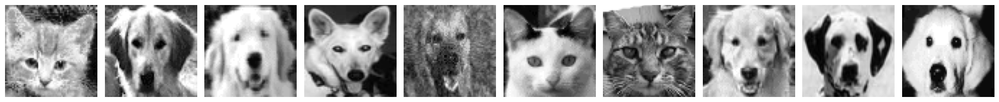

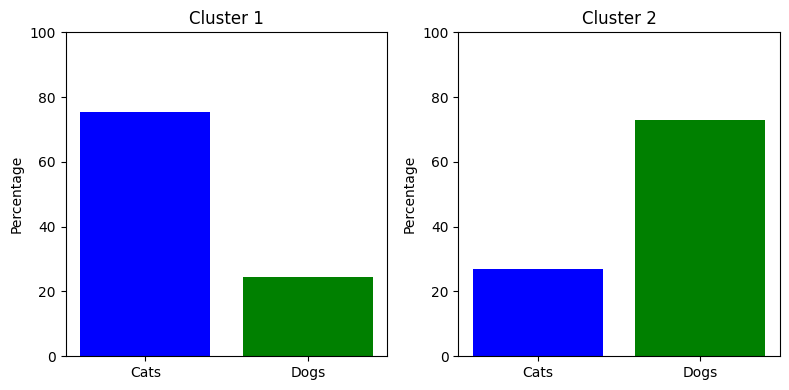


Gaussian Mixture Model with 3 Clusters:
Silhouette Score: 0.051
Adjusted Rand Index (ARI): 0.197

Images in Cluster 1:


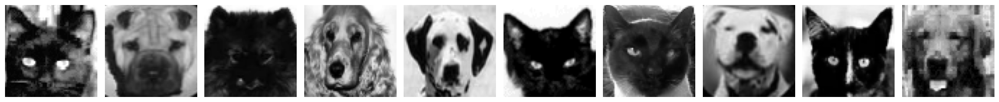


Images in Cluster 2:


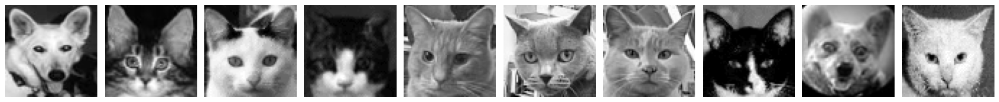


Images in Cluster 3:


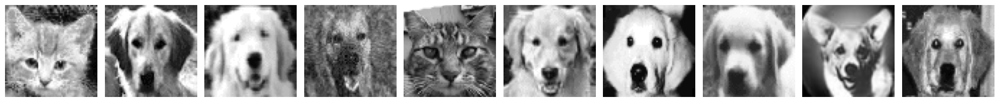

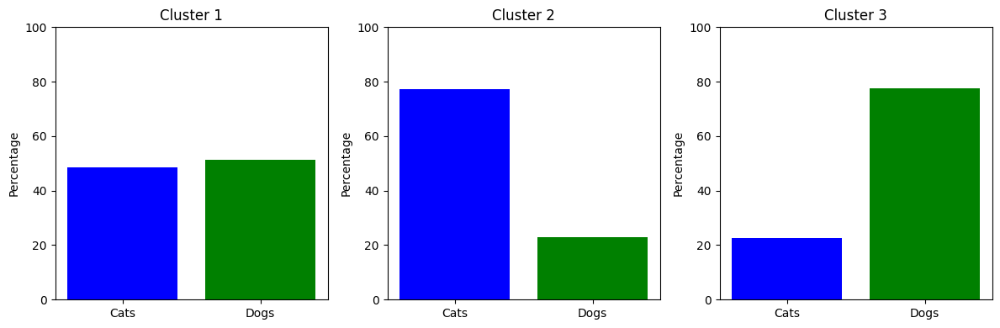


Gaussian Mixture Model with 4 Clusters:
Silhouette Score: 0.052
Adjusted Rand Index (ARI): 0.239

Images in Cluster 1:


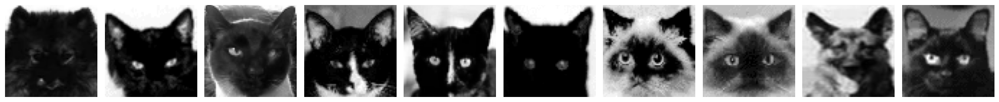


Images in Cluster 2:


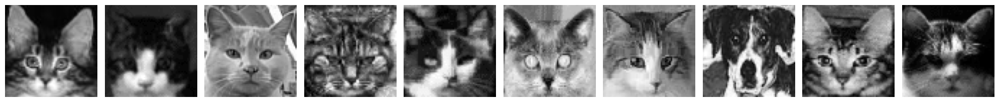


Images in Cluster 3:


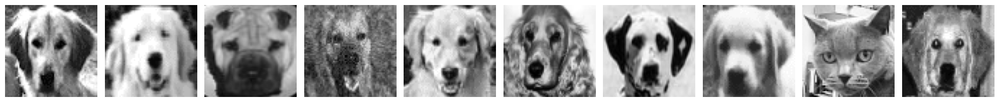


Images in Cluster 4:


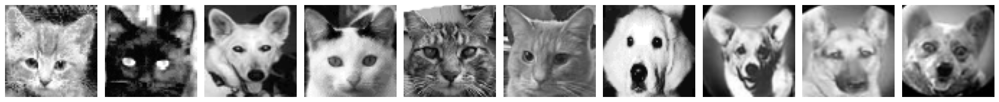

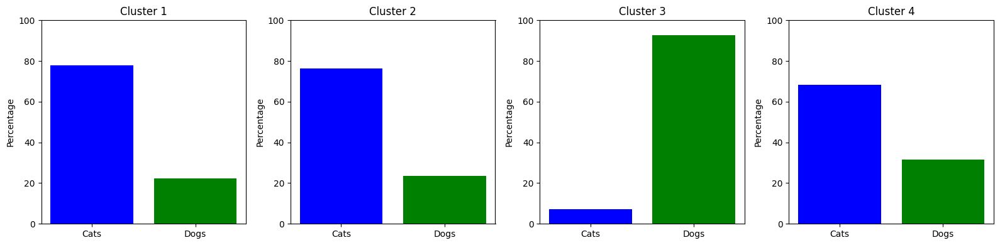


Gaussian Mixture Model with 5 Clusters:
Silhouette Score: 0.063
Adjusted Rand Index (ARI): 0.144

Images in Cluster 1:


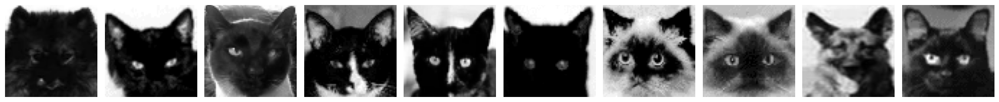


Images in Cluster 2:


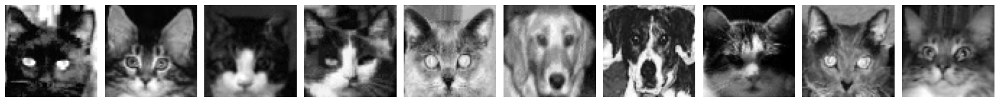


Images in Cluster 3:


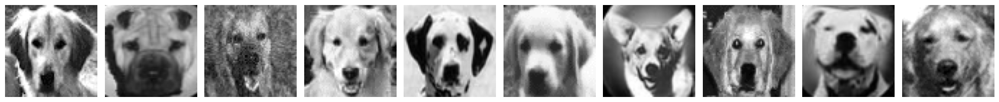


Images in Cluster 4:


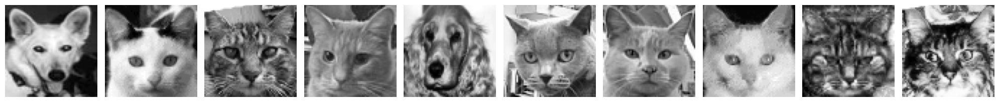


Images in Cluster 5:


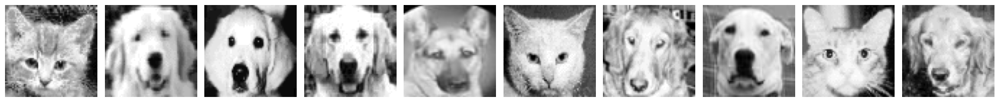

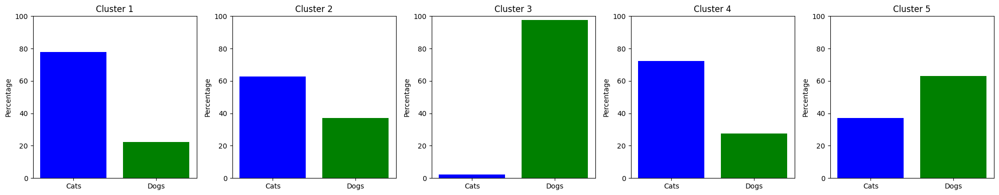


Gaussian Mixture Model with 6 Clusters:
Silhouette Score: 0.084
Adjusted Rand Index (ARI): 0.124

Images in Cluster 1:


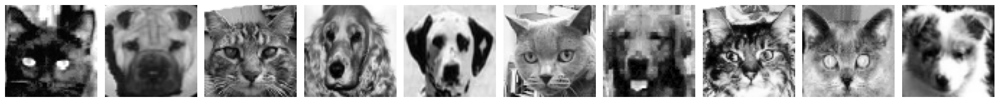


Images in Cluster 2:


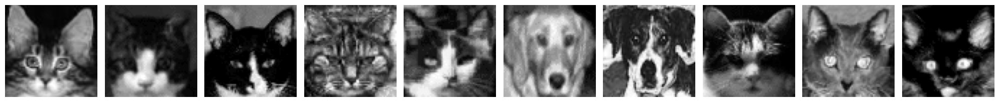


Images in Cluster 3:


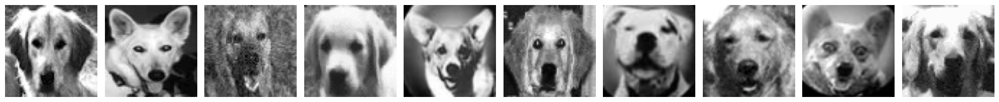


Images in Cluster 4:


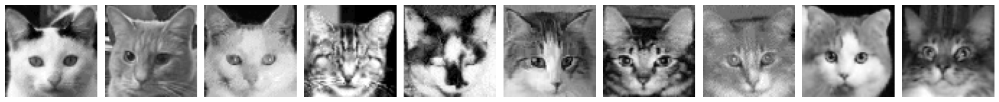


Images in Cluster 5:


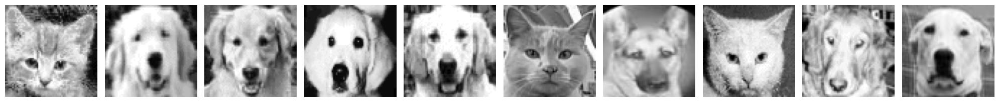


Images in Cluster 6:


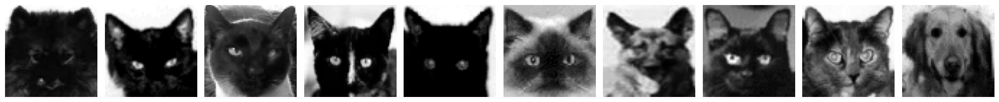

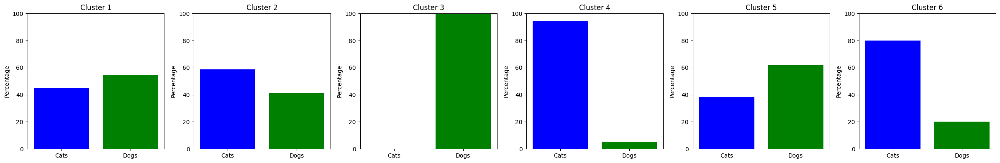


Gaussian Mixture Model with 7 Clusters:
Silhouette Score: 0.077
Adjusted Rand Index (ARI): 0.124

Images in Cluster 1:


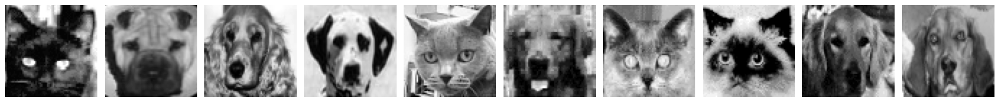


Images in Cluster 2:


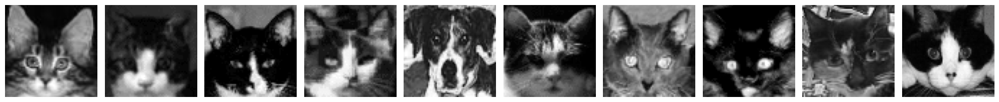


Images in Cluster 3:


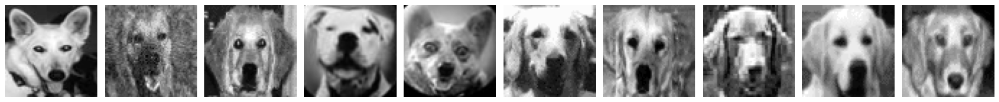


Images in Cluster 4:


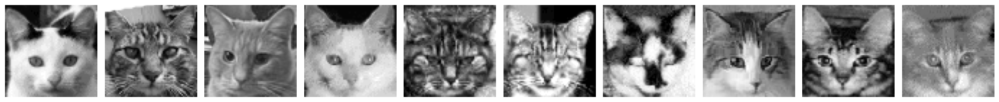


Images in Cluster 5:


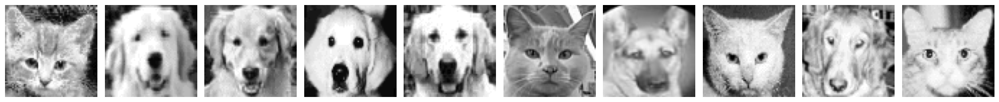


Images in Cluster 6:


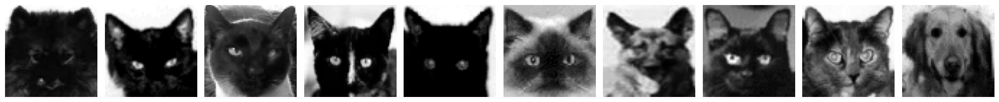


Images in Cluster 7:


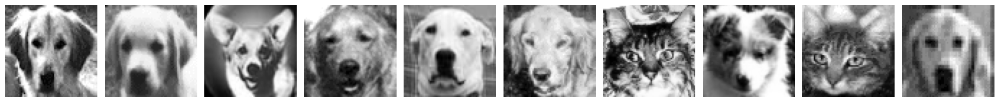

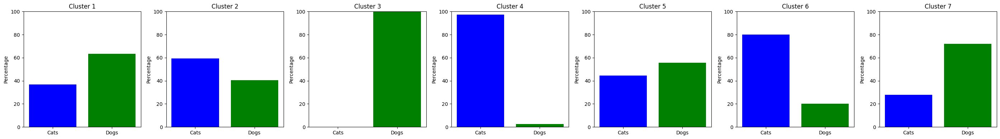


Gaussian Mixture Model with 8 Clusters:
Silhouette Score: 0.078
Adjusted Rand Index (ARI): 0.122

Images in Cluster 1:


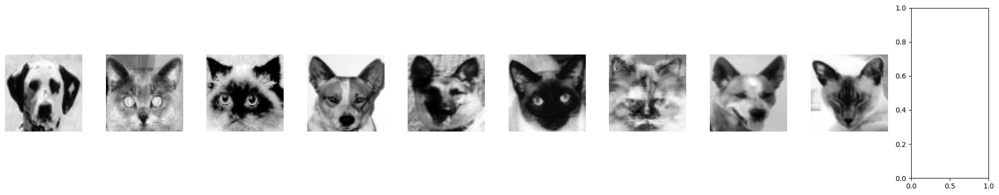


Images in Cluster 2:


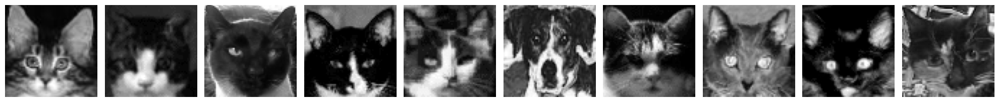


Images in Cluster 3:


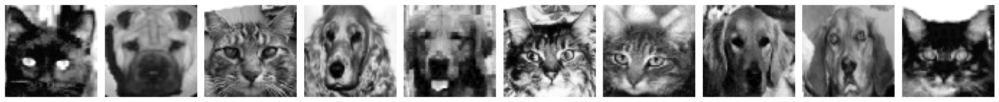


Images in Cluster 4:


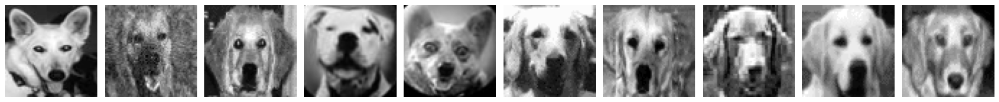


Images in Cluster 5:


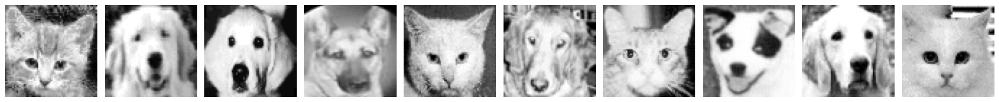


Images in Cluster 6:


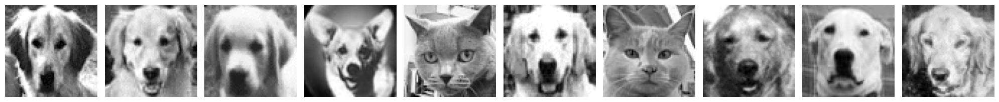


Images in Cluster 7:


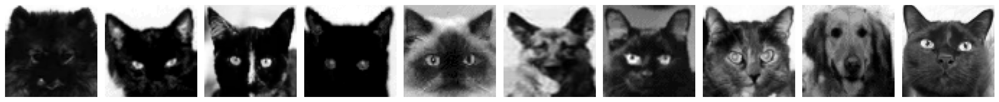


Images in Cluster 8:


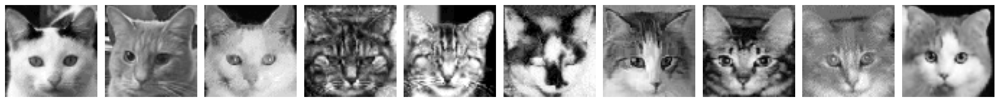

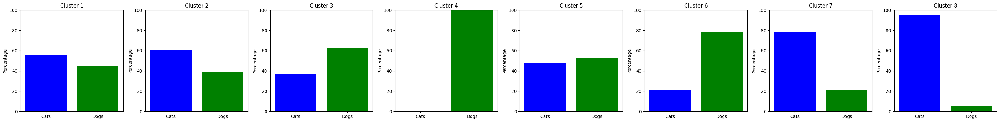

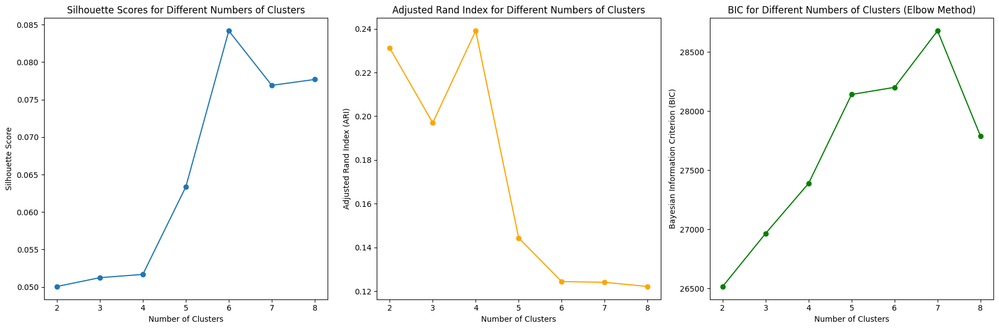

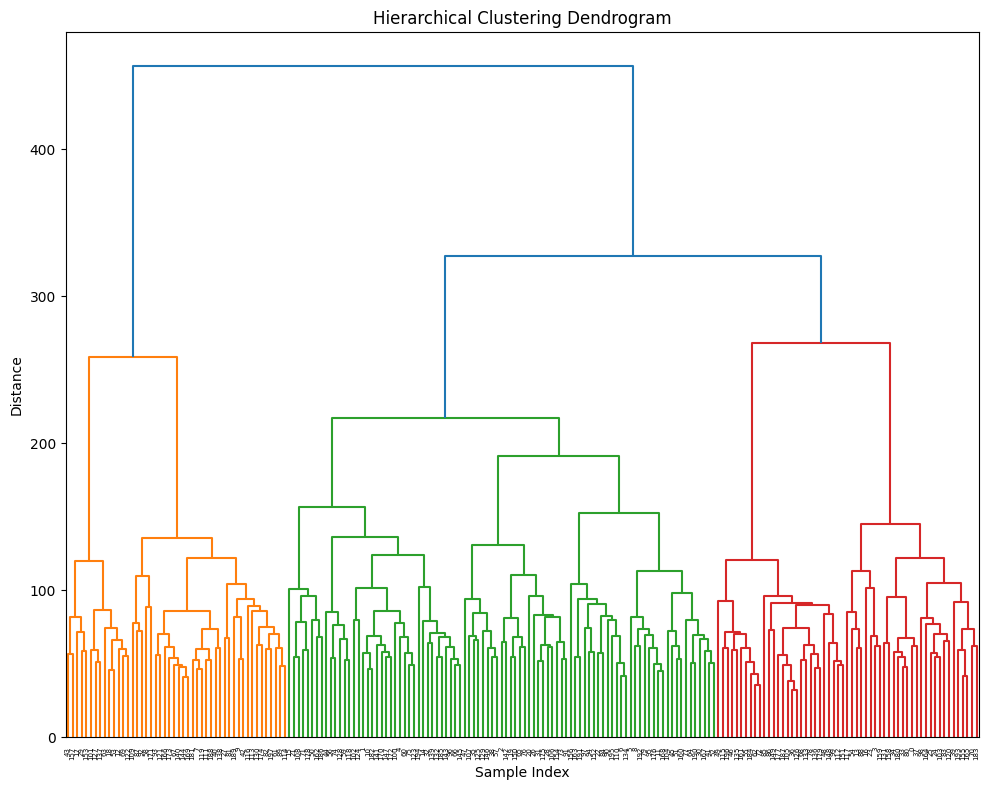

In [58]:
from sklearn.decomposition import PCA

# Apply PCA for dimensionality reduction
pca = PCA(n_components=17)
X_pca = pca.fit_transform(X_scaled)

ari_scores = []
silhouette_scores = []
bic_scores = []  # For elbow method plot
cluster_range = (2, 9)
image_size = 64

for n_clusters in range(cluster_range[0], cluster_range[1]):
    gmm = GaussianMixture(n_components=n_clusters, random_state=42)
    labels = gmm.fit_predict(X_pca)
    
    # Assess Clustering
    silhouette_avg = silhouette_score(X_scaled, labels)
    ari = adjusted_rand_score(y, labels)
    bic = gmm.bic(X_pca)  # Bayesian Information Criterion (BIC) for elbow method

    silhouette_scores.append(silhouette_avg)
    ari_scores.append(ari)
    bic_scores.append(bic)

    print(f"\nGaussian Mixture Model with {n_clusters} Clusters:")
    print(f"Silhouette Score: {silhouette_avg:.3f}")
    print(f"Adjusted Rand Index (ARI): {ari:.3f}")

    # Show Clustered Images
    for cluster_id in range(n_clusters):
        print(f"\nImages in Cluster {cluster_id + 1}:")
        cluster_indices = np.where(labels == cluster_id)[0]
        fig, axs = plt.subplots(1, 10, figsize=(20, 4))  # Show 10 images per cluster
        for i, idx in enumerate(cluster_indices[:10]):  # Only show the first 10
            img = X.iloc[idx].values.reshape(image_size, image_size)  # Correct indexing with .iloc
            axs[i].imshow(img, cmap='gray')
            axs[i].axis('off')
        plt.tight_layout()
        plt.show()

    # Plot percentage of each class in each cluster
    fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters * 4, 4))
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(labels == cluster_id)[0]
        cats_in_cluster = np.sum(y[cluster_indices] == 0)
        dogs_in_cluster = np.sum(y[cluster_indices] == 1)
        total_in_cluster = len(cluster_indices)
        
        cats_percentage = (cats_in_cluster / total_in_cluster) * 100
        dogs_percentage = (dogs_in_cluster / total_in_cluster) * 100
        
        axs[cluster_id].bar(['Cats', 'Dogs'], [cats_percentage, dogs_percentage], color=['blue', 'green'])
        axs[cluster_id].set_title(f'Cluster {cluster_id + 1}')
        axs[cluster_id].set_ylim(0, 100)
        axs[cluster_id].set_ylabel('Percentage')
    
    plt.tight_layout()
    plt.show()

# Plot Silhouette Scores, ARI, and BIC for elbow method
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.plot(range(cluster_range[0], cluster_range[1]), silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')

plt.subplot(1, 3, 2)
plt.plot(range(cluster_range[0], cluster_range[1]), ari_scores, marker='o', color='orange')
plt.title('Adjusted Rand Index for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Adjusted Rand Index (ARI)')

plt.subplot(1, 3, 3)
plt.plot(range(cluster_range[0], cluster_range[1]), bic_scores, marker='o', color='green')
plt.title('BIC for Different Numbers of Clusters (Elbow Method)')
plt.xlabel('Number of Clusters')
plt.ylabel('Bayesian Information Criterion (BIC)')

plt.tight_layout()
plt.show()

# Dendrogram for hierarchical clustering
Z = linkage(X_scaled, 'ward')
plt.figure(figsize=(10, 8))
dendrogram(Z)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

#### 4.2.2 Gaussian Mixture on Varying PCA

PCA components: 5, ARI: 0.219
PCA components: 6, ARI: 0.105
PCA components: 7, ARI: 0.146
PCA components: 8, ARI: 0.207
PCA components: 9, ARI: 0.117
PCA components: 10, ARI: 0.186
PCA components: 11, ARI: 0.165
PCA components: 12, ARI: 0.172
PCA components: 13, ARI: 0.357
PCA components: 14, ARI: 0.133
PCA components: 15, ARI: 0.163
PCA components: 16, ARI: 0.207
PCA components: 17, ARI: 0.197
PCA components: 18, ARI: 0.101
PCA components: 19, ARI: 0.067
PCA components: 20, ARI: 0.004
PCA components: 21, ARI: 0.005
PCA components: 22, ARI: 0.002
PCA components: 23, ARI: 0.009
PCA components: 24, ARI: 0.007
PCA components: 25, ARI: 0.005
PCA components: 26, ARI: 0.078
PCA components: 27, ARI: 0.009
PCA components: 28, ARI: 0.008
PCA components: 29, ARI: 0.005
PCA components: 30, ARI: 0.012
PCA components: 31, ARI: 0.011
PCA components: 32, ARI: 0.011
PCA components: 33, ARI: 0.009
PCA components: 34, ARI: 0.008
PCA components: 35, ARI: 0.008
PCA components: 36, ARI: 0.011
PCA component

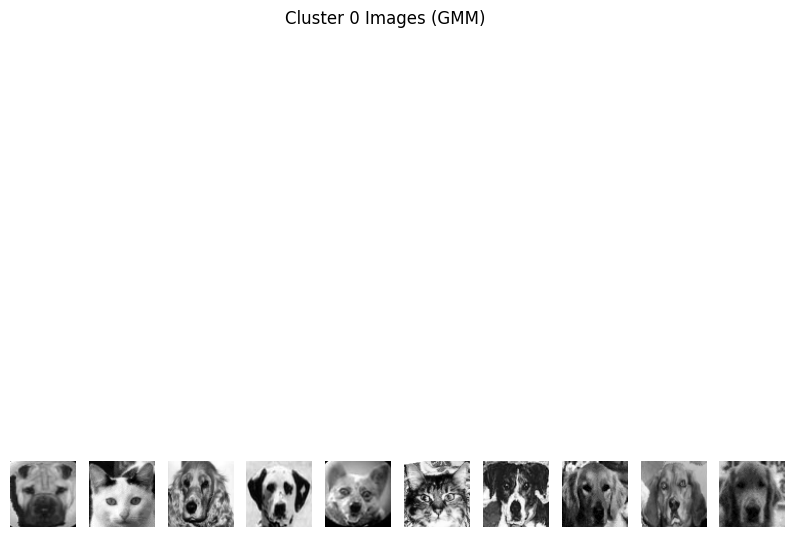

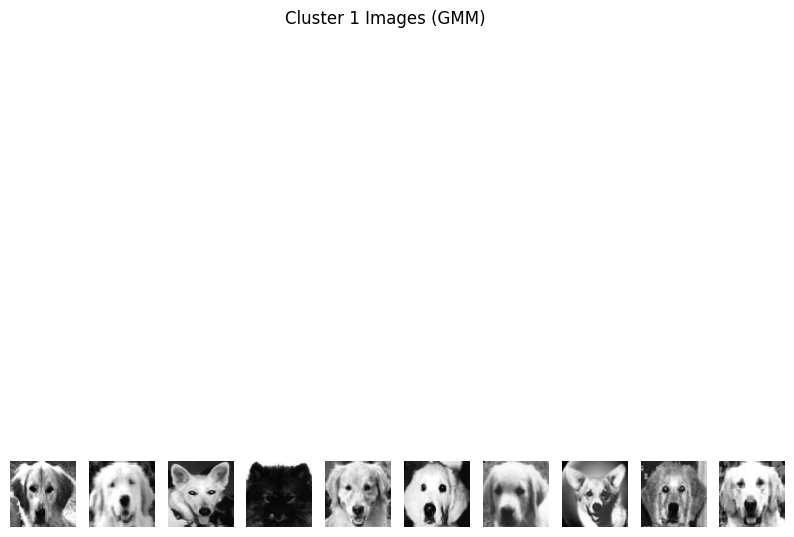

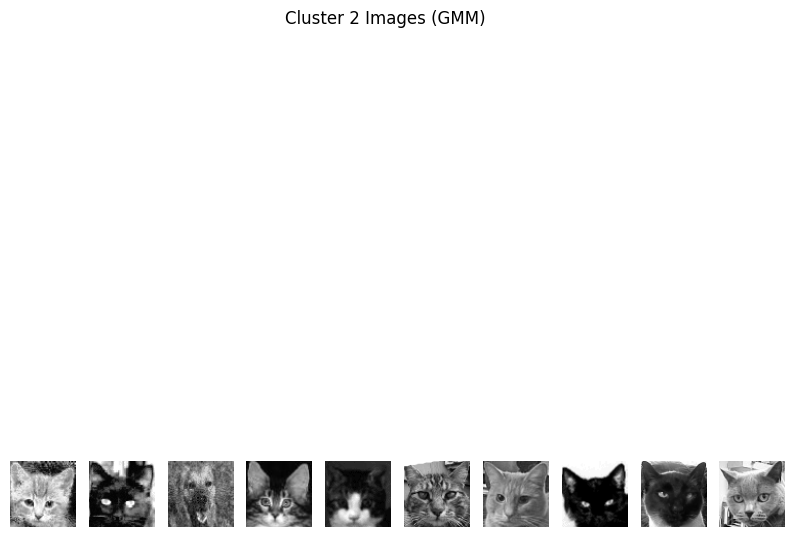

Confusion Matrix:
 [[16  9 74]
 [17 68 14]
 [ 0  0  0]]
Cluster 0 counts: [16 17]
Cluster 1 counts: [ 9 68]
Cluster 2 counts: [74 14]


In [69]:

# Define the range for PCA components
pca_component_range = range(5, 51, 1)  # Example range, adjust as needed

# Initialize variables to store the best results
best_n_components = None
best_ari = -1
best_gmm = None
best_pca = None
best_clusters = None

# Grid search for the optimal number of PCA components
for n_components in pca_component_range:
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X_scaled)
    
    gmm = GaussianMixture(n_components=3, random_state=42)
    clusters_gmm = gmm.fit_predict(X_pca)
    
    ari = adjusted_rand_score(y, clusters_gmm)
    
    if ari > best_ari:
        best_ari = ari
        best_n_components = n_components
        best_gmm = gmm
        best_pca = pca
        best_clusters = clusters_gmm

    print(f"PCA components: {n_components}, ARI: {ari:.3f}")

# Output the best result
print(f"\nBest number of PCA components: {best_n_components}, Best ARI: {best_ari:.3f}")

# Apply the best PCA and GMM models
X_pca_best = best_pca.transform(X_scaled)
clusters_gmm_best = best_gmm.predict(X_pca_best)

# Define a function to plot images
def plot_clustered_images(data, clusters, cluster_id, title, num_images=10):
    plt.figure(figsize=(10, 10))
    cluster_data = data[clusters == cluster_id]
    for i in range(num_images):
        plt.subplot(1, num_images, i+1)
        image = cluster_data.iloc[i].values.reshape(64, 64)  # Correct indexing with .iloc
        plt.imshow(image, cmap='gray')
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

# Visualize the clustered images
plot_clustered_images(X, clusters_gmm_best, cluster_id=0, title='Cluster 0 Images (GMM)')
plot_clustered_images(X, clusters_gmm_best, cluster_id=1, title='Cluster 1 Images (GMM)')
plot_clustered_images(X, clusters_gmm_best, cluster_id=2, title='Cluster 2 Images (GMM)')

# Confusion matrix
conf_matrix = confusion_matrix(y, clusters_gmm_best)
print("Confusion Matrix:\n", conf_matrix)

# Calculate the number of samples from each class in each cluster
for cluster_id in range(3):
    cluster_counts = np.bincount(y[clusters_gmm_best == cluster_id], minlength=2)
    print(f"Cluster {cluster_id} counts: {cluster_counts}")

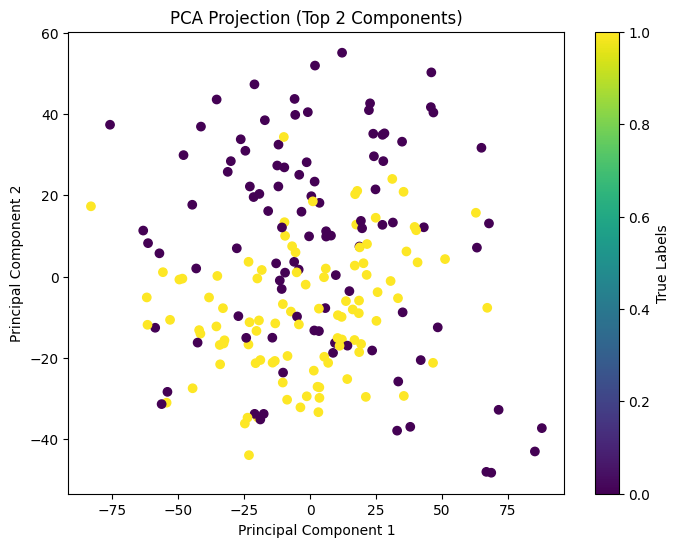

In [61]:
# Perform PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Plot the top 2 principal components and color by true labels
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA Projection (Top 2 Components)')
plt.colorbar(label='True Labels')
plt.show()

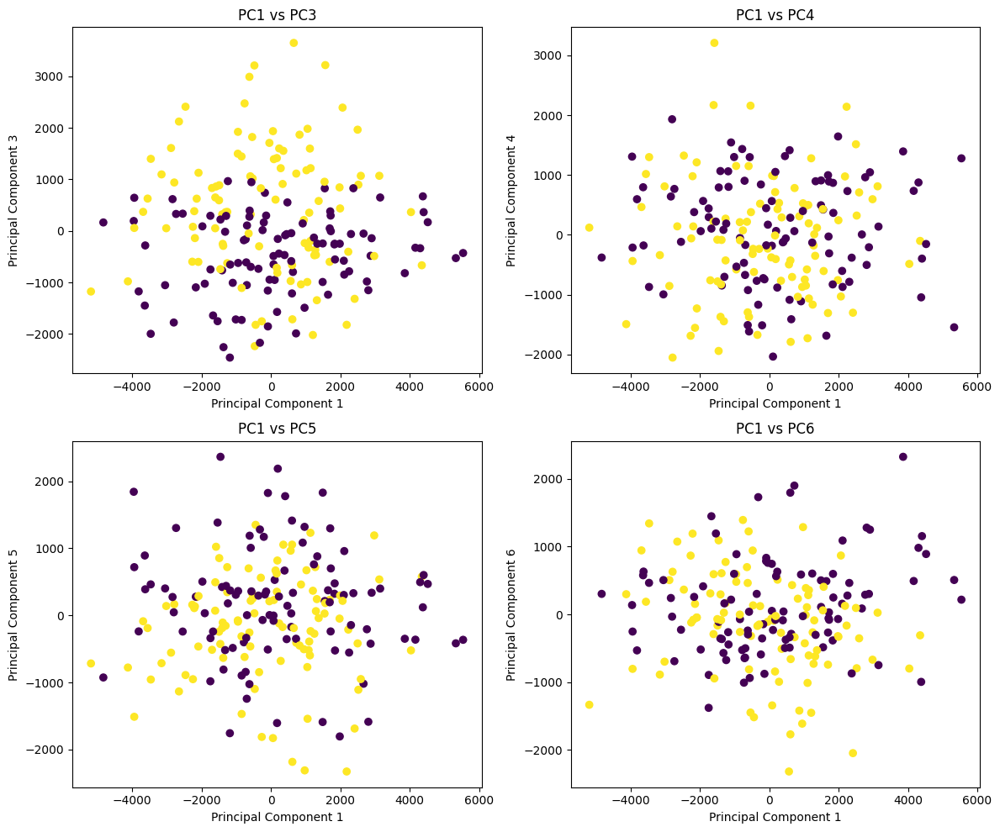

In [62]:
# Perform PCA
pca = PCA(n_components=10)  # Get the first 10 principal components
X_pca = pca.fit_transform(X)

# Plot the first principal component against the 3rd, 4th, and so on
num_plots = 4
fig, axs = plt.subplots(2, 2, figsize=(12, 10))
axs = axs.ravel()

for i in range(num_plots):
    ax = axs[i]
    ax.scatter(X_pca[:, 0], X_pca[:, i + 2], c=y, cmap='viridis')
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel(f'Principal Component {i + 3}')
    ax.set_title(f'PC1 vs PC{i + 3}')

fig.tight_layout()
plt.show()

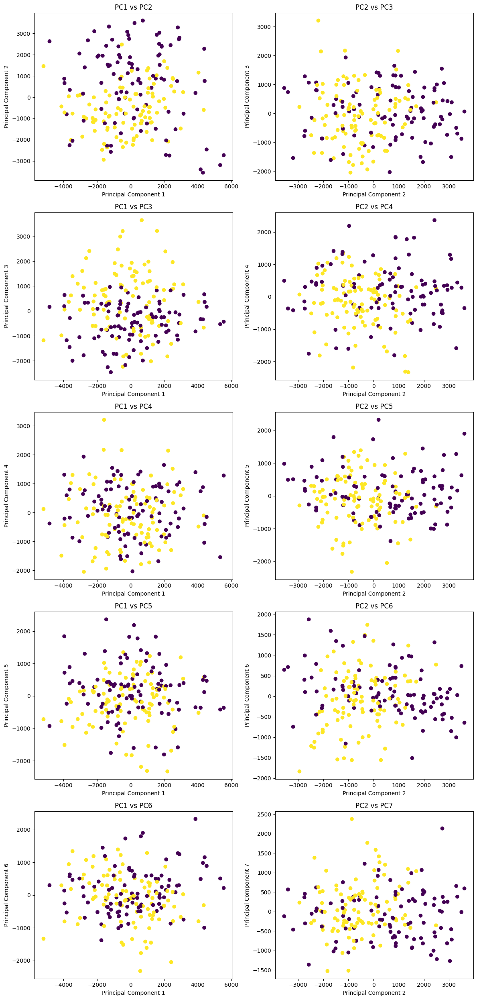

In [63]:
num_plots = 10  # or any other number you desire
num_rows = (num_plots - 1) // 2 + 1  # Calculate the number of rows for subplots

fig, axs = plt.subplots(num_rows, 2, figsize=(12, 5*num_rows))
axs = axs.ravel()

for i in range(num_plots):
    ax = axs[i]
    if i % 2 == 0:
        ax.scatter(X_pca[:, 0], X_pca[:, i // 2 + 1], c=y, cmap='viridis')
        ax.set_xlabel('Principal Component 1')
        ax.set_ylabel(f'Principal Component {i // 2 + 2}')
        ax.set_title(f'PC1 vs PC{i // 2 + 2}')
    else:
        ax.scatter(X_pca[:, 1], X_pca[:, (i - 1) // 2 + 3], c=y, cmap='viridis')
        ax.set_xlabel('Principal Component 2')
        ax.set_ylabel(f'Principal Component {(i - 1) // 2 + 3}')
        ax.set_title(f'PC2 vs PC{(i - 1) // 2 + 3}')

fig.tight_layout()
plt.show()

### 4.3 Illustrating Scores

PCA components: 5, ARI (GMM): 0.176, ARI (K-means): -0.005, ARI (HC): 0.003
PCA components: 6, ARI (GMM): 0.231, ARI (K-means): -0.005, ARI (HC): 0.000
PCA components: 7, ARI (GMM): 0.272, ARI (K-means): -0.005, ARI (HC): 0.009
PCA components: 8, ARI (GMM): 0.203, ARI (K-means): -0.005, ARI (HC): 0.033
PCA components: 9, ARI (GMM): 0.317, ARI (K-means): -0.005, ARI (HC): 0.050
PCA components: 10, ARI (GMM): 0.317, ARI (K-means): -0.005, ARI (HC): 0.000
PCA components: 11, ARI (GMM): 0.364, ARI (K-means): -0.005, ARI (HC): 0.041
PCA components: 12, ARI (GMM): 0.402, ARI (K-means): -0.005, ARI (HC): -0.002
PCA components: 13, ARI (GMM): 0.340, ARI (K-means): -0.005, ARI (HC): 0.017
PCA components: 14, ARI (GMM): 0.389, ARI (K-means): -0.005, ARI (HC): 0.046
PCA components: 15, ARI (GMM): 0.389, ARI (K-means): -0.005, ARI (HC): 0.041
PCA components: 16, ARI (GMM): 0.328, ARI (K-means): -0.005, ARI (HC): 0.045
PCA components: 17, ARI (GMM): 0.221, ARI (K-means): -0.005, ARI (HC): 0.006
PCA

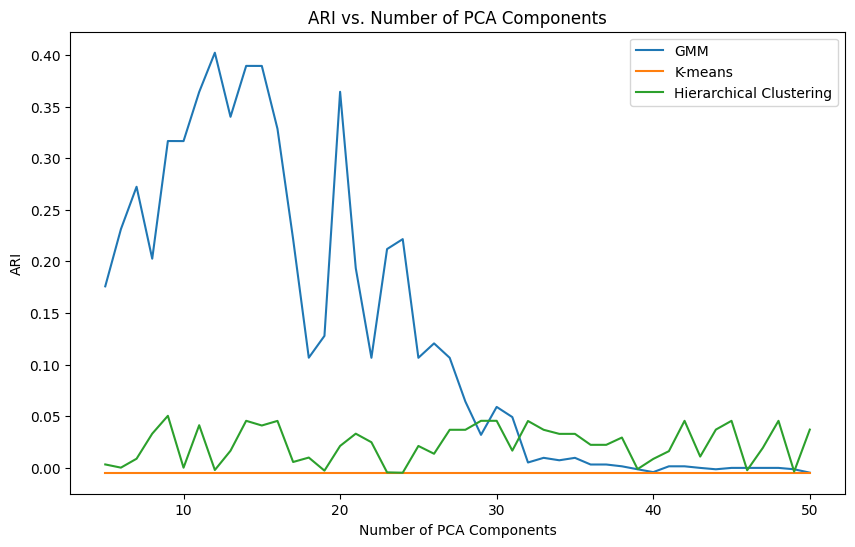


Best number of PCA components (GMM): 12, Best ARI: 0.402
Best number of PCA components (K-means): 5, Best ARI: -0.005
Best number of PCA components (Hierarchical Clustering): 9, Best ARI: 0.050


In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, adjusted_rand_score, confusion_matrix

# Define the range for PCA components
pca_component_range = range(5, 51, 1)  # Example range, adjust as needed

# Initialize variables to store the best results
best_n_components_gmm = None
best_ari_gmm = -1
best_gmm = None
best_pca_gmm = None
best_clusters_gmm = None

best_n_components_kmeans = None
best_ari_kmeans = -1
best_kmeans = None
best_pca_kmeans = None
best_clusters_kmeans = None

best_n_components_hc = None
best_ari_hc = -1
best_hc = None
best_pca_hc = None
best_clusters_hc = None

# Initialize lists to store ARI values and corresponding number of PCA components
ari_values_gmm = []
ari_values_kmeans = []
ari_values_hc = []
pca_components = []

# Grid search for the optimal number of PCA components
for n_components in pca_component_range:
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X_scaled)

    # GMM
    gmm = GaussianMixture(n_components=2, random_state=42)
    clusters_gmm = gmm.fit_predict(X_pca)
    ari_gmm = adjusted_rand_score(y, clusters_gmm)
    ari_values_gmm.append(ari_gmm)

    if ari_gmm > best_ari_gmm:
        best_ari_gmm = ari_gmm
        best_n_components_gmm = n_components
        best_gmm = gmm
        best_pca_gmm = pca
        best_clusters_gmm = clusters_gmm

    # K-means
    kmeans = KMeans(n_clusters=2, random_state=42)
    clusters_kmeans = kmeans.fit_predict(X_pca)
    ari_kmeans = adjusted_rand_score(y, clusters_kmeans)
    ari_values_kmeans.append(ari_kmeans)

    if ari_kmeans > best_ari_kmeans:
        best_ari_kmeans = ari_kmeans
        best_n_components_kmeans = n_components
        best_kmeans = kmeans
        best_pca_kmeans = pca
        best_clusters_kmeans = clusters_kmeans

    # Hierarchical Clustering
    hc = AgglomerativeClustering(n_clusters=2)
    clusters_hc = hc.fit_predict(X_pca)
    ari_hc = adjusted_rand_score(y, clusters_hc)
    ari_values_hc.append(ari_hc)

    if ari_hc > best_ari_hc:
        best_ari_hc = ari_hc
        best_n_components_hc = n_components
        best_hc = hc
        best_pca_hc = pca
        best_clusters_hc = clusters_hc

    pca_components.append(n_components)
    print(f"PCA components: {n_components}, ARI (GMM): {ari_gmm:.3f}, ARI (K-means): {ari_kmeans:.3f}, ARI (HC): {ari_hc:.3f}")

# Plot ARI vs. number of PCA components
plt.figure(figsize=(10, 6))
plt.plot(pca_components, ari_values_gmm, label='GMM')
plt.plot(pca_components, ari_values_kmeans, label='K-means')
plt.plot(pca_components, ari_values_hc, label='Hierarchical Clustering')
plt.xlabel('Number of PCA Components')
plt.ylabel('ARI')
plt.title('ARI vs. Number of PCA Components')
plt.legend()
plt.show()

# Output the best results
print(f"\nBest number of PCA components (GMM): {best_n_components_gmm}, Best ARI: {best_ari_gmm:.3f}")
print(f"Best number of PCA components (K-means): {best_n_components_kmeans}, Best ARI: {best_ari_kmeans:.3f}")
print(f"Best number of PCA components (Hierarchical Clustering): {best_n_components_hc}, Best ARI: {best_ari_hc:.3f}")

# Apply the best PCA and clustering models
X_pca_best_gmm = best_pca_gmm.transform(X_scaled)
clusters_gmm_best = best_gmm.predict(X_pca_best_gmm)

X_pca_best_kmeans = best_pca_kmeans.transform(X_scaled)
clusters_kmeans_best = best_kmeans.predict(X_pca_best_kmeans)

X_pca_best_hc = best_pca_hc.transform(X_scaled)
clusters_hc_best = best_hc.fit_predict(X_pca_best_hc)

#### 4.3.1 Silhouette Score visualization

In [76]:
# Apply PCA
pca = PCA(n_components=0.90, random_state=42)
X_pca = pca.fit_transform(X_scaled)

# Explained variance
explained_variance = np.sum(pca.explained_variance_ratio_)
print(f"Explained variance by PCA: {explained_variance:.2f}")

# Number of components
n_components = pca.n_components_
print(f"Number of PCA components: {n_components}")

# Apply clustering algorithms
clustering_algorithms = {
    'K-Means': KMeans(n_clusters=2, random_state=42),
    'Agglomerative': AgglomerativeClustering(n_clusters=2),
    'GMM': GaussianMixture(n_components=2, random_state=42)
}

Explained variance by PCA: 0.90
Number of PCA components: 57


In [77]:
# Function to plot clusters
def plot_clusters(data, labels, title):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=data[:, 0], y=data[:, 1], hue=labels, palette='viridis')
    plt.title(title)
    plt.show()

# Function to evaluate clustering
def evaluate_clustering(true_labels, predicted_labels):
    ari = adjusted_rand_score(true_labels, predicted_labels)
    nmi = normalized_mutual_info_score(true_labels, predicted_labels)
    return ari, nmi

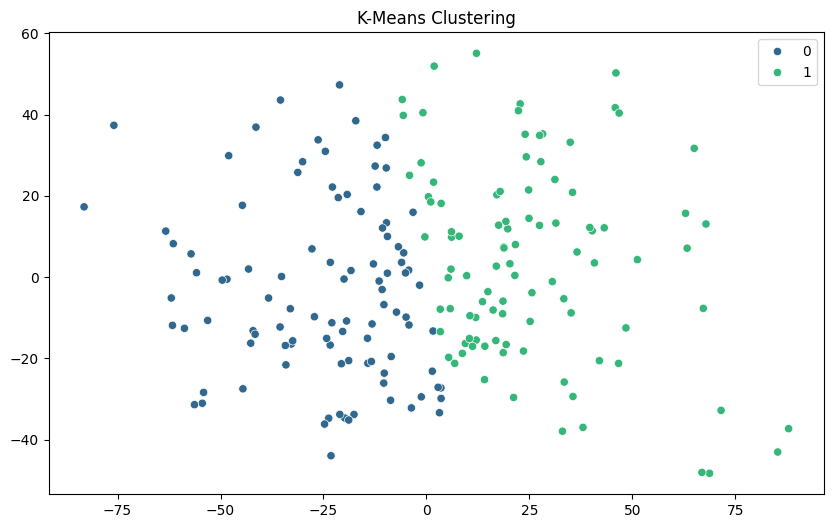

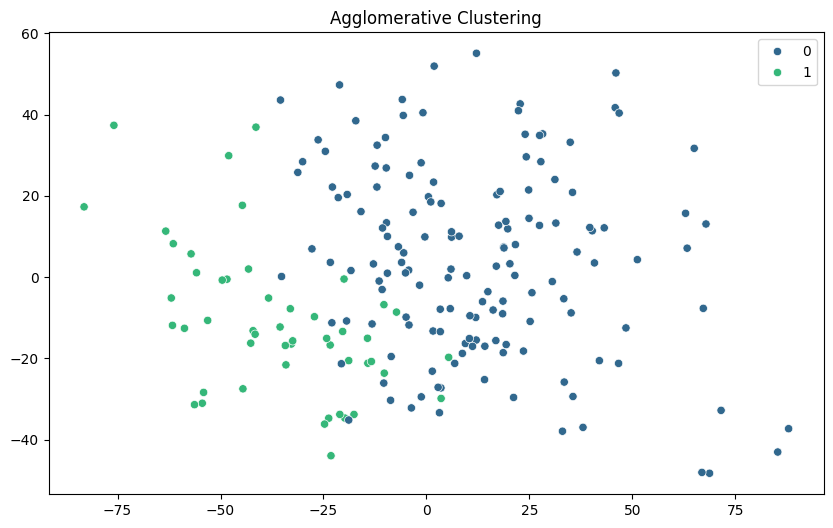

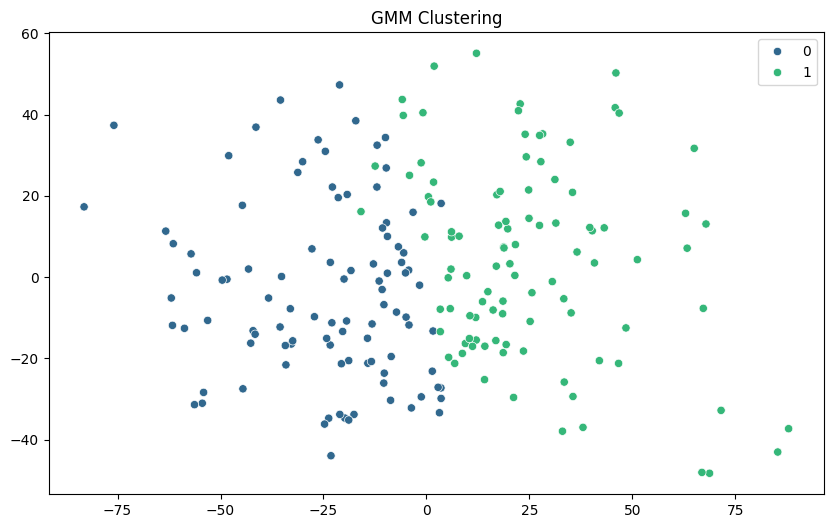

K-Means Clustering: ARI = 0.01, NMI = 0.01
Agglomerative Clustering: ARI = 0.02, NMI = 0.02
GMM Clustering: ARI = 0.01, NMI = 0.01


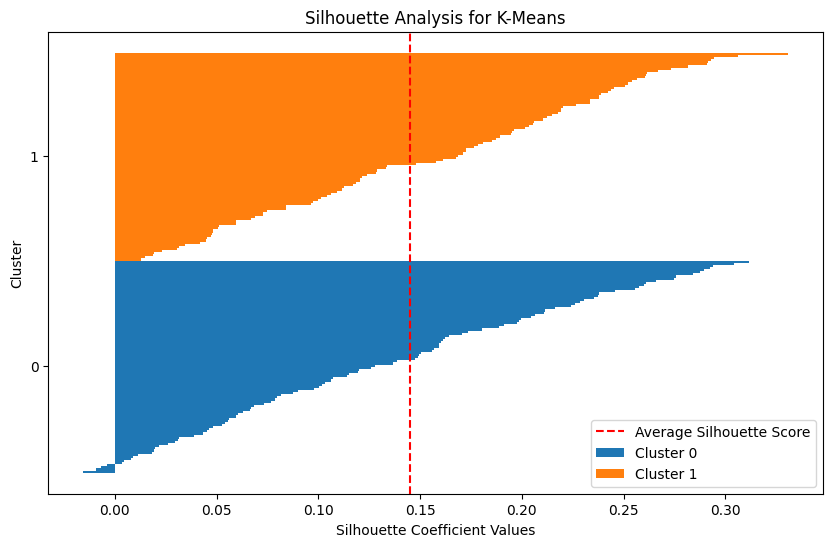

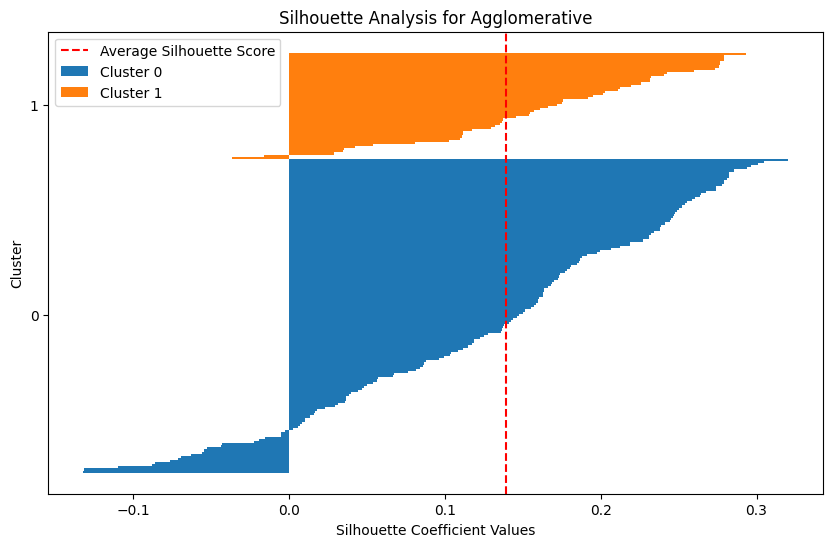

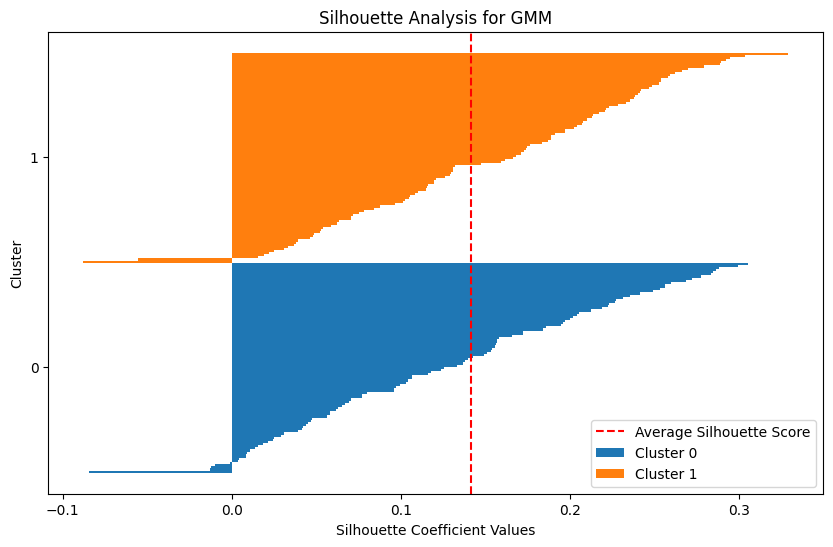

In [78]:
# Apply and evaluate each algorithm
results = {}
for name, algorithm in clustering_algorithms.items():
    if name == 'GMM':
        labels = algorithm.fit_predict(X_pca)
    else:
        labels = algorithm.fit(X_pca).labels_
    ari, nmi = evaluate_clustering(y, labels)
    results[name] = (labels, ari, nmi)
    plot_clusters(X_pca, labels, f"{name} Clustering")

# Display results
for name, (labels, ari, nmi) in results.items():
    print(f"{name} Clustering: ARI = {ari:.2f}, NMI = {nmi:.2f}")

# Function to plot silhouette analysis
def plot_silhouette_analysis(data, labels, title):
    unique_labels = np.unique(labels)
    if len(unique_labels) < 2:
        print(f"Silhouette analysis not possible for {title} with less than 2 clusters.")
        return

    silhouette_vals = silhouette_samples(data, labels)
    avg_silhouette = silhouette_score(data, labels)
    
    plt.figure(figsize=(10, 6))
    y_lower, y_upper = 0, 0
    yticks = []
    
    for i, cluster in enumerate(unique_labels):
        cluster_silhouette_vals = silhouette_vals[labels == cluster]
        cluster_silhouette_vals.sort()
        y_upper += len(cluster_silhouette_vals)
        plt.barh(range(y_lower, y_upper), cluster_silhouette_vals, edgecolor='none', height=1, label=f'Cluster {cluster}')
        yticks.append((y_lower + y_upper) / 2)
        y_lower += len(cluster_silhouette_vals)
    
    plt.axvline(avg_silhouette, color='red', linestyle='--', label='Average Silhouette Score')
    plt.xlabel('Silhouette Coefficient Values')
    plt.ylabel('Cluster')
    plt.yticks(yticks, unique_labels)
    plt.legend(loc='best')
    plt.title(title)
    plt.show()

# Plot silhouette analysis for all clustering algorithms
for name, (labels, ari, nmi) in results.items():
    plot_silhouette_analysis(X_pca, labels, f'Silhouette Analysis for {name}')

### 4.4 Answering Questions

#### 4.4.1 Do the clusters agree with the class labels?

K-Means Clustering and hierarchical Clustering: 

* The K-Means algorithm struggles to separate the clusters into distinct categories of cats and dogs. By looking at the percentage of each class within each cluster, we can see that both clusters contain almost an equal split of cat and dog images, around 50% of each. In contrast, Hierarchical Clustering performs slightly better, especially in the cluster where there is a clear majority of cat images.


Gaussian Mixture Models (GMM):
* When running GMM on the entire dataset, the separation of class labels (cats and dogs) is poor. Although there is a slight majority of one class label in each cluster, the overall separation is still poor. However, when running GMM on a small number of PCA components (between 10 and 20), the results are much better. In this case, we can observe a clear dominance of one class in each cluster, especially the cluster containing mostly dog images.

#### 4.4.2 Does changing the number of clusters have an impact on the overlap with the class labels?

As we increase the number of clusters, we notice that certain clusters become dominated by a single class (either cats or dogs). However, there are still some clusters that struggle to separate the two classes effectively.

#### 4.4.3 What characteristics of the data does the clustering pick up?


The clustering algorithms seem to consider color patterns. For example, white cats and dogs are grouped together in one cluster, and black cats & dogs are grouped together in the other cluster. As we increase the number of clusters, we get clusters that contain different types/breeds of dogs and cats with the same color.

#### 4.4.4 do you perform preprocessing to the clustering algorithm? what method and settings? Is it as clear cut how to make these choices if you didn't know the labels?


We perform pre-processing for the clustering algorithm. We scale the data and experiment with Principal Component Analysis (PCA). We found that PCA works effectively only with the Gaussian Mixture Model (GMM) algorithm, as validated by the Adjusted Rand Index (ARI) score. PCA focuses on linear feature combinations to optimize variance, assuming that the data is distributed in a multivariate Gaussian fashion. This is consistent with the assumption made by GMM that the data is produced by a mixture of Gaussians.

Without knowing the labels we would not be able to determine the best PCAs as the silhouette score did not yield good results which could be that the data is not well separated. 